### Data Exploration

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

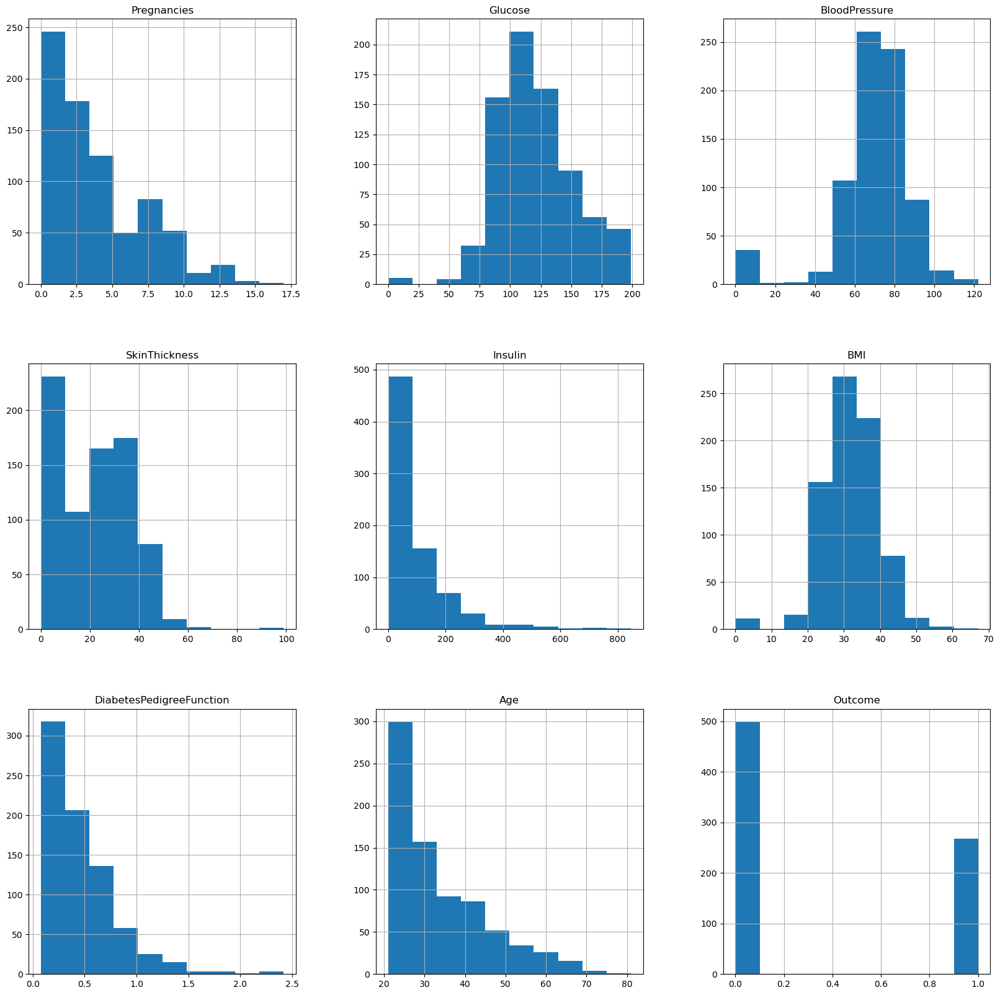

In [1]:
import pandas as pd
diabetes_data = pd.read_csv('diabetes.csv')
p = diabetes_data.hist(figsize = (20,20))
diabetes_data.columns

0    500
1    268
Name: Outcome, dtype: int64


Text(0, 0.5, 'Case counts')

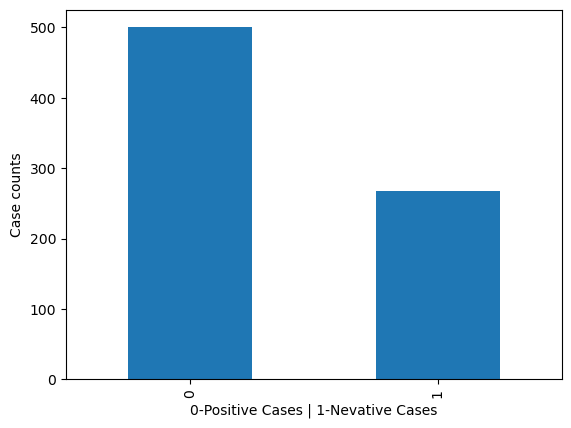

In [2]:

## checking the balance of the data by plotting the count of outcomes by their value
color_wheel = {1: "#0392cf", 
               2: "#7bc043"}
colors = diabetes_data["Outcome"].map(lambda x: color_wheel.get(x + 1))
print(diabetes_data.Outcome.value_counts())
p=diabetes_data.Outcome.value_counts().plot(kind="bar",)
p.set_xlabel("0-Positive Cases | 1-Nevative Cases")
p.set_ylabel("Case counts")

In [3]:
from sklearn.datasets import load_svmlight_file
diabetes_features,diabetes_labels = load_svmlight_file('diabetes_scale.txt')
#Since the data is of the type SVMlight file using a tht particular reader to read the data
print(diabetes_features.shape)

(768, 8)


In [4]:
#the data in of the form of a tuple 
diabetes_features = diabetes_features.toarray()
print(type(diabetes_features),type(diabetes_labels))

<class 'numpy.ndarray'> <class 'numpy.ndarray'>


In [5]:
import numpy as np
import random
np.random.seed(10)
weights = np.random.rand(8)
# weights = np.array([0.,0.,0.,0.,0.,0.,0.,0.])
weights

array([0.77132064, 0.02075195, 0.63364823, 0.74880388, 0.49850701,
       0.22479665, 0.19806286, 0.76053071])

In [6]:
def accuracy(y_true, y_pred):
    accuracy = np.mean(y_pred == y_true)
    return accuracy
#Prredicting for each row {-1,1} and then getting tht into pred array and returning the accuracy
def predict(features,weight):
    pred = list()
    for row in features:
        activation = 0
        for i in range(len(row)):
            activation += weights[i ] * row[i] #calc Xi*Wi
        pred.append(np.sign(activation))# Predictig for 1 row
    return (accuracy(diabetes_labels, pred))
def update_weights(weights):
    l_rate = 0.0001
    summation = 0
    for row,y in zip(diabetes_features,diabetes_labels):
        # calaculating the summation of 1*8 vector for each row
        summation+= (y*row*(1 if y*(np.dot(row,weights))<0 else 0))
    #now modifying the weights according to learning for 
    weights += (l_rate*summation)
#     print("updated",weights)
    return weights

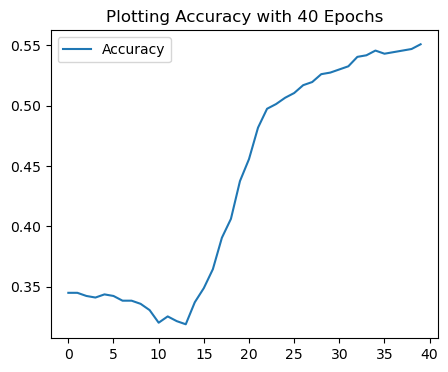

best accuracy:  0.55078125
best weights:  [ 0.10378526 -0.10073597  0.51230559  0.24198056 -0.09956228  0.03309548
 -0.2585228   0.05204732]


In [7]:
# print("1st accuracy" ,predict(diabetes_features,weights))
import matplotlib.pyplot as plt
best_weights = 0
best_accu = 0
acc_list,loss_list = [],[]
for i in range(40):
    acc = predict(diabetes_features,weights)
    weights = update_weights(weights)
    acc_list.append(acc)
    if acc>best_accu:
        best_accu = acc
        best_weights = weights
#     l = zero_one_loss(diabetes_features,diabetes_labels,weights)
#     loss_list.append(l)
# plt.figure(figsize=(5, 4))
# plt.title("Plotting Loss with 20 Epochs ")
# plt.plot(np.arange(20), e_train_loss_list, label = " Loss")
# plt.legend()
# plt.show()

#Plotting Validation Curve
plt.figure(figsize=(5, 4))
plt.title("Plotting Accuracy with 40 Epochs")
plt.plot(np.arange(40), acc_list, label = "Accuracy")
# plt.plot(np.arange(40), loss_list, label = "Loss")
plt.legend()
plt.show()
    
print("best accuracy: ",best_accu)
print("best weights: " ,best_weights)

## Experimentation

In [8]:
#Adding an additional column to the dataset initialized as all 1 & and additional weight which acts as bias
import numpy as np
type(diabetes_features)
bias_col = np.ones(len(diabetes_features)).reshape(-1,1)
mod_diabetes_features = np.concatenate([diabetes_features, bias_col], axis=1)
print(mod_diabetes_features.shape)

(768, 9)


In [9]:
from sklearn.model_selection import train_test_split
#Splits With Bias
X_bigtrain, b_X_test, y_bigtrain, b_y_test = train_test_split(mod_diabetes_features, diabetes_labels, test_size=0.20, random_state=42,stratify=diabetes_labels,shuffle=True)
b_X_train, b_X_Val, b_y_train, b_y_Val = train_test_split(X_bigtrain, y_bigtrain, test_size=0.20, random_state=42,stratify=y_bigtrain,shuffle=True)
print("Splits With Bias")
print("Training Size :",b_X_train.shape)
print("Testing Size :",b_X_test.shape)
print("Validation Size :",b_X_Val.shape)

#splitting with no bias 
X_bigtrain, X_test, y_bigtrain, y_test = train_test_split(diabetes_features, diabetes_labels, test_size=0.20, random_state=42,stratify=diabetes_labels,shuffle=True)
X_train, X_Val, y_train, y_Val = train_test_split(X_bigtrain, y_bigtrain, test_size=0.20, random_state=42,stratify=y_bigtrain,shuffle=True)
print("Splits With Bias")
print("Training Size :",X_train.shape)
print("Testing Size :",X_test.shape)
print("Validation Size :",X_Val.shape)

Splits With Bias
Training Size : (491, 9)
Testing Size : (154, 9)
Validation Size : (123, 9)
Splits With Bias
Training Size : (491, 8)
Testing Size : (154, 8)
Validation Size : (123, 8)


In [10]:
import seaborn as sns
def accuracy(y_true, y_pred):
    accuracy = np.mean(y_pred == y_true)
    return accuracy
#Prredicting for each row {-1,1} and then getting tht into pred array and returning the accuracy
def predict(features,labels,weights):
    pred = list()
    for row in features:
        activation = 0
        for i in range(len(row)):
            activation += weights[i] * row[i] #calc Xi*Wi
        pred.append(np.sign(activation))# Predictig for 1 row
    return (accuracy(labels, pred))
def accuracy_scores(features,labels,weights):
    from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report, confusion_matrix
    from sklearn.metrics import roc_curve,roc_auc_score
    pred = list()
    for row in features:
        activation = 0
        for i in range(len(row)):
            activation += weights[i] * row[i] #calc Xi*Wi
        pred.append(np.sign(activation))# Predictig for 1 row
    print("F1 Score :",f1_score(labels, pred, average="binary"))
    print("Precision :",precision_score(labels, pred, average="binary"))
    print("Recall :",recall_score(labels, pred, average="binary"))
    print("Confusion Matrix :")
    cmat = confusion_matrix(labels, pred)
    sns.heatmap(cmat,annot=True)
    ax= plt.subplot()
    sns.heatmap(cmat, annot=True, fmt='g', ax=ax);
    # labels, title and ticks
    plt.title('Confusion Matrix')
    ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
    ax.set_title('Confusion Matrix'); 
    ax.xaxis.set_ticklabels(['Positive', 'Negative']); ax.yaxis.set_ticklabels(['Positive', 'Negative']);
    
#     plt.set_xticklabels(['Positive', 'Negative'])
#     plt.set_yticklabels(['Positive', 'Negative'])
    plt.show()
    return 
def update_weights(weights,festures,labels,loss,l_rate):
#     l_rate = 0.001
    summation = 0
    for row,y in zip(festures,labels):
        # calaculating the summation of 1*8 vector for each row
        if(loss == "perceptron"):
            ls = max(0,-1*y*(np.dot(row,weights))) #Perceptron Loss
            summation+= (y*row*ls)
        elif(loss == "zero_one"):
            ls = (1 if y*(np.dot(row,weights))<0 else 0) #ZeroOne Loss
            summation+= (y*row*ls)
    #now modifying the weights according to learning for 
    weights += (l_rate*summation)
#     print("updated",weights)
    return weights
def zero_one_loss(features,labels,weights):
    loss =0
    for row ,y in zip(features,labels):
        loss+=(1 if y*(np.dot(row,weights))<0 else 0)
    return loss/len(labels)

def perceptron_loss(features,labels,weights):
    loss =0
    for row ,y in zip(features,labels):
        loss+= max(0,-1*y*(np.dot(row,weights)))
    return loss/len(labels)

### SK learn baseline

In [11]:
from sklearn.linear_model import Perceptron
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
clf = Perceptron(tol=1e-3, random_state=42)
clf.fit(X_bigtrain, y_bigtrain)
Perceptron()
sk_pred = clf.predict(X_test)
print("Testing Accuracy for Sklearn Baseline : ",clf.score(X_test, y_test))
print("F1 Score :",f1_score(y_test, sk_pred, average="binary"))
print("Precision :",precision_score(y_test, sk_pred, average="binary"))
print("Recall :",recall_score(y_test, sk_pred, average="binary"))

Testing Accuracy for Sklearn Baseline :  0.7987012987012987
F1 Score : 0.8472906403940887
Precision : 0.8349514563106796
Recall : 0.86


In [12]:
#Initializing 8 weights + 1 Bias
np.random.seed(89)
b_weights = np.random.rand(9)
# weights = np.zeros(8)
weights

array([ 0.10378526, -0.10073597,  0.51230559,  0.24198056, -0.09956228,
        0.03309548, -0.2585228 ,  0.05204732])

### Experimenting with initial weights with bias

In [13]:
#Experimenting with the the best Random seed for weights
all_acc=list()
overall_best_acc = 0
overall_best_weights = 0
l_rate =0.001
for j in range(202):
    np.random.seed(j)
    b_weights = np.random.rand(9)
    best_weights = 0
    best_accu = 0
    for i in range(20):
        b_weights = update_weights(b_weights,b_X_train,b_y_train,"zero_one",l_rate)
        train_acc = predict(b_X_train,b_y_train,b_weights)
        val_acc = predict(b_X_Val,b_y_Val,b_weights)
#         print("Iteration ",i)
#         print("Training accuracy:",train_acc," Validation accuracy:",val_acc)
        if val_acc>best_accu:
            best_accu = val_acc
            best_weights = b_weights
#     print("for Random Seed:",j)
#     print("best accuracy: ",best_accu)
    if best_accu>overall_best_acc:
            overall_best_acc = best_accu
            overall_best_weights = best_weights
    all_acc.append((best_accu,j))
#     print("best weights: " ,best_weights)
all_acc.sort(reverse=True)
all_acc[:6]

[(0.7886178861788617, 89),
 (0.7560975609756098, 111),
 (0.7479674796747967, 195),
 (0.7398373983739838, 10),
 (0.7317073170731707, 160),
 (0.7317073170731707, 107)]

###  Experimenting with initial weights without bias

In [14]:
#Experimenting with the the best Random seed for weights
all_acc=list()
overall_best_acc = 0
overall_best_weights = 0
l_rate =0.001
for j in range(202):
    np.random.seed(j)
    weights = np.random.rand(8)
    best_weights = 0
    best_accu = 0
    for i in range(20):
        b_weights = update_weights(weights,X_train,y_train,"zero_one",l_rate)
        train_acc = predict(X_train,y_train,weights)
        val_acc = predict(X_Val,y_Val,weights)
#         print("Iteration ",i)
#         print("Training accuracy:",train_acc," Validation accuracy:",val_acc)
        if val_acc>best_accu:
            best_accu = val_acc
            best_weights = weights
#     print("for Random Seed:",j)
#     print("best accuracy: ",best_accu)
    if best_accu>overall_best_acc:
            overall_best_acc = best_accu
            overall_best_weights = best_weights
    all_acc.append((best_accu,j))
#     print("best weights: " ,best_weights)
all_acc.sort(reverse=True)
all_acc[:6]

[(0.7723577235772358, 84),
 (0.7723577235772358, 33),
 (0.7723577235772358, 26),
 (0.7642276422764228, 195),
 (0.7642276422764228, 140),
 (0.7642276422764228, 138)]

### Hyper-Parameter Tuning with Bias

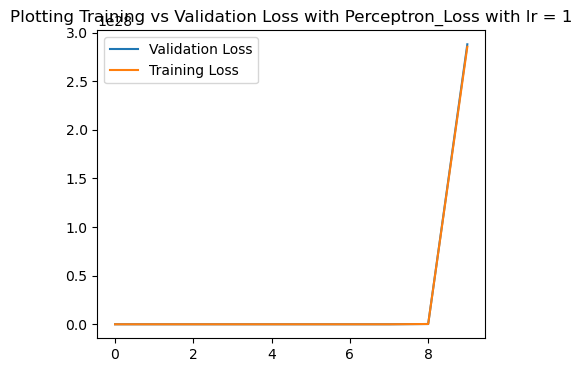

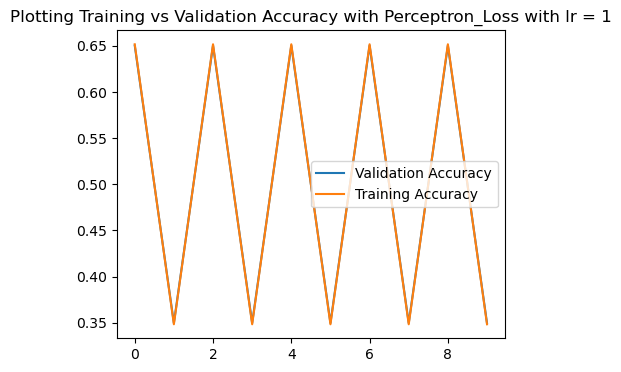

best accuracy:  0.6504065040650406
best weights:  [ 6.70164952e+27 -6.12152058e+27 -2.14718836e+27  7.93712116e+27
  1.08634920e+28 -6.03405153e+26  8.93876291e+27  7.17940394e+27
 -1.39853446e+28]


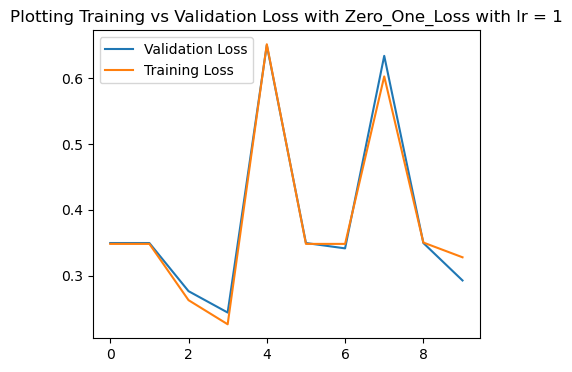

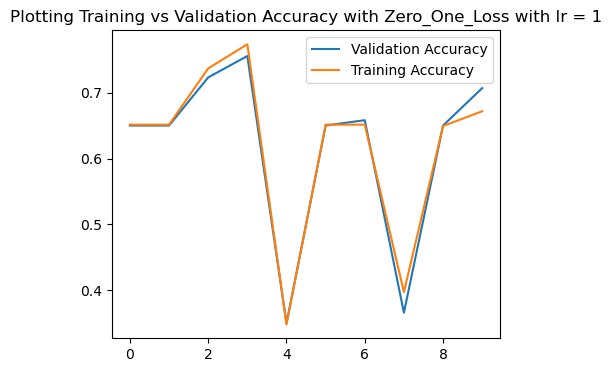

best accuracy:  0.7560975609756098
best weights:  [-140.67680518 -259.66363439    0.99579383  -87.03447589  -92.95358699
 -124.57716338  -96.26415047 -133.48644587   32.09987276]


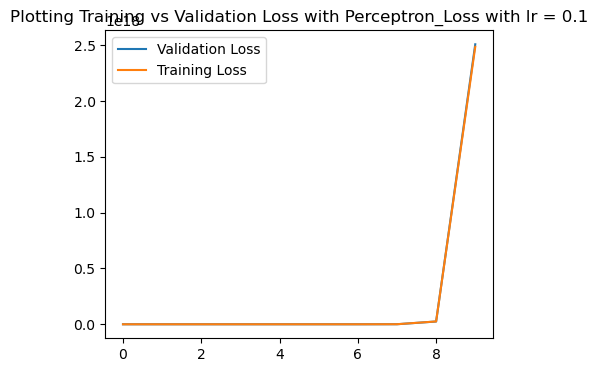

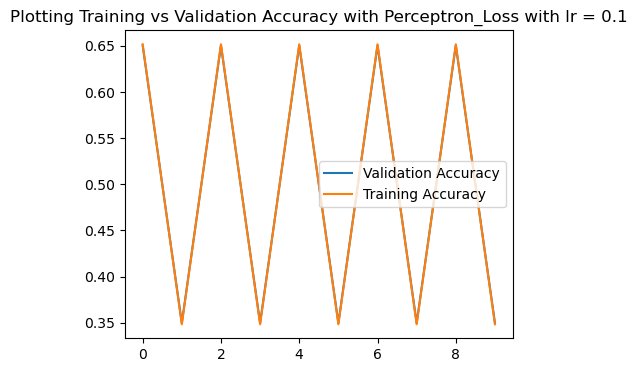

best accuracy:  0.6504065040650406
best weights:  [ 5.81768779e+17 -5.41560185e+17 -1.88110064e+17  6.91181572e+17
  9.46705553e+17 -5.60591783e+16  7.78559902e+17  6.23096284e+17
 -1.22070122e+18]


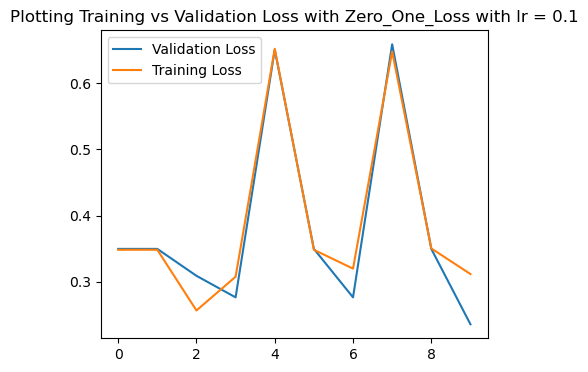

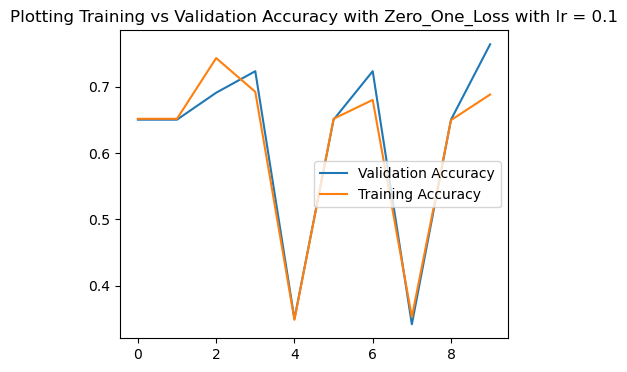

best accuracy:  0.7642276422764228
best weights:  [-13.81207308 -28.5777285   -0.64681919  -8.01116835  -7.59019274
 -13.9787949   -7.9269103  -13.30975536   1.59987276]


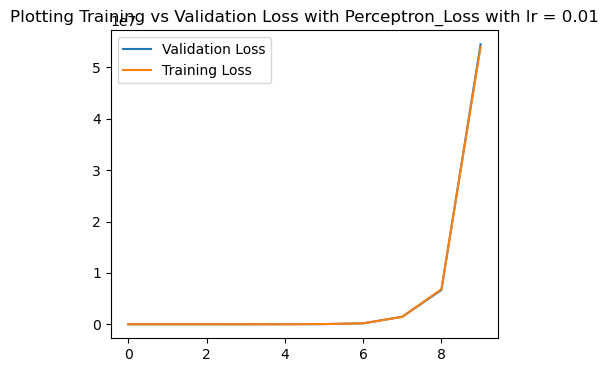

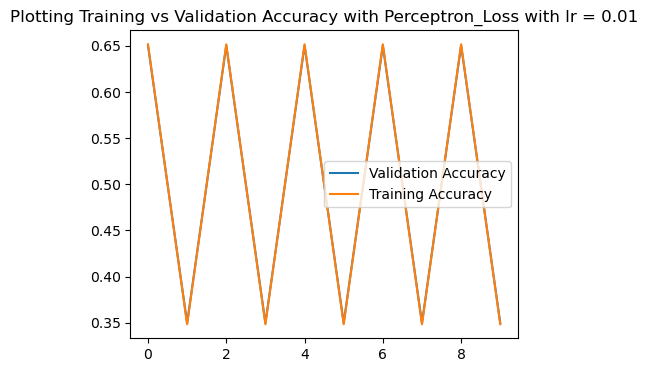

best accuracy:  0.6504065040650406
best weights:  [ 11992873.04793558 -14304357.83875002  -4393472.21047423
  14909062.39261475  20639435.64367222  -2297796.04239561
  16839969.04401296  12805259.86922669 -27205328.85905707]


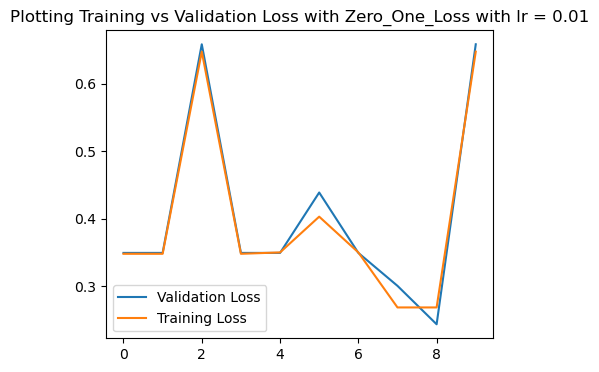

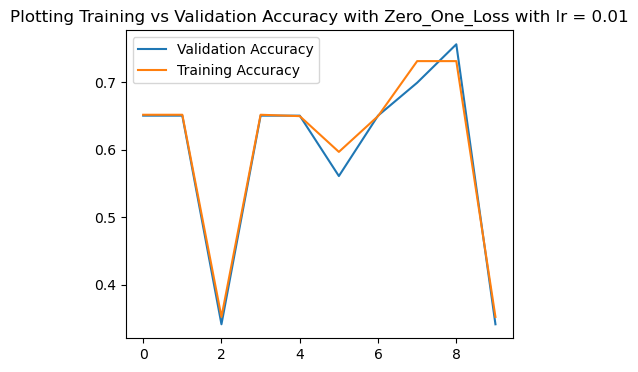

best accuracy:  0.7560975609756098
best weights:  [-0.08089404 -2.45376106  0.13072338  0.1329815   0.74900734 -1.04035873
  0.1906396   0.07891418 -0.95012724]


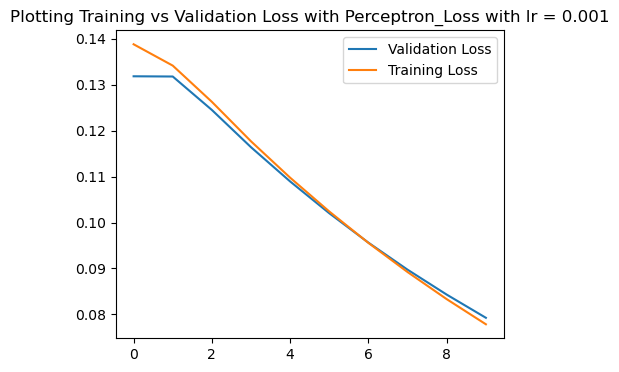

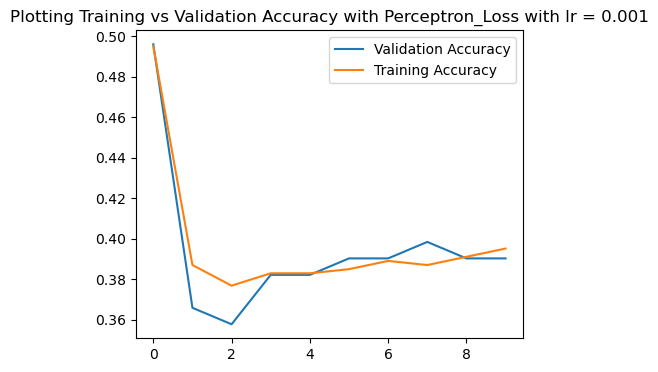

best accuracy:  0.4959349593495935
best weights:  [ 0.17183994  0.08674556  0.17894895 -0.07645034  0.27504054 -0.0716106
 -0.02793274  0.12548893  0.32478193]


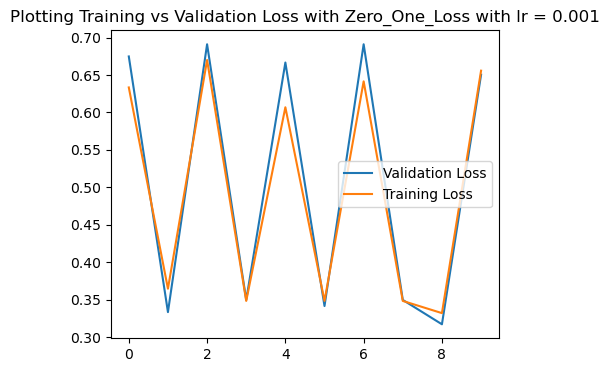

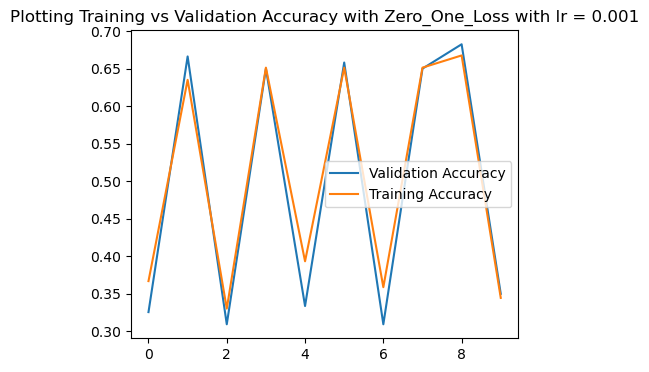

best accuracy:  0.6829268292682927
best weights:  [ 0.08345899 -0.24239447  0.11618255 -0.02693703  0.33452312 -0.17772675
  0.03176518  0.04604768  0.12987276]


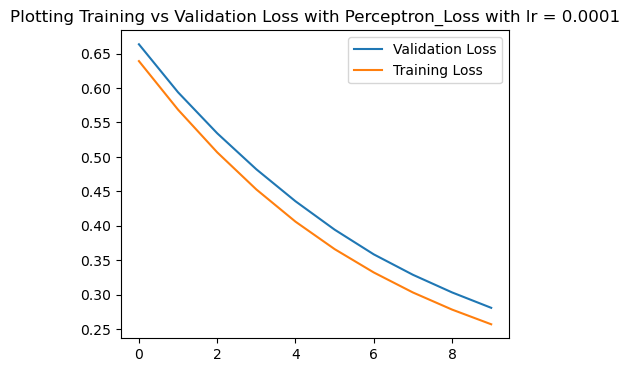

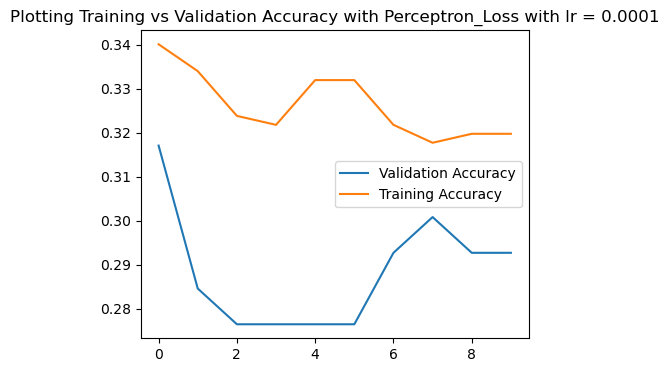

best accuracy:  0.3170731707317073
best weights:  [ 3.42491737e-01  2.58831763e-01  2.67790865e-01 -4.07741734e-02
  3.75038365e-01 -1.46644876e-02  2.36722734e-04  3.05964387e-01
  3.11958593e-01]


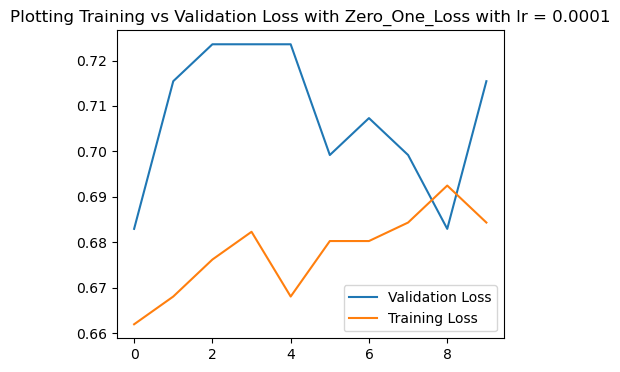

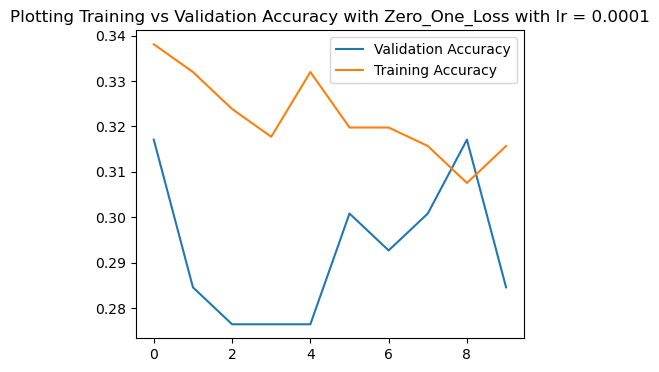

best accuracy:  0.3170731707317073
best weights:  [ 0.31196487  0.25844065  0.28029571 -0.06898536  0.33449315 -0.01772914
 -0.03330861  0.27734105  0.35707276]


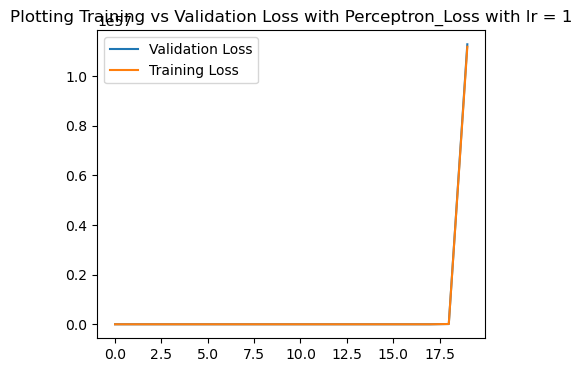

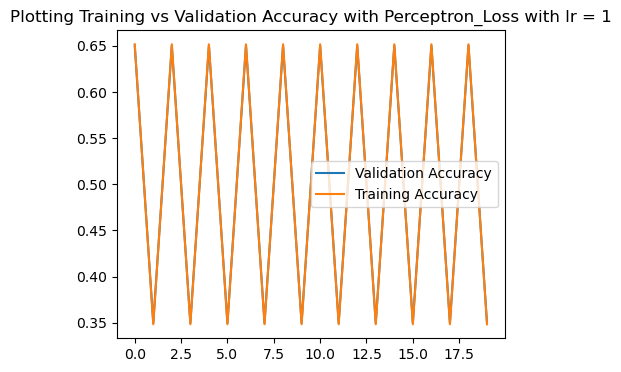

best accuracy:  0.6504065040650406
best weights:  [ 2.62787025e+56 -2.40038840e+56 -8.41961728e+55  3.11232697e+56
  4.25982401e+56 -2.36608978e+55  3.50509363e+56  2.81520869e+56
 -5.48397387e+56]


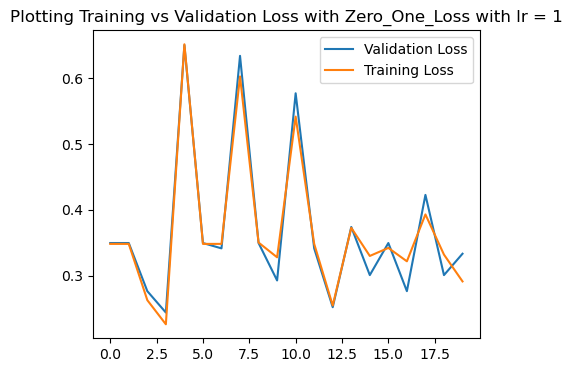

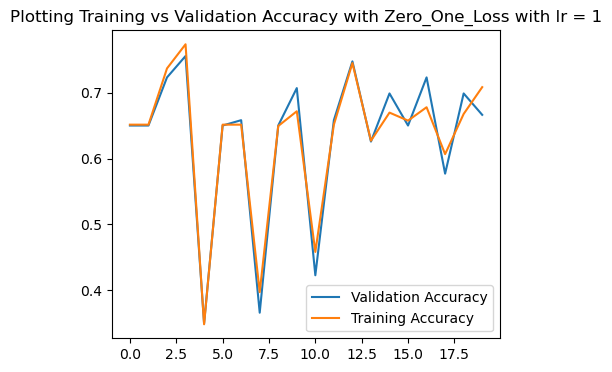

best accuracy:  0.7560975609756098
best weights:  [-106.44152018 -417.22140978   30.12693163  -40.95372059   18.35842861
 -182.31786735  -48.19241877  -58.68645707  -97.90012724]


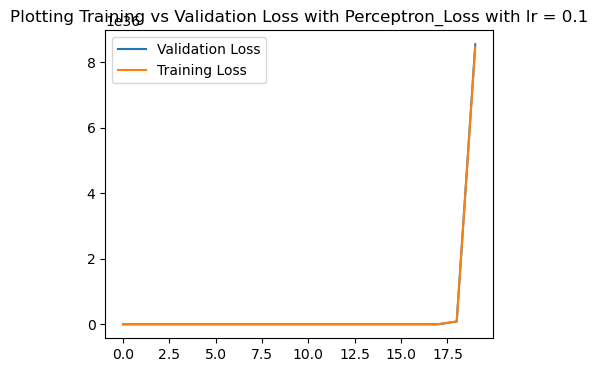

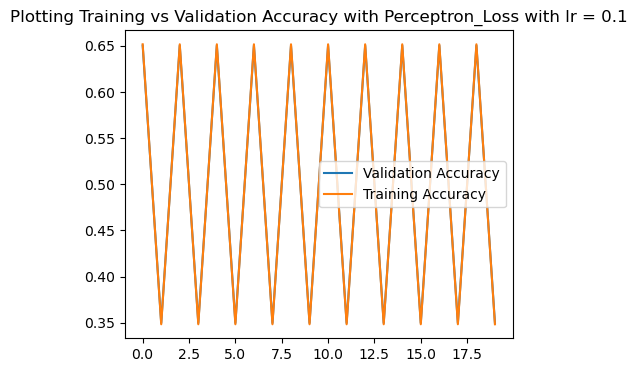

best accuracy:  0.6504065040650406
best weights:  [ 1.98352125e+36 -1.84643139e+36 -6.41354989e+35  2.35656052e+36
  3.22776101e+36 -1.91131899e+35  2.65447402e+36  2.12442600e+36
 -4.16194009e+36]


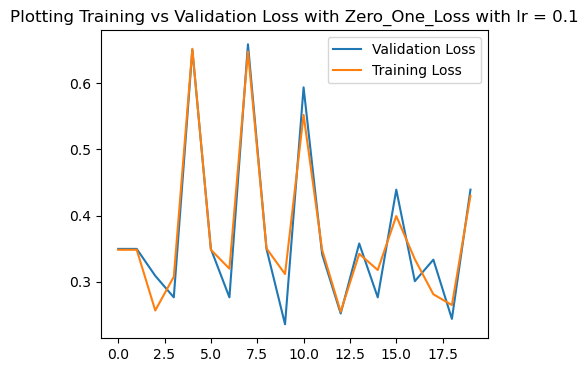

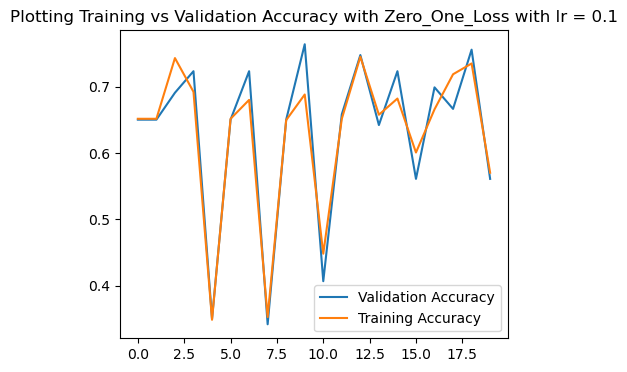

best accuracy:  0.7642276422764228
best weights:  [ -8.25913243 -40.71943576   2.90891844  -2.57480889   3.78379867
 -18.38744089  -2.46012988  -4.12642331 -10.40012724]


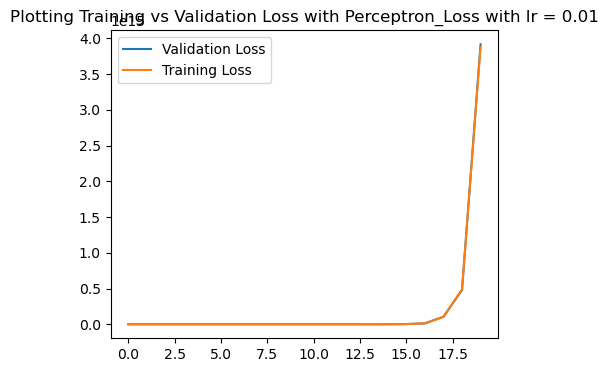

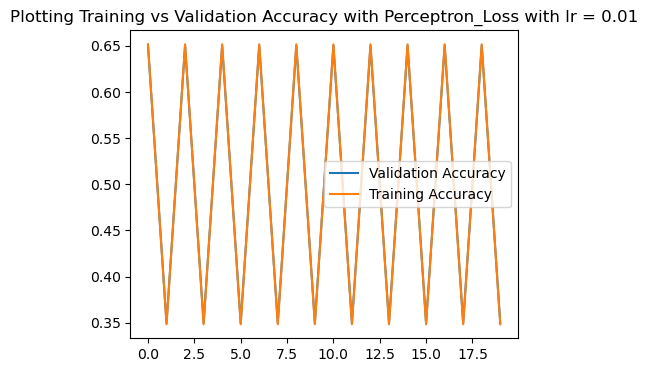

best accuracy:  0.6504065040650406
best weights:  [ 8.61929015e+14 -1.02805566e+15 -3.15759298e+14  1.07151585e+15
  1.48335835e+15 -1.65142836e+14  1.21029030e+15  9.20315342e+14
 -1.95524979e+15]


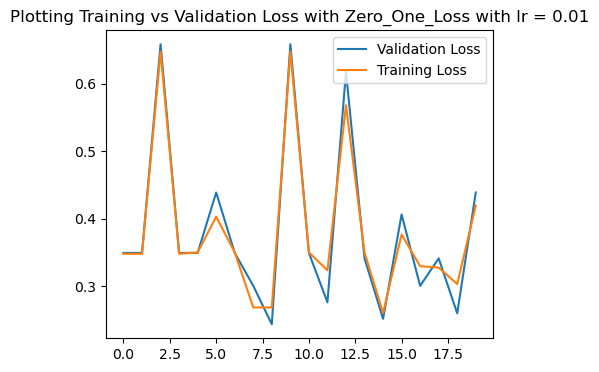

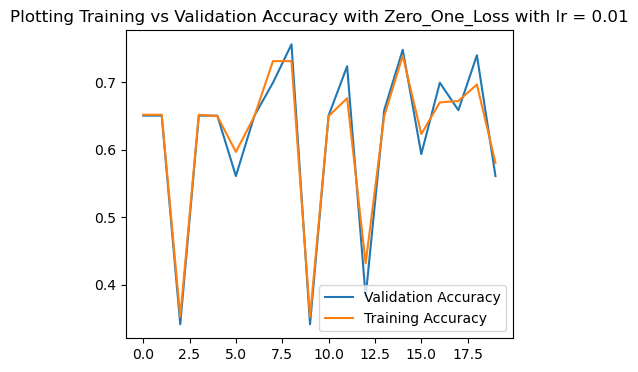

best accuracy:  0.7560975609756098
best weights:  [-0.81912958 -4.21270563  0.29564136 -0.30328174  0.53695017 -1.90368226
 -0.22719135 -0.47541938 -0.94012724]


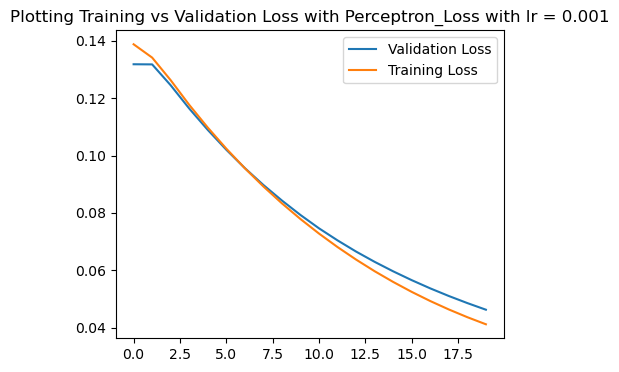

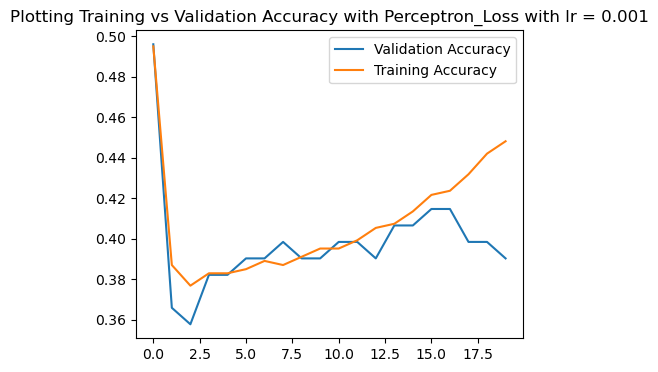

best accuracy:  0.4959349593495935
best weights:  [ 0.10929412 -0.01171143  0.12016808 -0.06075222  0.25210356 -0.08929716
 -0.00285896  0.06312091  0.26989619]


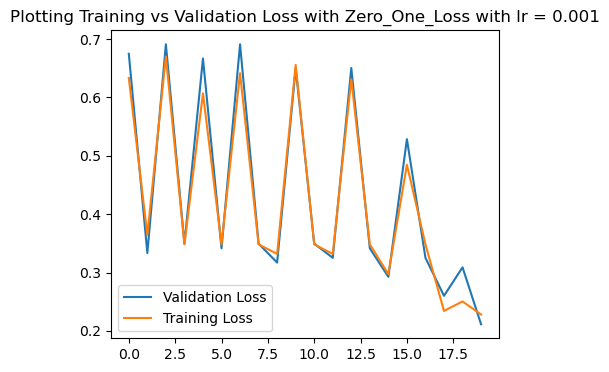

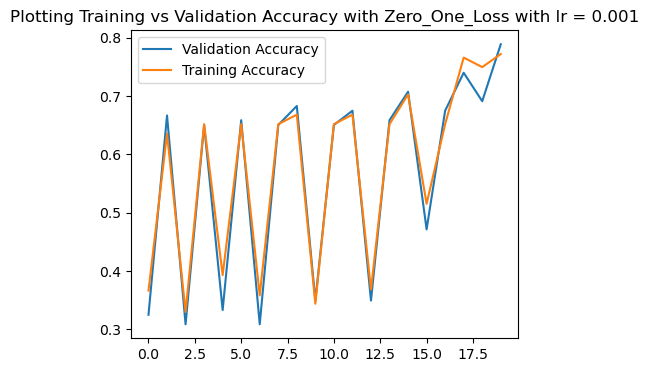

best accuracy:  0.7886178861788617
best weights:  [-0.05665869 -0.44713816  0.11006779 -0.104028    0.19735522 -0.26404569
 -0.05798205 -0.07308568  0.16187276]


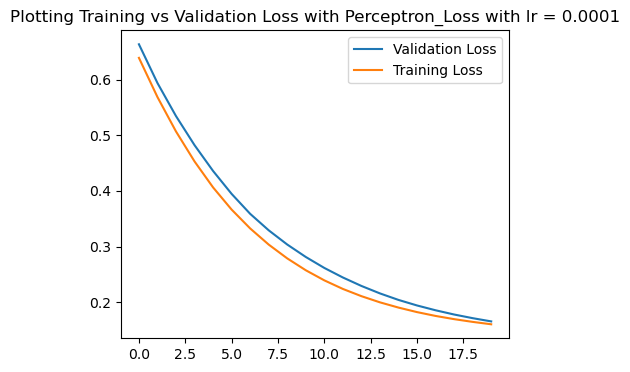

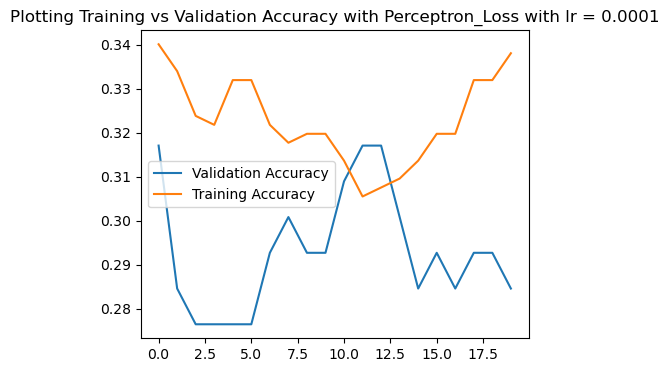

best accuracy:  0.3170731707317073
best weights:  [ 0.28449711  0.24431276  0.26057446 -0.07864765  0.31739831 -0.02758979
 -0.04071116  0.24232049  0.36736324]


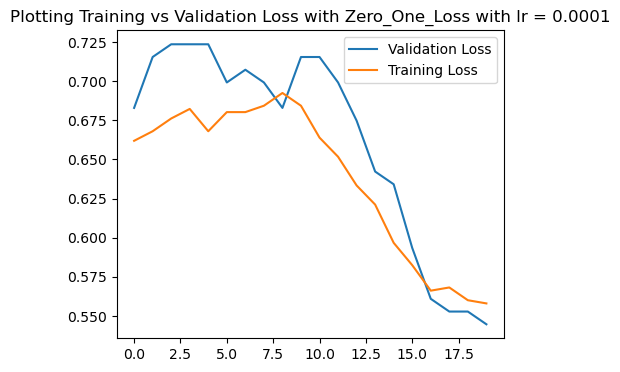

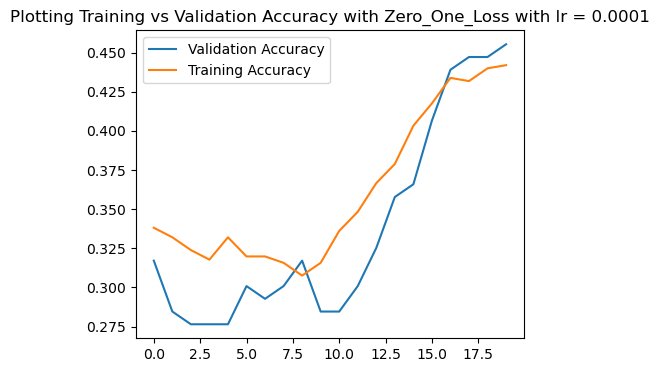

best accuracy:  0.45528455284552843
best weights:  [ 0.22019428  0.19189945  0.25187931 -0.10457428  0.27201253 -0.04794508
 -0.06989879  0.17783437  0.39977276]


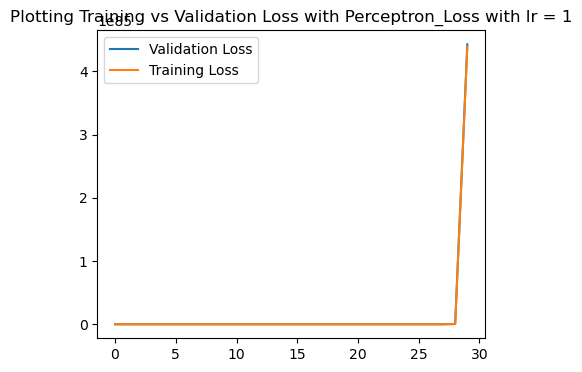

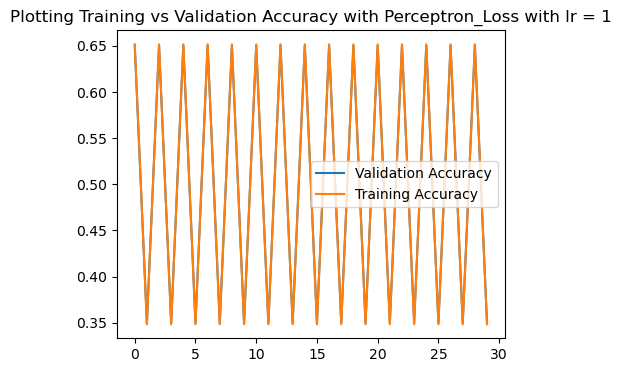

best accuracy:  0.6504065040650406
best weights:  [ 1.03044810e+85 -9.41247263e+84 -3.30152475e+84  1.22041468e+85
  1.67037454e+85 -9.27797988e+83  1.37442748e+85  1.10390780e+85
 -2.15039174e+85]


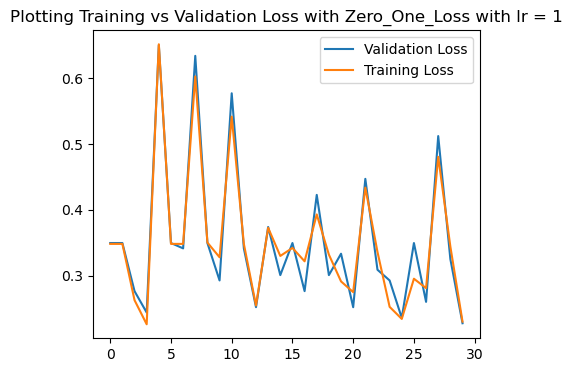

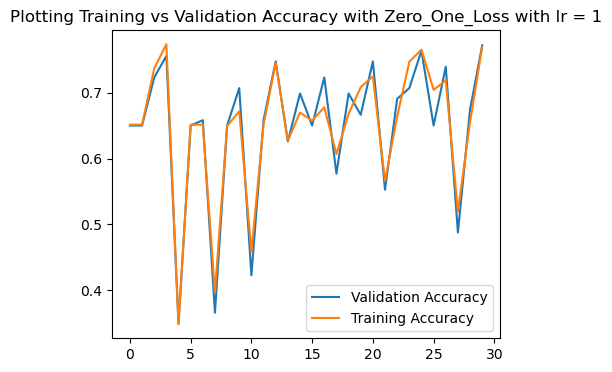

best accuracy:  0.7723577235772358
best weights:  [-128.73565968 -426.09075332   75.29087763  -64.55979129   10.57588431
 -199.21653303  -91.63478595  -58.75313807  -38.90012724]


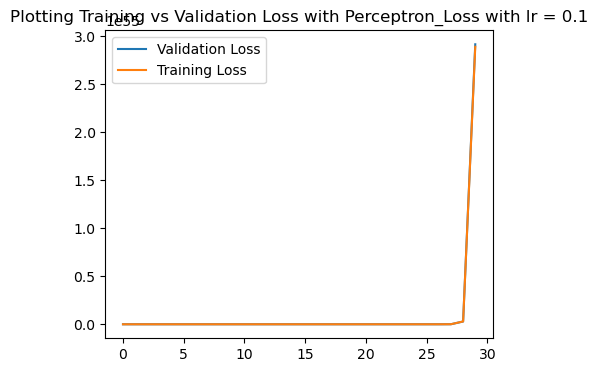

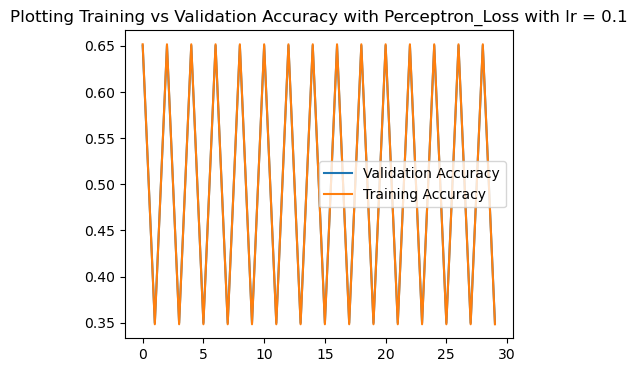

best accuracy:  0.6504065040650406
best weights:  [ 6.76274956e+54 -6.29534625e+54 -2.18667845e+54  8.03461450e+54
  1.10049435e+55 -6.51657835e+53  9.05034065e+54  7.24315960e+54
 -1.41899959e+55]


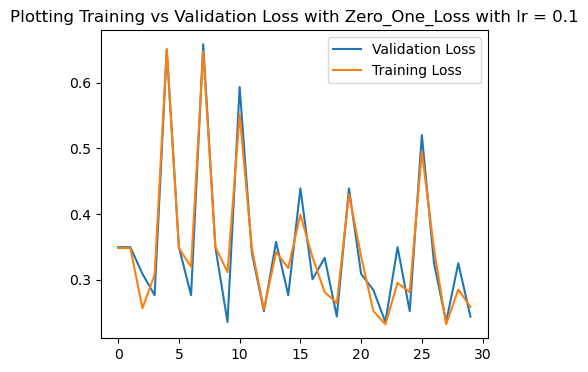

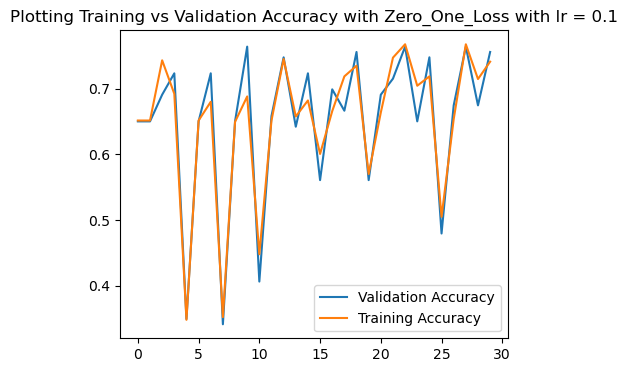

best accuracy:  0.7642276422764228
best weights:  [-13.80031193 -37.70235011   9.21711696  -8.90208166  -2.28476305
 -19.28997526 -12.02247117  -7.30309131   2.59987276]


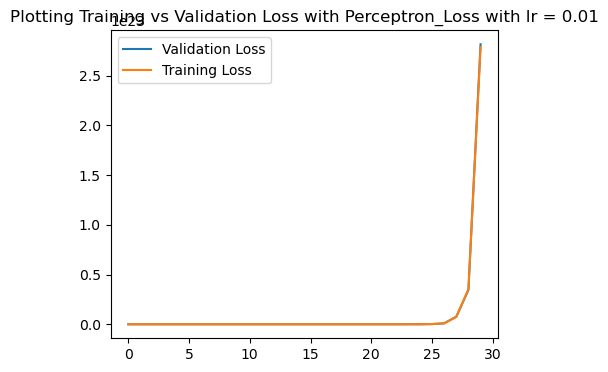

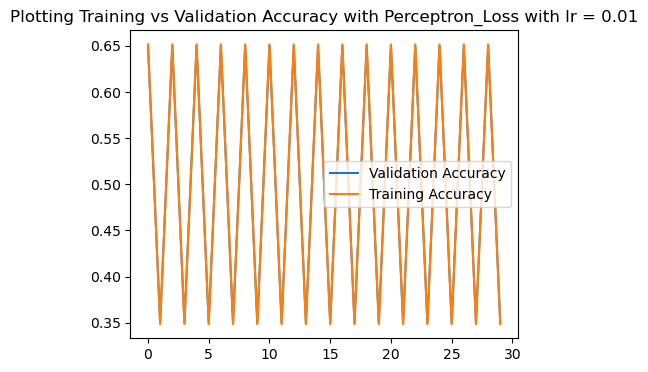

best accuracy:  0.6504065040650406
best weights:  [ 6.19469268e+22 -7.38864662e+22 -2.26936532e+22  7.70099539e+22
  1.06609117e+23 -1.18688326e+22  8.69836883e+22  6.61431582e+22
 -1.40524003e+23]


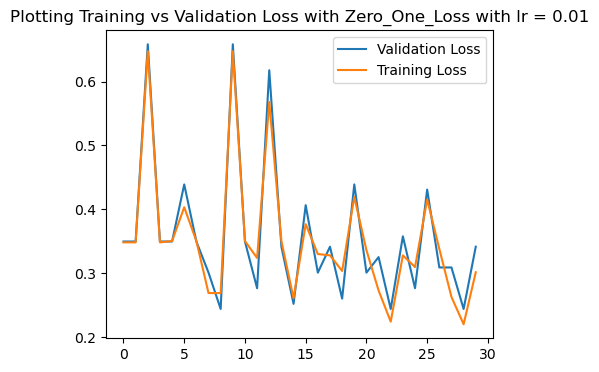

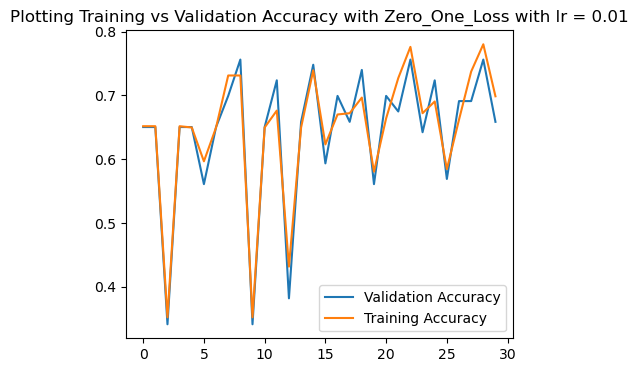

best accuracy:  0.7560975609756098
best weights:  [-0.96324745 -4.1478312   0.81564149 -0.40156462  0.58702072 -1.98900277
 -0.55598732 -0.25708614 -0.55012724]


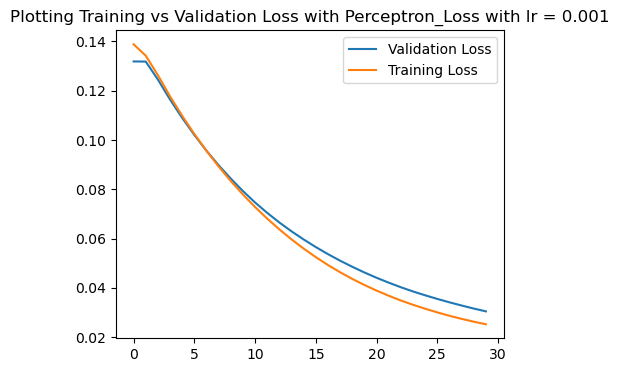

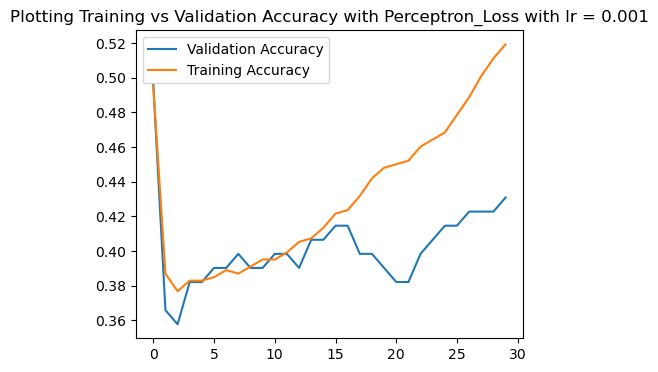

best accuracy:  0.4959349593495935
best weights:  [ 0.07634785 -0.05993963  0.08926211 -0.05234638  0.23048751 -0.09344552
  0.01063702  0.03311859  0.23557132]


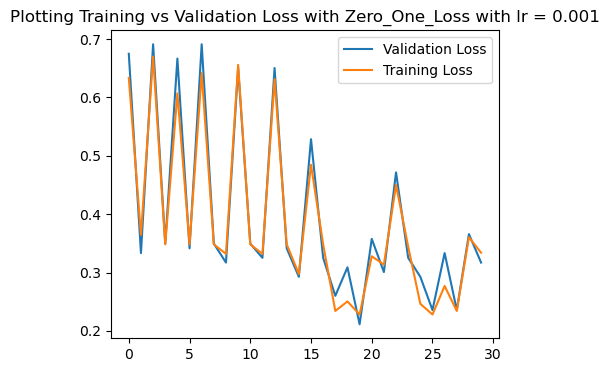

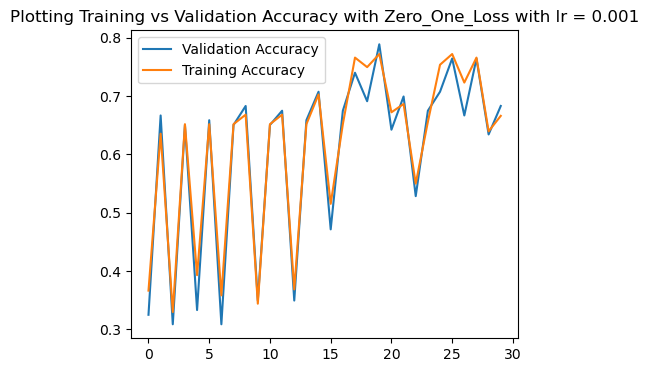

best accuracy:  0.7886178861788617
best weights:  [-0.12395284 -0.40174116  0.13675634 -0.13962396  0.09465069 -0.25090709
 -0.120918   -0.09405235  0.23187276]


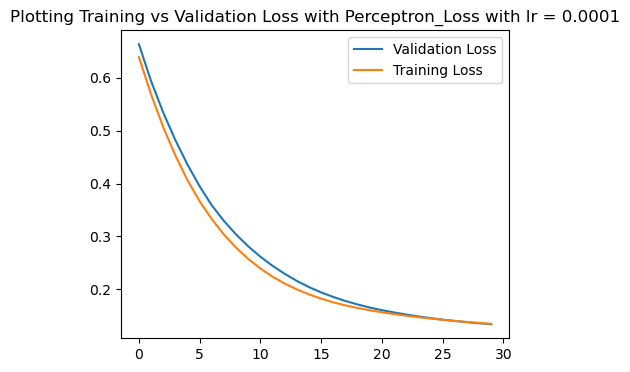

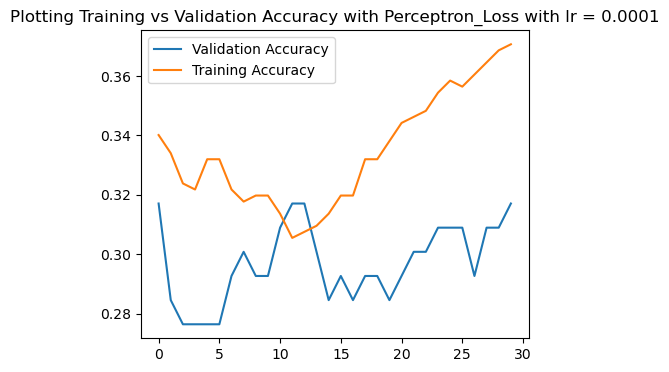

best accuracy:  0.3170731707317073
best weights:  [ 0.25707554  0.22403353  0.24919027 -0.08770271  0.29841393 -0.03557096
 -0.04936994  0.21281528  0.37686698]


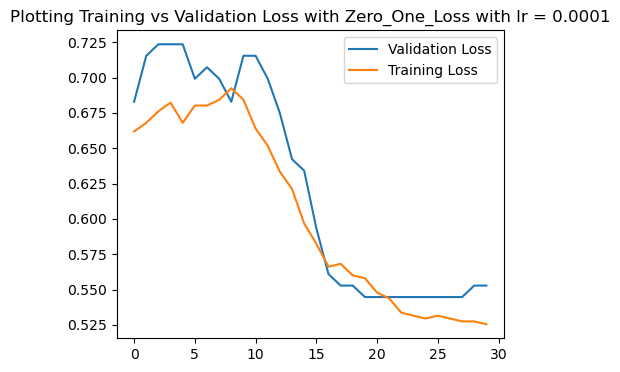

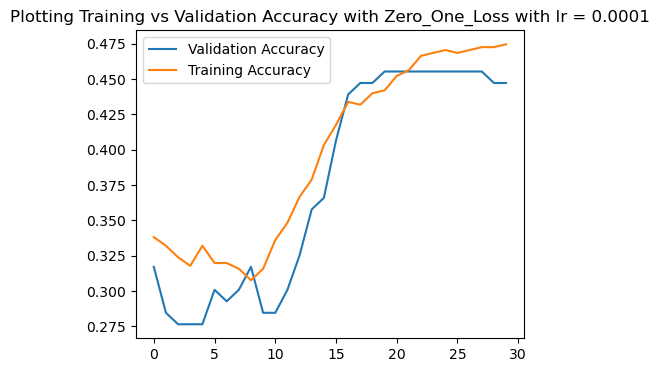

best accuracy:  0.45528455284552843
best weights:  [ 0.18174722  0.1155276   0.21312849 -0.09477632  0.2712319  -0.07264732
 -0.05426463  0.1365577   0.36777276]


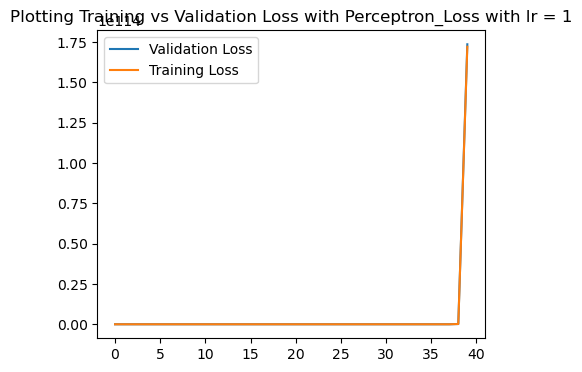

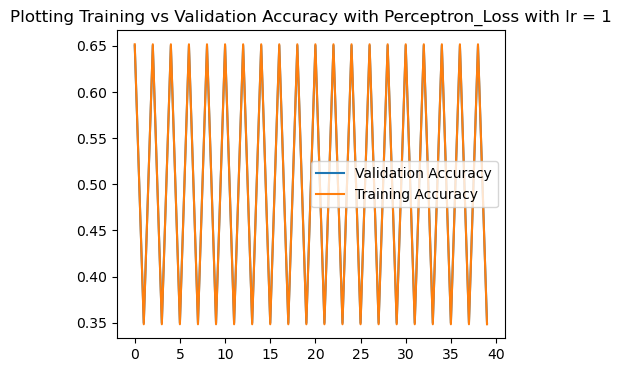

best accuracy:  0.6504065040650406
best weights:  [ 4.04062298e+113 -3.69084606e+113 -1.29460346e+113  4.78552543e+113
  6.54992110e+113 -3.63810838e+112  5.38944490e+113  4.32867527e+113
 -8.43217845e+113]


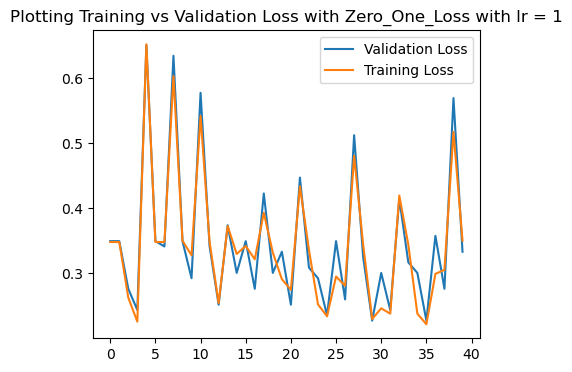

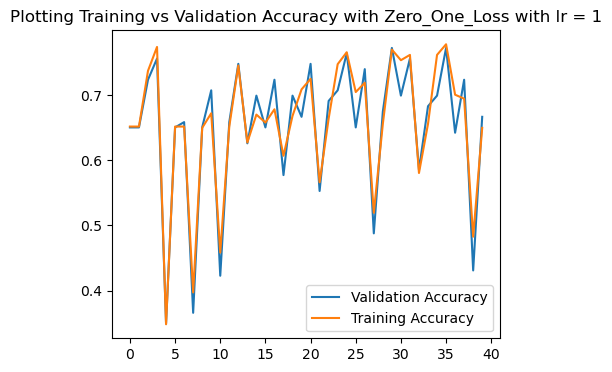

best accuracy:  0.7723577235772358
best weights:  [-215.26510518 -352.51788865  124.09418223 -165.68099739 -107.50452829
 -206.38345274 -214.53658739 -145.91981667  160.09987276]


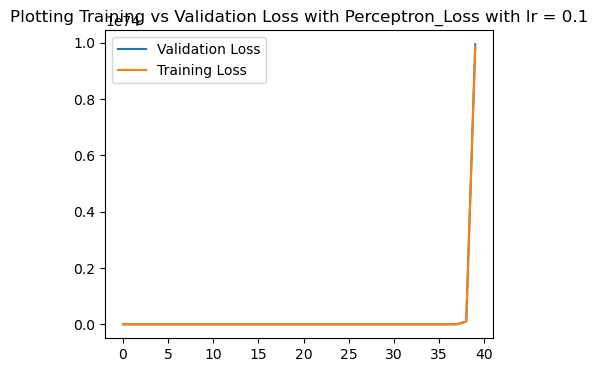

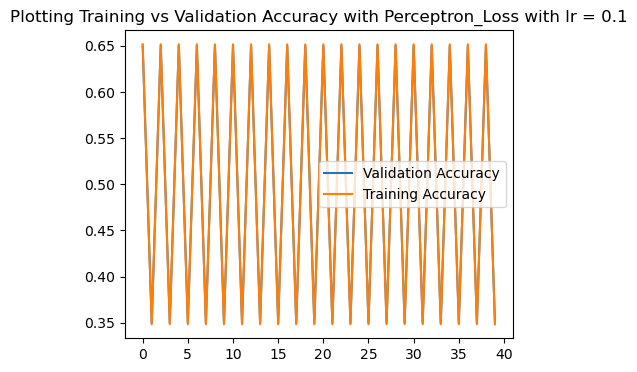

best accuracy:  0.6504065040650406
best weights:  [ 2.30573691e+73 -2.14637731e+73 -7.45540724e+72  2.73937502e+73
  3.75209879e+73 -2.22180566e+72  3.08568346e+73  2.46953111e+73
 -4.83803179e+73]


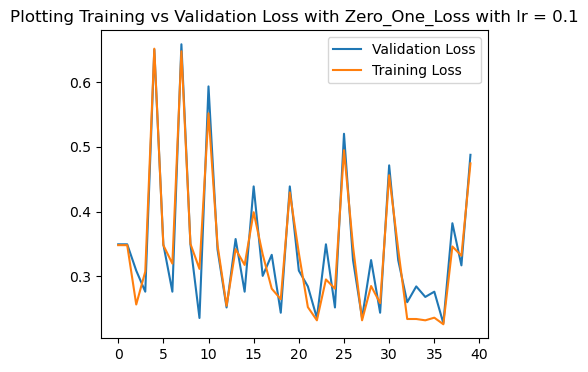

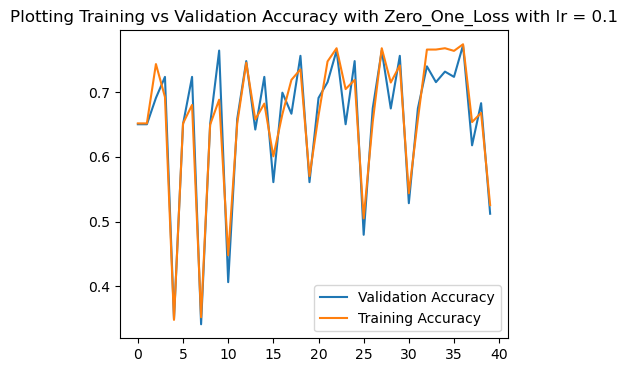

best accuracy:  0.7723577235772358
best weights:  [ -7.65325333 -36.63451031   9.25810215  -1.48491092   8.93509144
 -18.92052805  -5.36628045   0.4502416   -6.30012724]


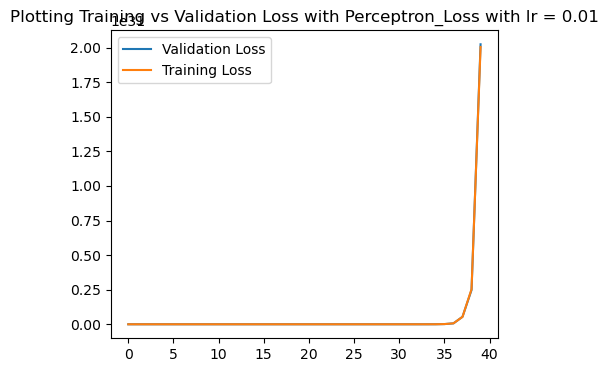

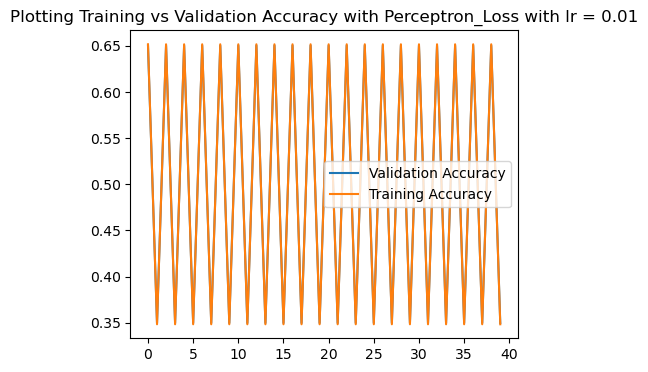

best accuracy:  0.6504065040650406
best weights:  [ 4.45213199e+30 -5.31022792e+30 -1.63099519e+30  5.53471330e+30
  7.66200820e+30 -8.53014218e+29  6.25152661e+30  4.75371557e+30
 -1.00994745e+31]


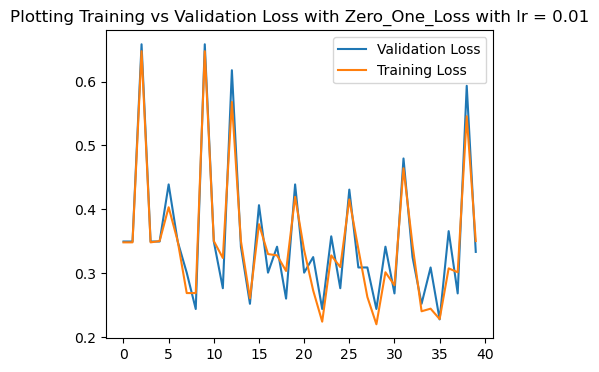

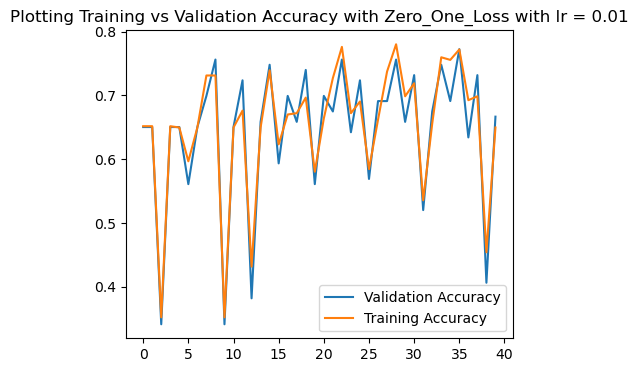

best accuracy:  0.7723577235772358
best weights:  [-2.23383613 -3.58119806  1.28777284 -1.7375242  -1.05782599 -2.14745289
 -2.16596177 -1.5370863   1.84987276]


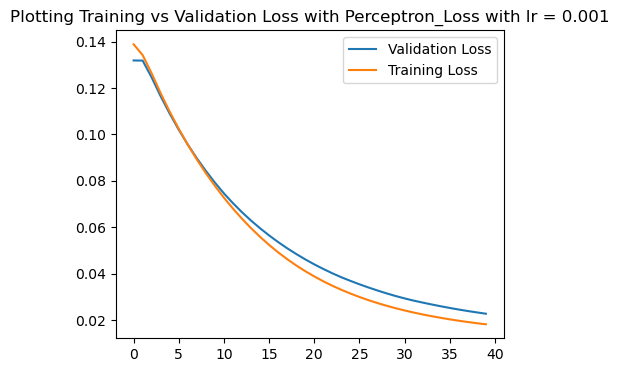

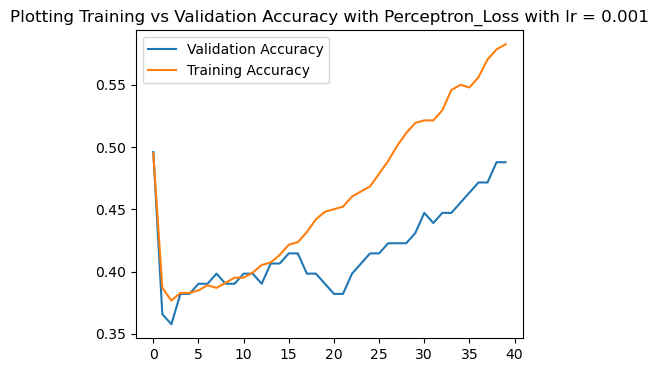

best accuracy:  0.4959349593495935
best weights:  [ 0.05668244 -0.08540663  0.071792   -0.04731049  0.21105862 -0.0931091
  0.01839493  0.01766031  0.21223883]


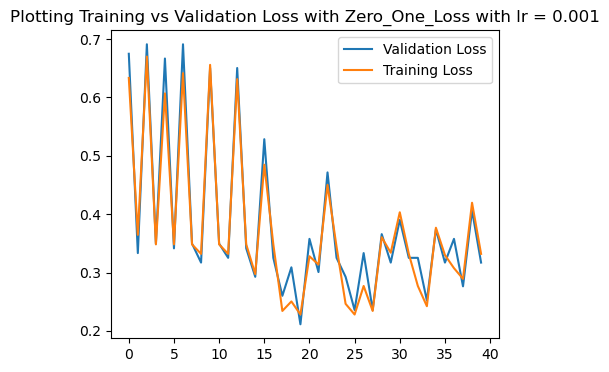

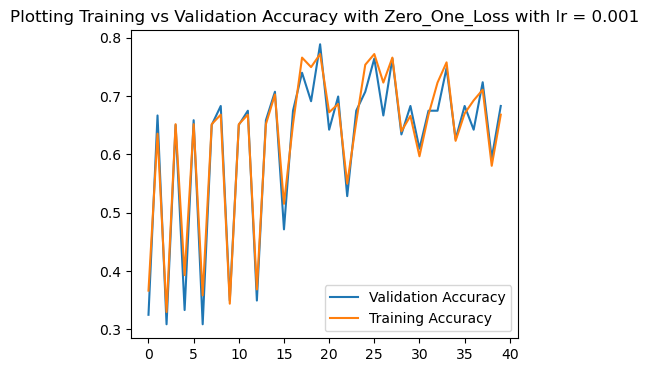

best accuracy:  0.7886178861788617
best weights:  [-0.16795286 -0.44962054  0.13972356 -0.15647245  0.05417783 -0.26069249
 -0.14843722 -0.12068569  0.23587276]


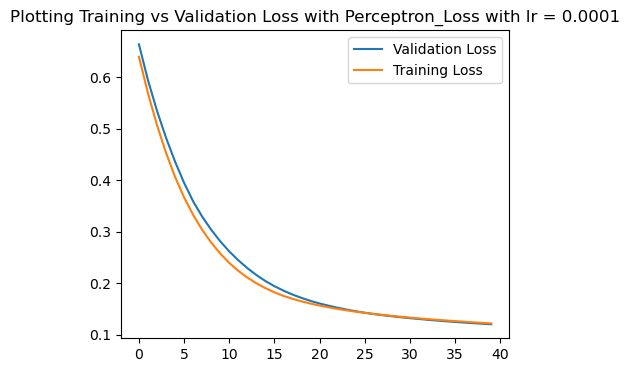

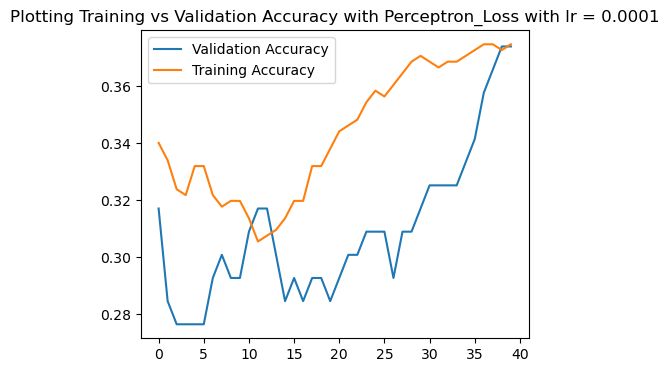

best accuracy:  0.37398373983739835
best weights:  [ 0.23943647  0.20300752  0.23735429 -0.08846133  0.29083447 -0.04182805
 -0.04879944  0.19413168  0.37324348]


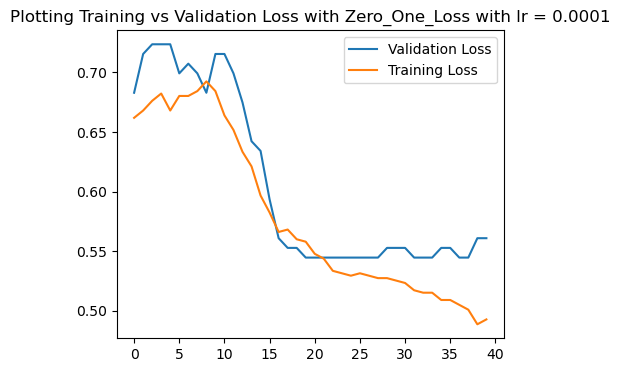

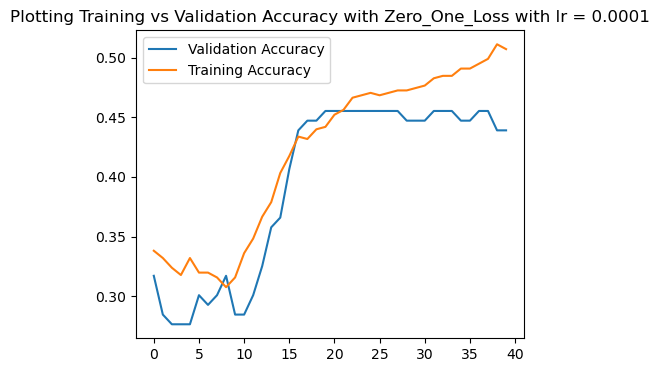

best accuracy:  0.45528455284552843
best weights:  [ 0.1456237   0.04395926  0.17365143 -0.0831026   0.271817   -0.0931345
 -0.03730802  0.09876769  0.33287276]


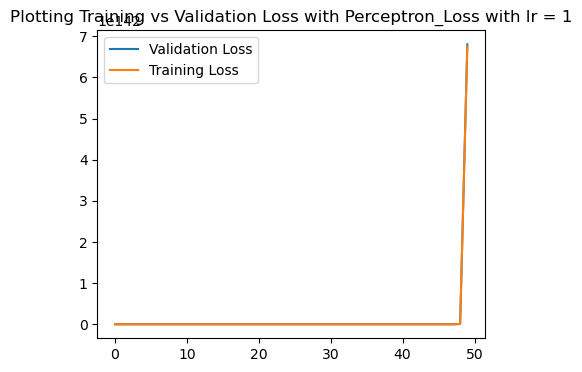

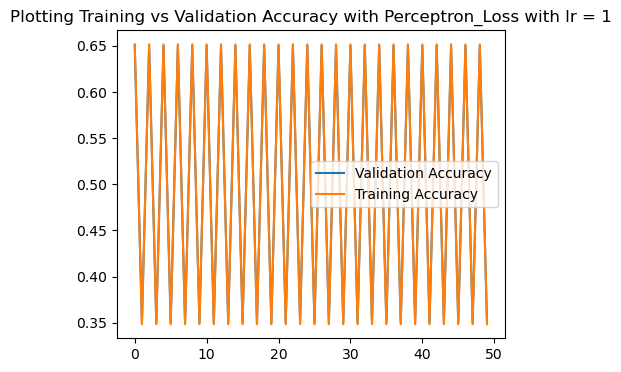

best accuracy:  0.6504065040650406
best weights:  [ 1.58442080e+142 -1.44726526e+142 -5.07643663e+141  1.87651411e+142
  2.56837406e+142 -1.42658561e+141  2.11332476e+142  1.69737270e+142
 -3.30645027e+142]


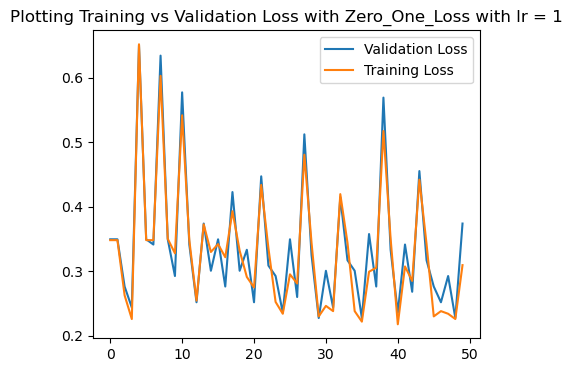

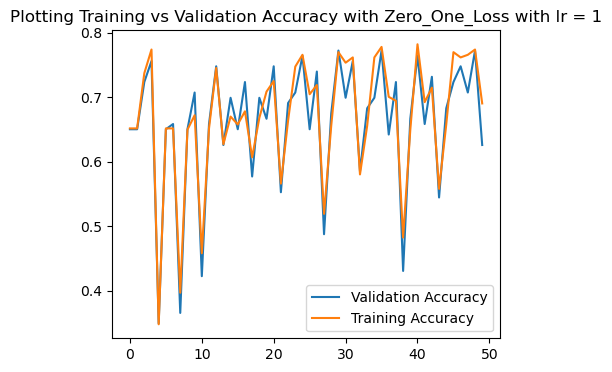

best accuracy:  0.7723577235772358
best weights:  [ -95.79450918 -384.49274933  114.27451983  -31.73152479   85.28975911
 -200.83504045  -73.63650917   -6.21981517  -42.90012724]


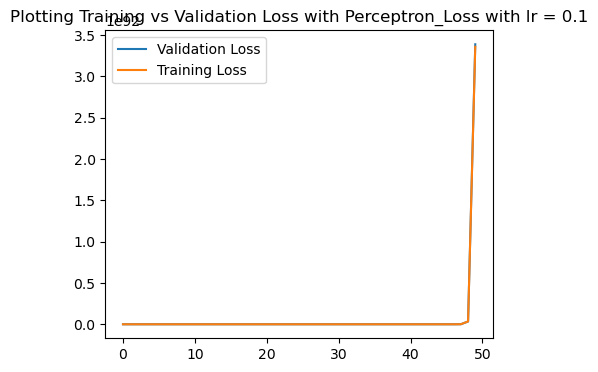

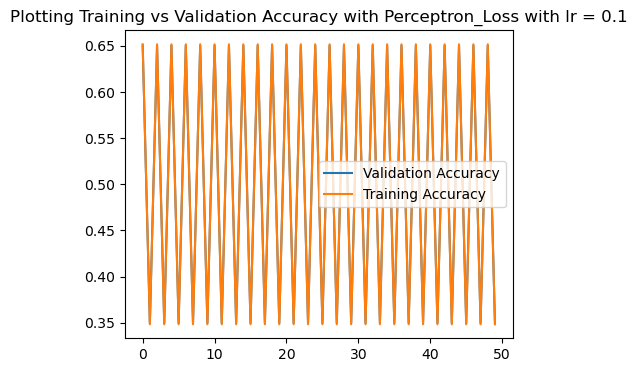

best accuracy:  0.6504065040650406
best weights:  [ 7.86133309e+91 -7.31800185e+91 -2.54189623e+91  9.33980777e+91
  1.27926557e+92 -7.57517229e+90  1.05205349e+92  8.41978396e+91
 -1.64951080e+92]


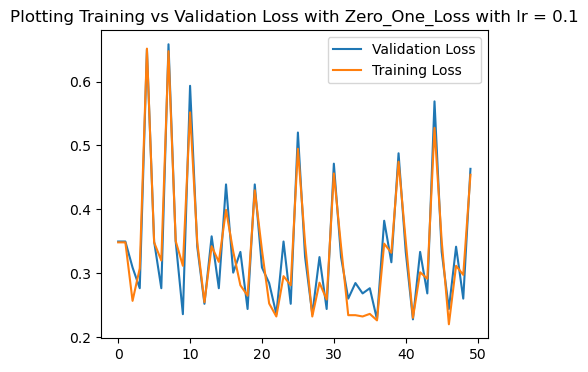

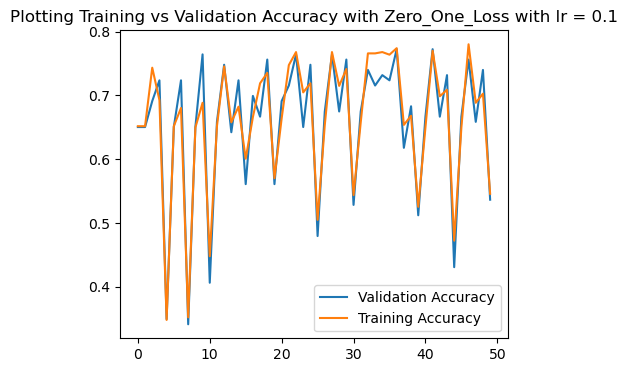

best accuracy:  0.7723577235772358
best weights:  [ -9.23560798 -43.61591595   9.24662723  -2.44552026   9.93437799
 -21.92246664  -5.04177172  -1.13309299  -7.80012724]


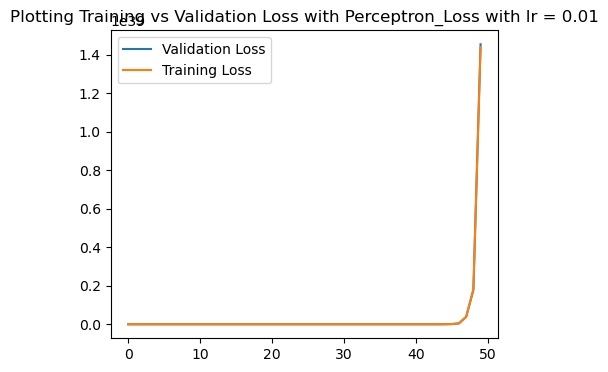

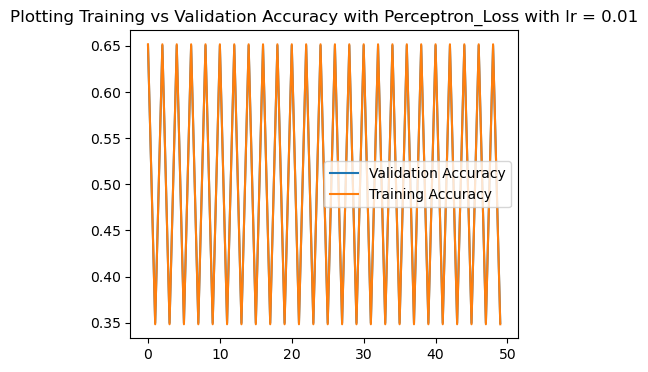

best accuracy:  0.6504065040650406
best weights:  [ 3.19975184e+38 -3.81646626e+38 -1.17219792e+38  3.97780413e+38
  5.50669316e+38 -6.13062195e+37  4.49297860e+38  3.41650026e+38
 -7.25850272e+38]


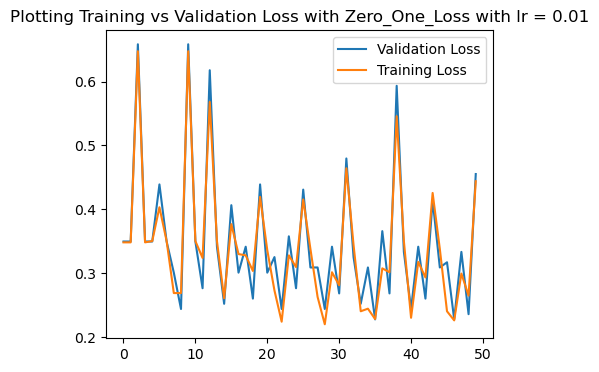

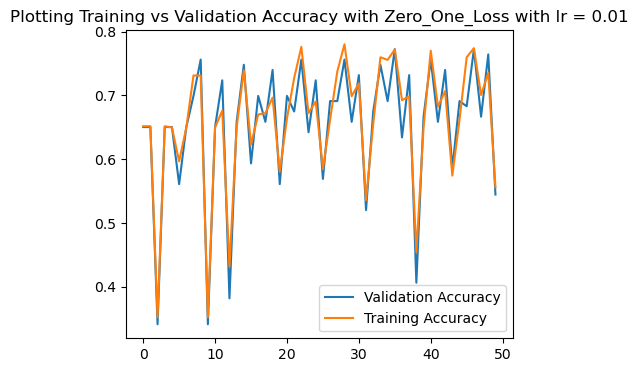

best accuracy:  0.7723577235772358
best weights:  [-0.89383603 -4.35989137  1.05351056 -0.24701942  1.09905301 -2.16697617
 -0.51170902 -0.03708633 -0.61012724]


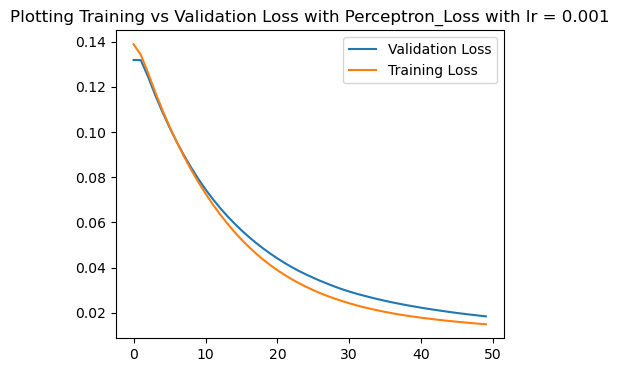

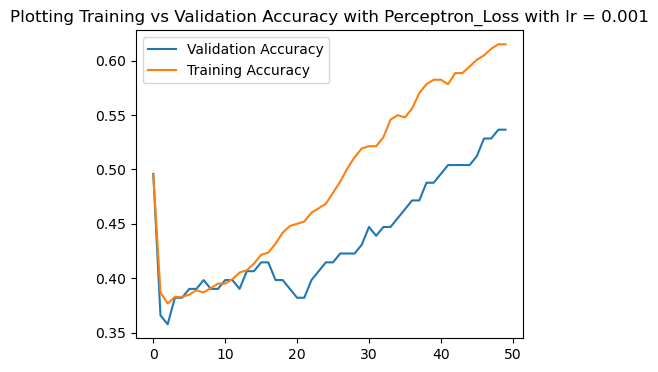

best accuracy:  0.5365853658536586
best weights:  [ 0.04364711 -0.10049808  0.06072597 -0.04341712  0.1941058  -0.09146209
  0.02328838  0.0089926   0.19481607]


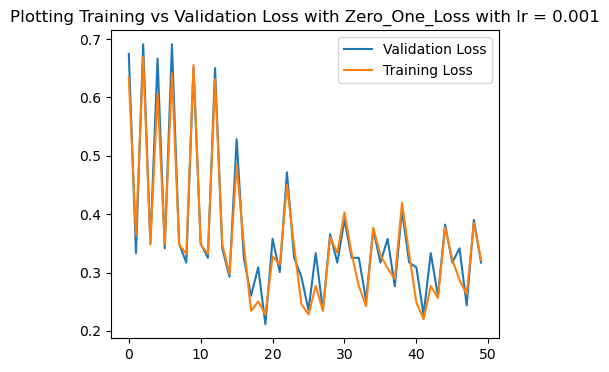

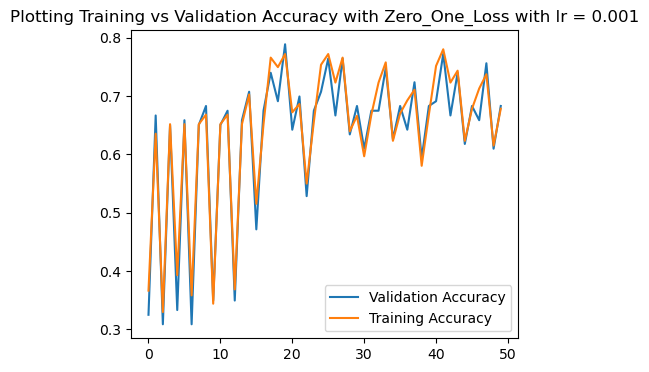

best accuracy:  0.7886178861788617
best weights:  [-0.16436464 -0.44578637  0.14013341 -0.14118963  0.05522506 -0.25596373
 -0.1379086  -0.10318569  0.21087276]


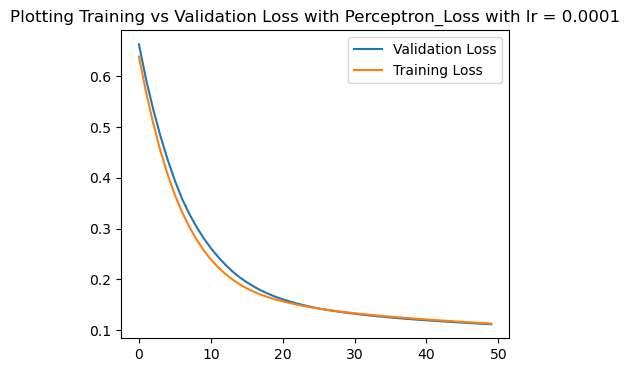

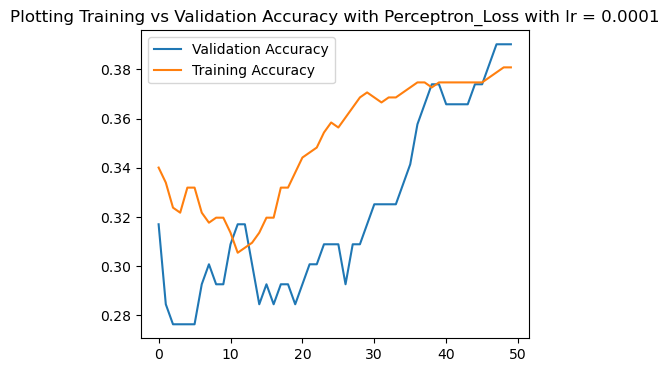

best accuracy:  0.3902439024390244
best weights:  [ 0.22551605  0.18272732  0.22592016 -0.08673738  0.28687034 -0.04721567
 -0.04550781  0.1795434   0.3658048 ]


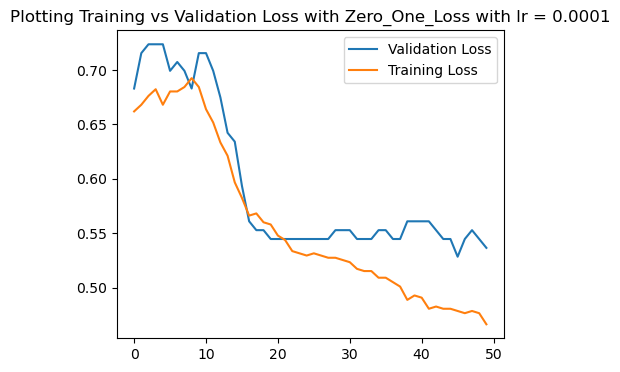

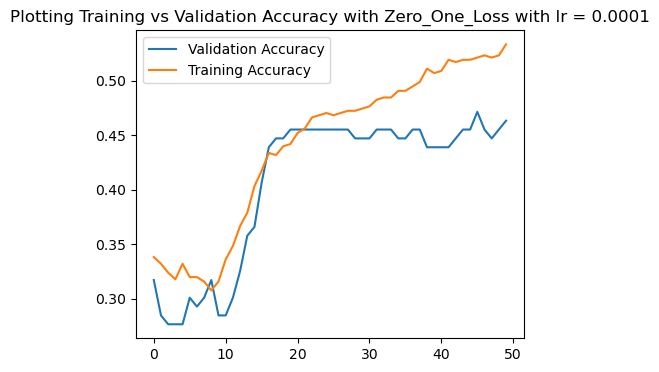

best accuracy:  0.4715447154471545
best weights:  [ 0.11155312 -0.02212615  0.13482683 -0.07222787  0.2710099  -0.10811959
 -0.02057633  0.06400435  0.29747276]


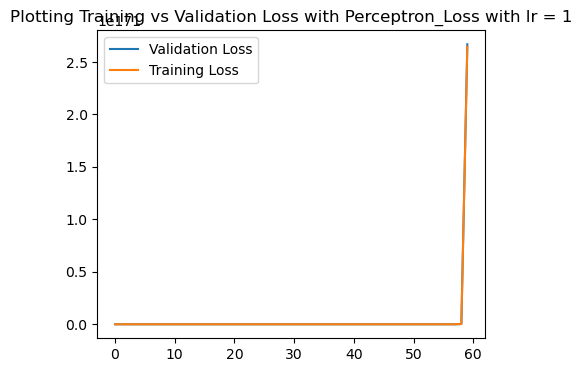

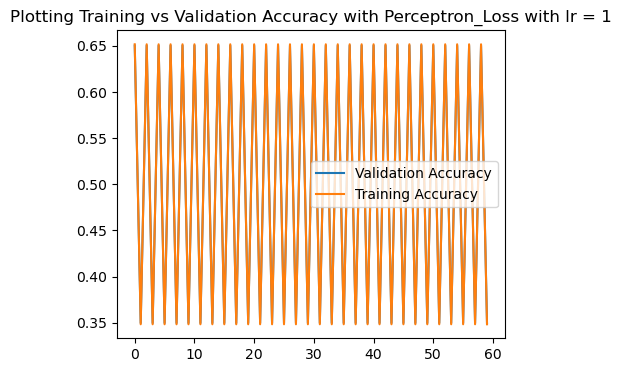

best accuracy:  0.6504065040650406
best weights:  [ 6.21287680e+170 -5.67505852e+170 -1.99058705e+170  7.35824154e+170
  1.00711828e+171 -5.59396886e+169  8.28683036e+170  6.65578706e+170
 -1.29653487e+171]


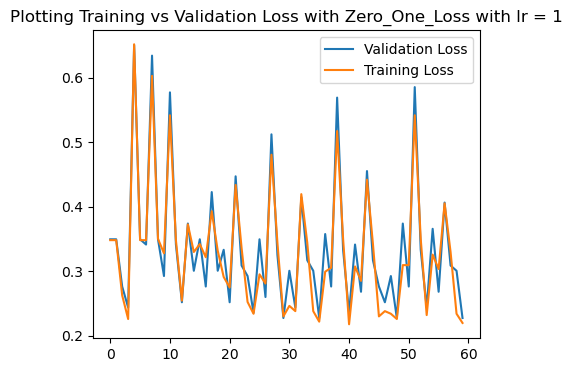

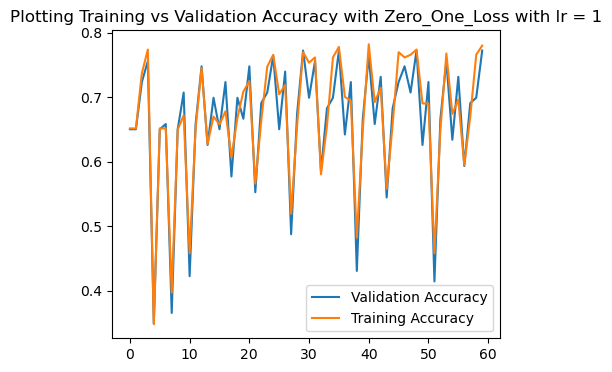

best accuracy:  0.7723577235772358
best weights:  [-139.61806118 -436.83947092  118.97944233  -79.15579029   37.06276441
 -232.48482287 -116.03531595  -56.08649477   10.09987276]


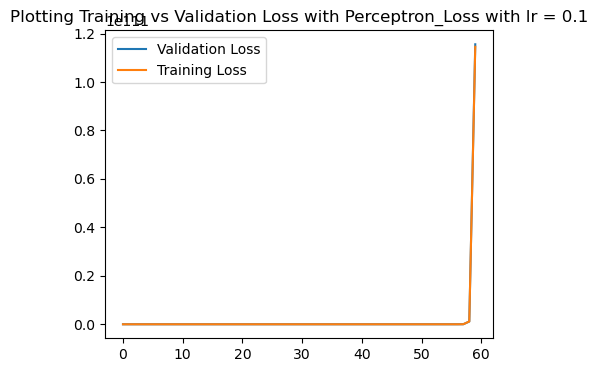

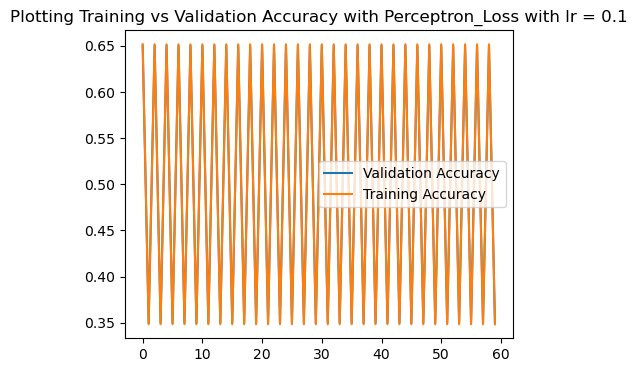

best accuracy:  0.6504065040650406
best weights:  [ 2.68029530e+110 -2.49504833e+110 -8.66651044e+109  3.18437631e+110
  4.36161330e+110 -2.58272973e+109  3.58694127e+110  2.87069726e+110
 -5.62395207e+110]


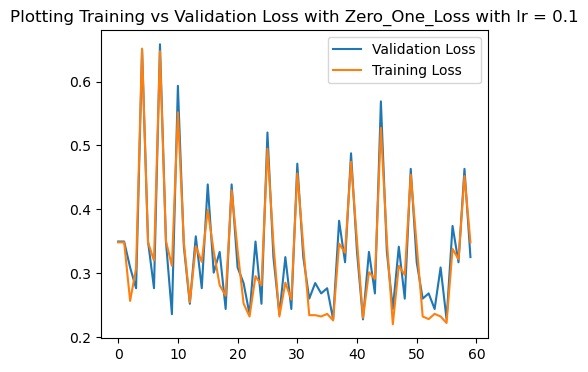

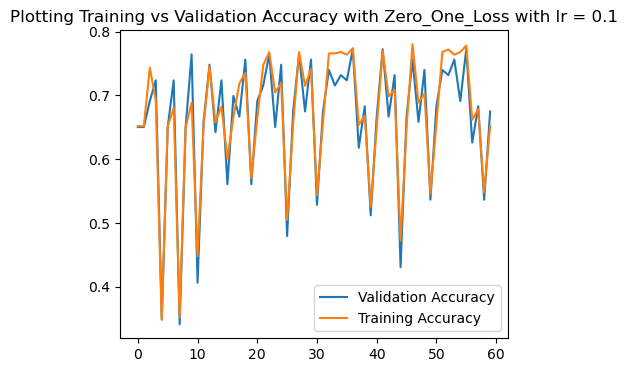

best accuracy:  0.7723577235772358
best weights:  [-19.79443518 -34.46063949  13.66630179 -14.61016527  -6.20155956
 -21.94258603 -20.23254945 -11.83642752  15.49987276]


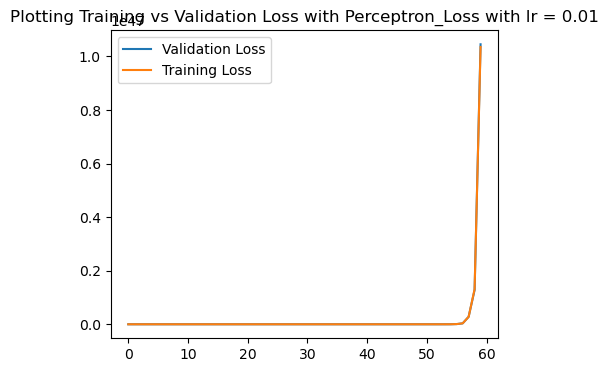

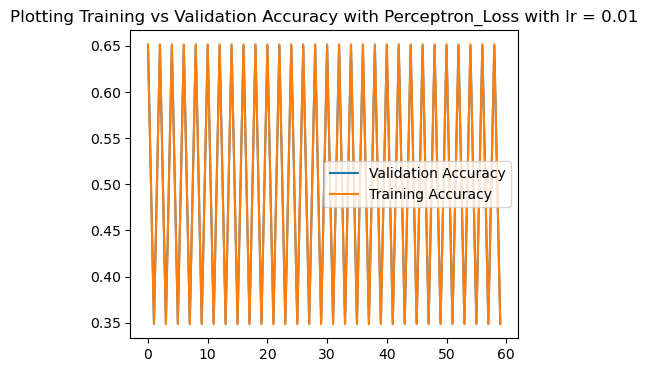

best accuracy:  0.6504065040650406
best weights:  [ 2.29966493e+46 -2.74289822e+46 -8.42459846e+45  2.85885192e+46
  3.95766603e+46 -4.40608429e+45  3.22910833e+46  2.45544225e+46
 -5.21669336e+46]


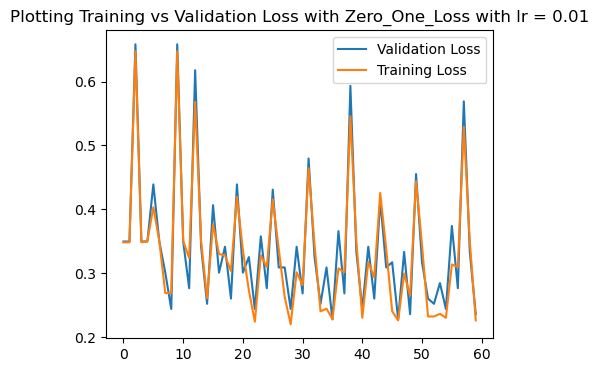

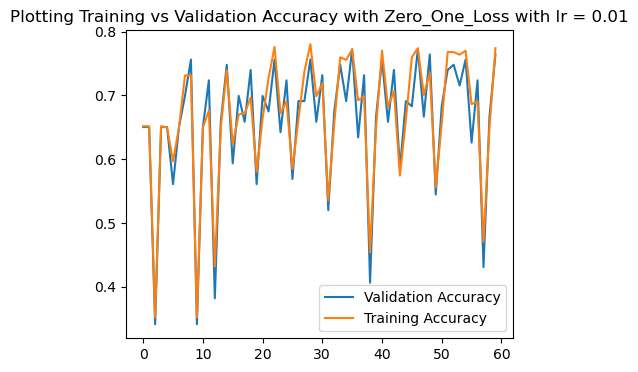

best accuracy:  0.7723577235772358
best weights:  [-1.46324806 -4.34360987  1.19433036 -0.78035289  0.49607387 -2.33725942
 -1.14151265 -0.62675311  0.24987276]


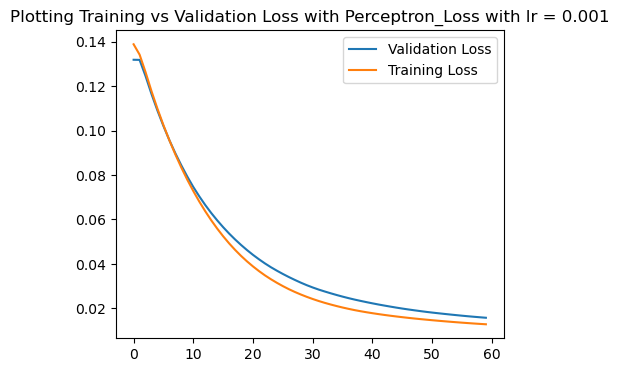

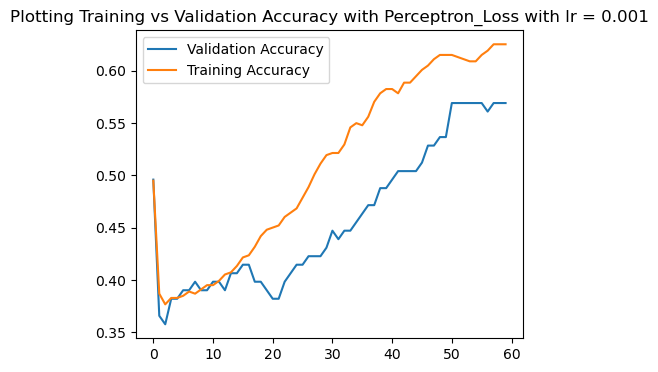

best accuracy:  0.5691056910569106
best weights:  [ 0.03448469 -0.10969967  0.0532395  -0.04024145  0.17920535 -0.08944339
  0.02624543  0.00410674  0.18109527]


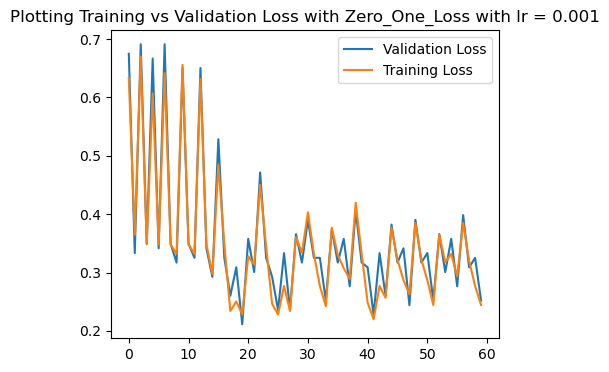

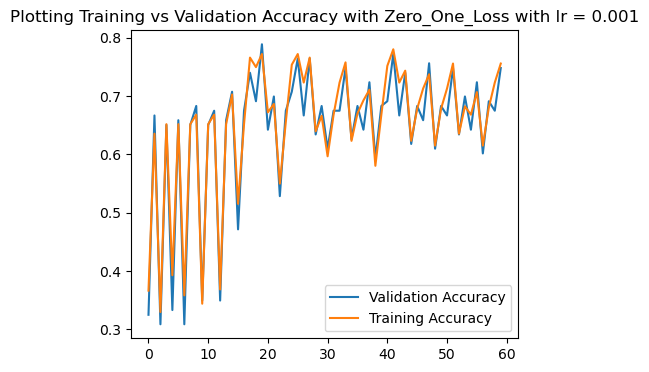

best accuracy:  0.7886178861788617
best weights:  [-0.1374823  -0.48913811  0.13105145 -0.10313914  0.09982549 -0.26034675
 -0.09726727 -0.0669857   0.13587276]


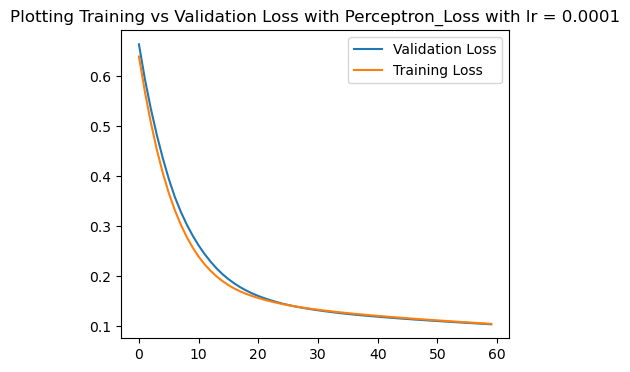

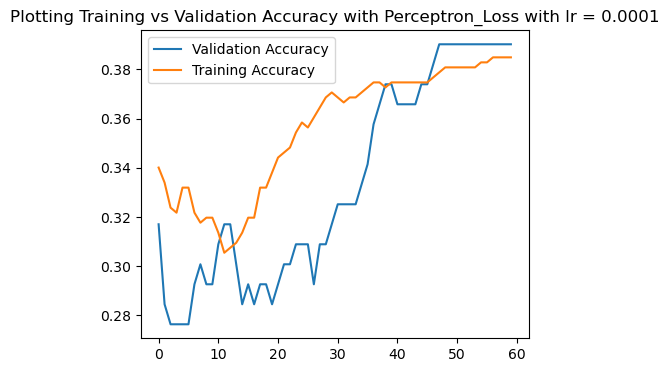

best accuracy:  0.3902439024390244
best weights:  [ 0.21336768  0.16360073  0.21510396 -0.08433679  0.28406439 -0.05201839
 -0.04152407  0.16688936  0.35746328]


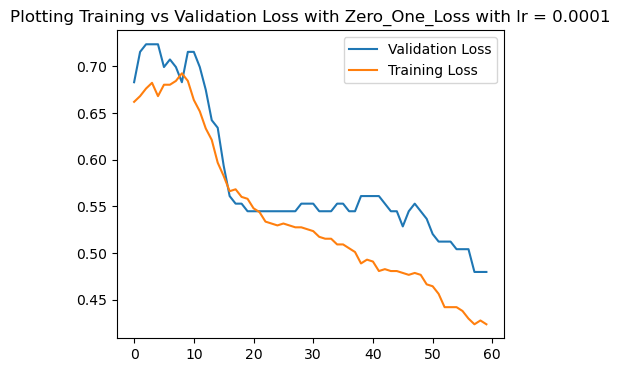

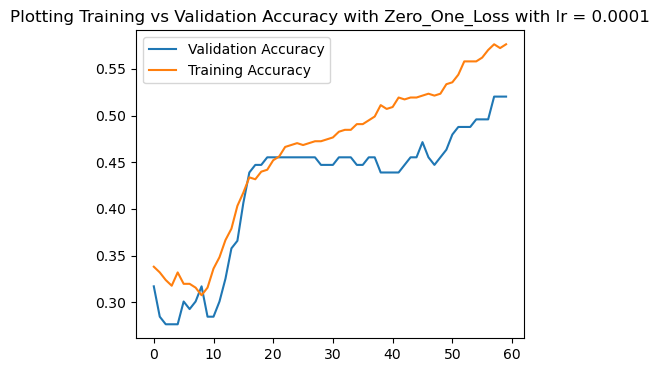

best accuracy:  0.5203252032520326
best weights:  [ 0.07630606 -0.07569097  0.10251371 -0.06309657  0.2659028  -0.11615148
 -0.0082771   0.03260102  0.26587276]


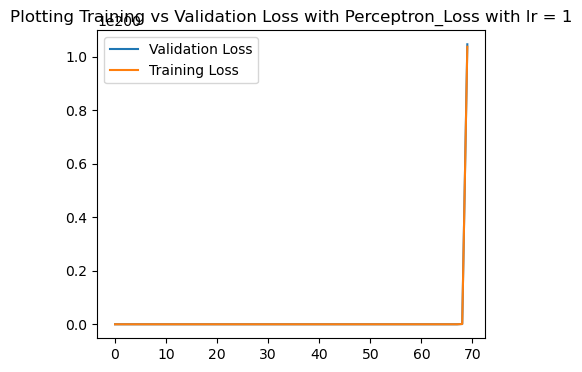

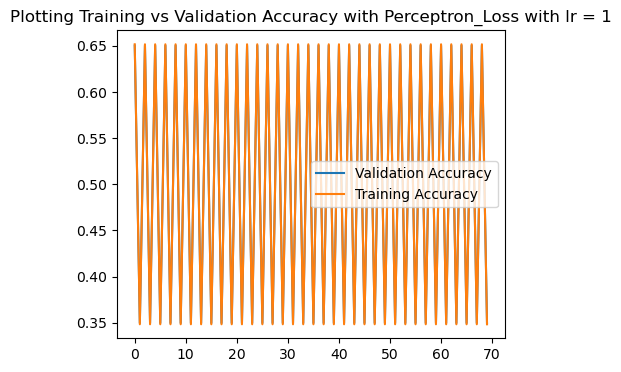

best accuracy:  0.6504065040650406
best weights:  [ 2.43621127e+199 -2.22532041e+199 -7.80554768e+198  2.88533501e+199
  3.94914143e+199 -2.19352329e+198  3.24945595e+199  2.60988652e+199
 -5.08401013e+199]


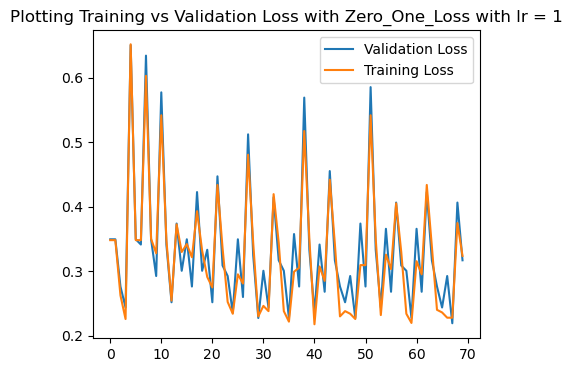

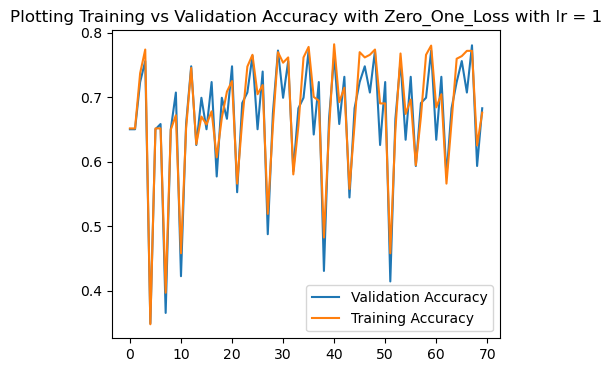

best accuracy:  0.7804878048780488
best weights:  [-171.20632118 -367.24650248  145.88110683 -122.68103019  -21.39354239
 -221.64876338 -178.13267229  -85.38650027  117.09987276]


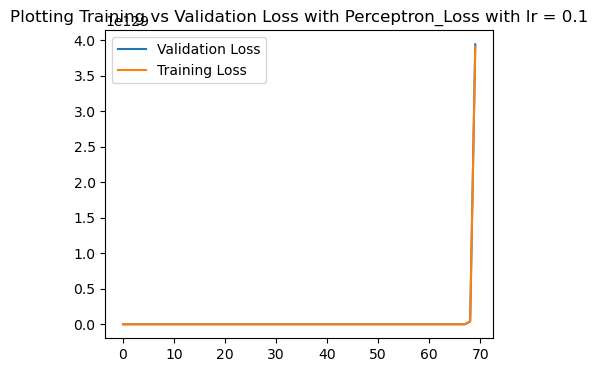

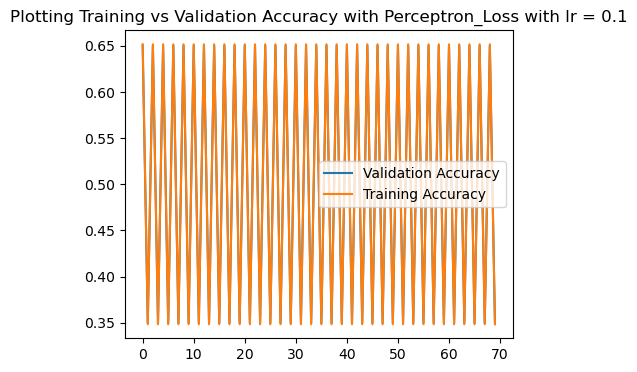

best accuracy:  0.6504065040650406
best weights:  [ 9.13837744e+128 -8.50678405e+128 -2.95481783e+128  1.08570248e+129
  1.48707751e+129 -8.80573087e+127  1.22295566e+129  9.78754658e+128
 -1.91746770e+129]


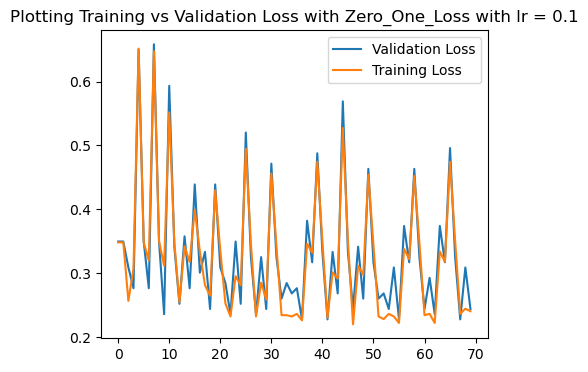

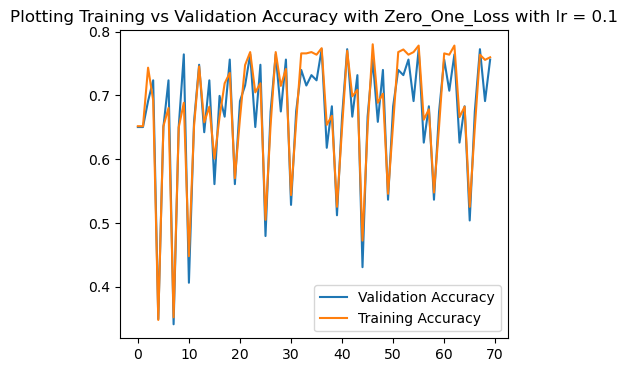

best accuracy:  0.7723577235772358
best weights:  [-13.28855293 -37.68475829  12.16466339  -7.12531853   4.18425194
 -21.96881702 -12.21675139  -4.47309424   3.49987276]


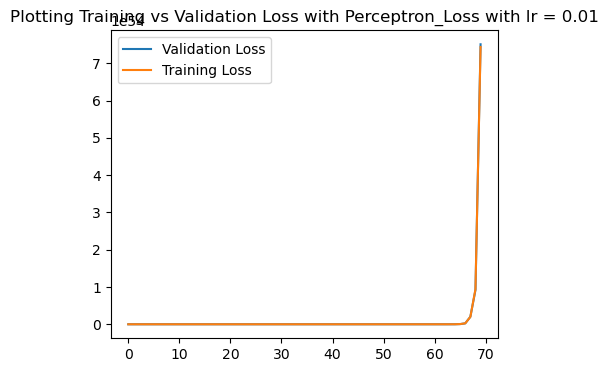

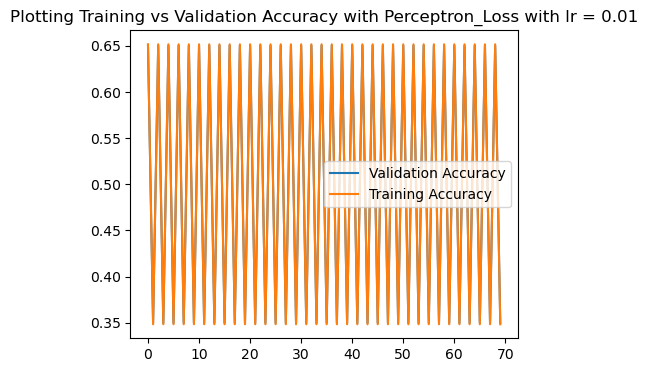

best accuracy:  0.6504065040650406
best weights:  [ 1.65277155e+54 -1.97132377e+54 -6.05476757e+53  2.05465981e+54
  2.84437864e+54 -3.16665731e+53  2.32076347e+54  1.76472887e+54
 -3.74924288e+54]


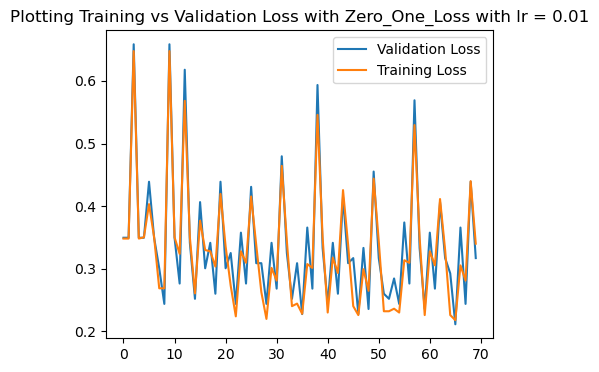

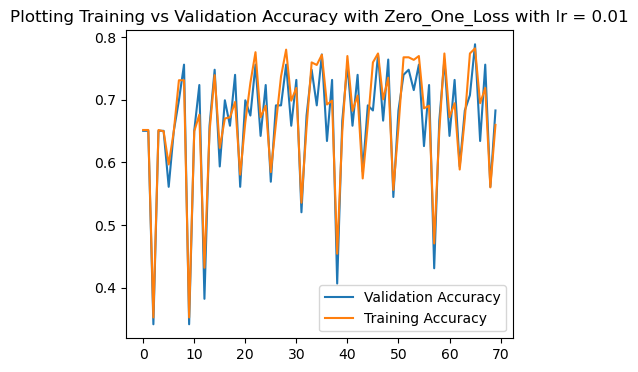

best accuracy:  0.7886178861788617
best weights:  [-1.97854247 -3.98742888  1.44810102 -1.49045389 -0.40118423 -2.37392114
 -1.94253744 -1.21075322  1.50987276]


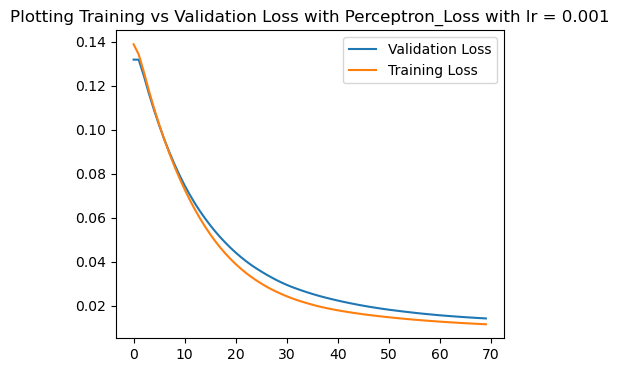

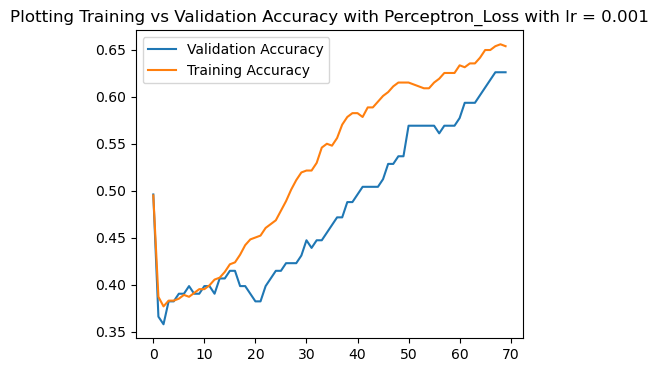

best accuracy:  0.6260162601626016
best weights:  [ 0.02778991 -0.11507506  0.04807956 -0.03753936  0.16602974 -0.08725353
  0.02796473  0.00156719  0.16985398]


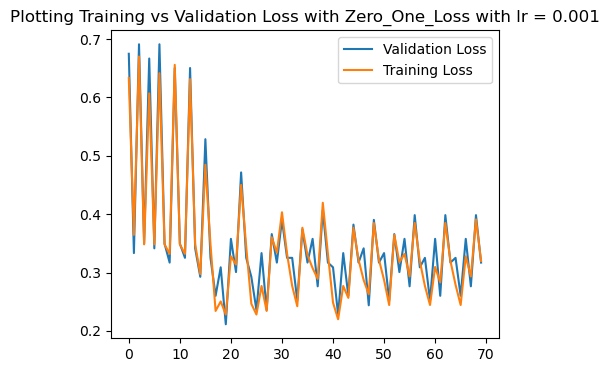

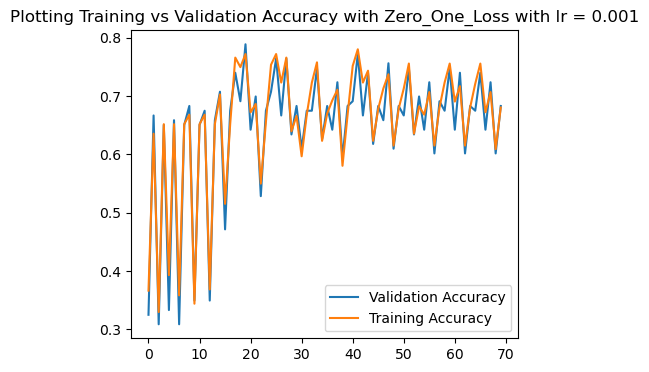

best accuracy:  0.7886178861788617
best weights:  [-0.17307056 -0.46293207  0.14775639 -0.13937146  0.04115406 -0.25923348
 -0.14314003 -0.09998571  0.19887276]


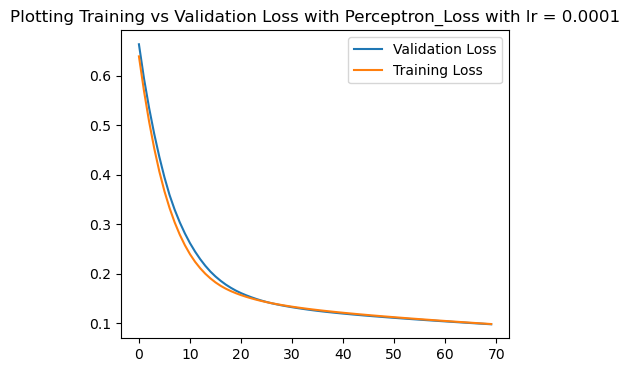

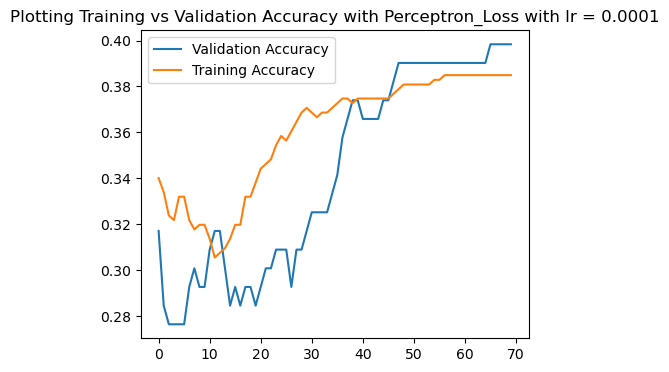

best accuracy:  0.3983739837398374
best weights:  [ 0.20231701  0.14569829  0.20494721 -0.08183126  0.28162391 -0.05635443
 -0.03749372  0.15542661  0.34914081]


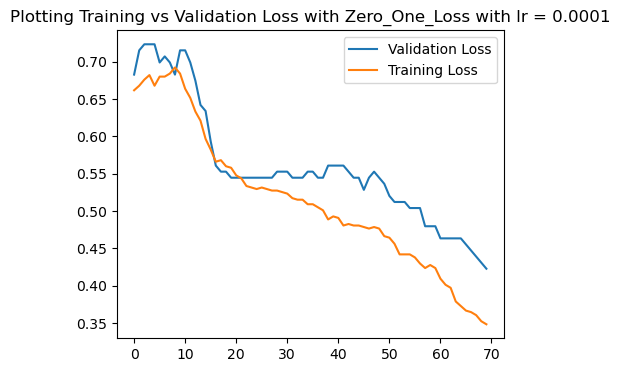

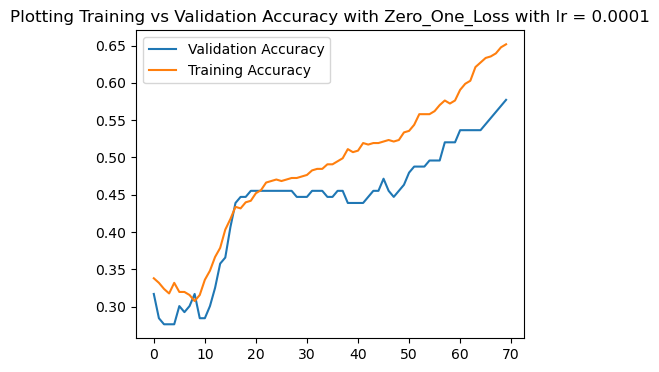

best accuracy:  0.5772357723577236
best weights:  [ 0.04860606 -0.10737489  0.08040059 -0.0578895   0.25515149 -0.11691408
 -0.00067052  0.01200435  0.24077276]


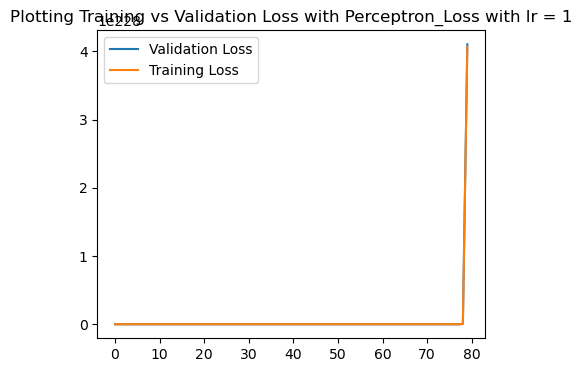

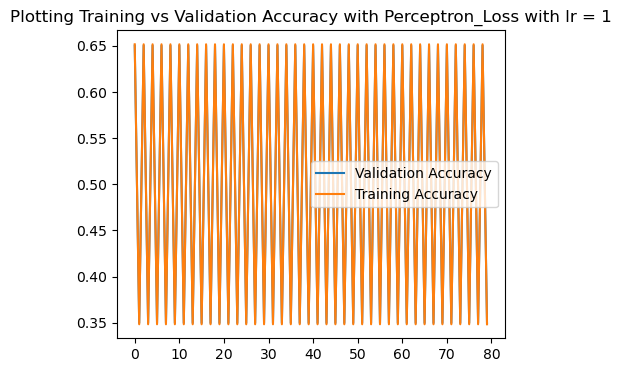

best accuracy:  0.6504065040650406
best weights:  [ 9.55294228e+227 -8.72599091e+227 -3.06073399e+227  1.13140593e+228
  1.54854879e+228 -8.60130716e+226  1.27418609e+228  1.02339627e+228
 -1.99355680e+228]


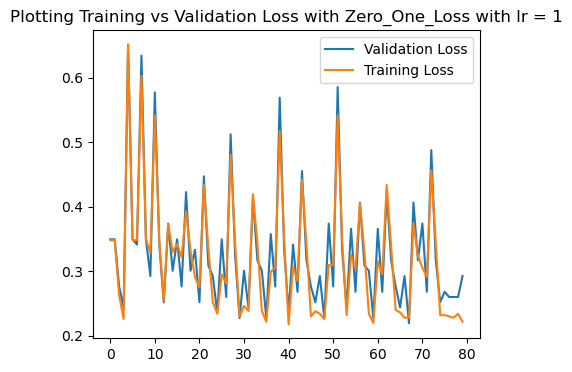

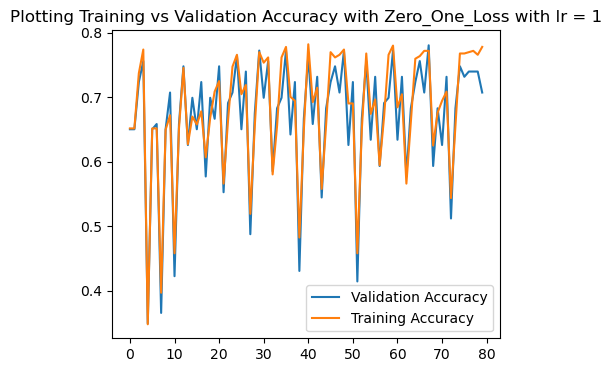

best accuracy:  0.7804878048780488
best weights:  [ -99.02984968 -362.32689641  129.25816823  -39.03457469   99.41965401
 -215.14058112  -90.20611717   -3.18650187    2.09987276]


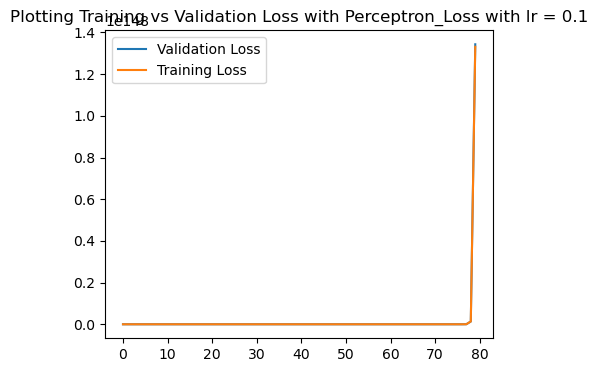

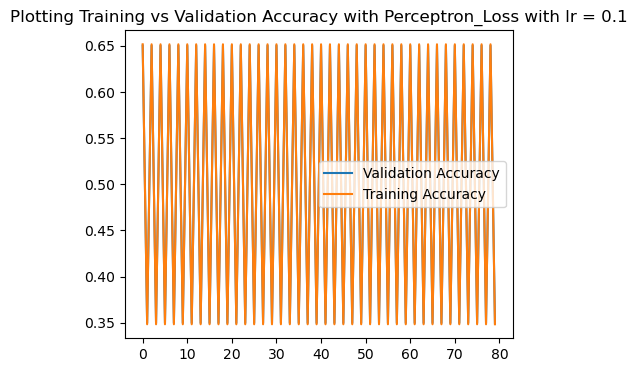

best accuracy:  0.6504065040650406
best weights:  [ 3.11569931e+147 -2.90035965e+147 -1.00743529e+147  3.70166641e+147
  5.07014117e+147 -3.00228457e+146  4.16962655e+147  3.33703137e+147
 -6.53754219e+147]


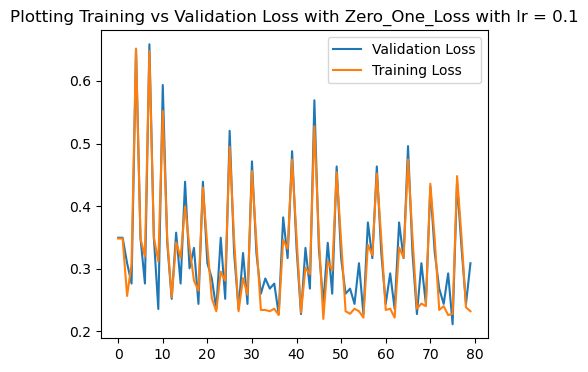

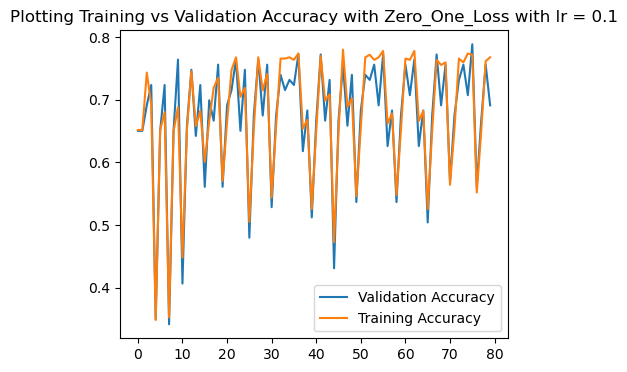

best accuracy:  0.7886178861788617
best weights:  [-10.20031858 -37.69932956  11.71220608  -4.15461277   8.4729004
 -22.14512232  -8.88814378  -1.65642792  -1.00012724]


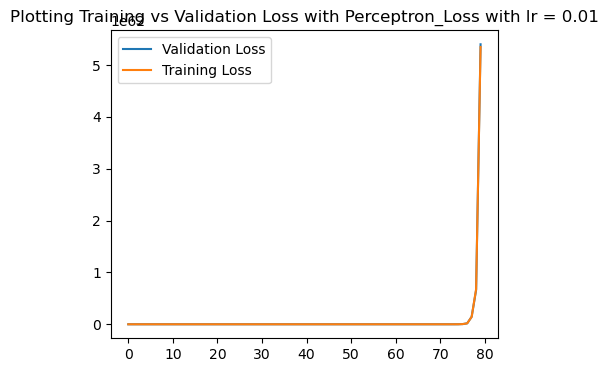

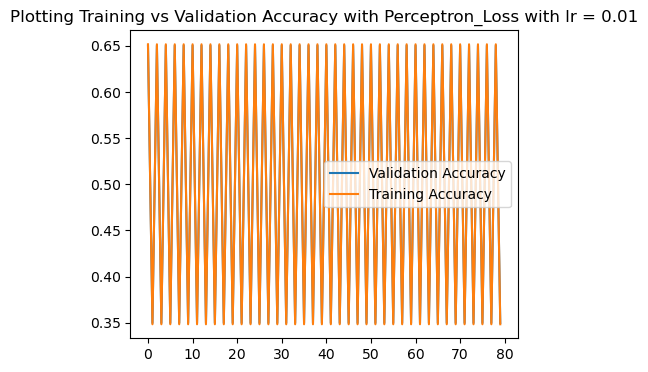

best accuracy:  0.6504065040650406
best weights:  [ 1.18784861e+62 -1.41679242e+62 -4.35156767e+61  1.47668611e+62
  2.04425785e+62 -2.27587986e+61  1.66793509e+62  1.26831245e+62
 -2.69458471e+62]


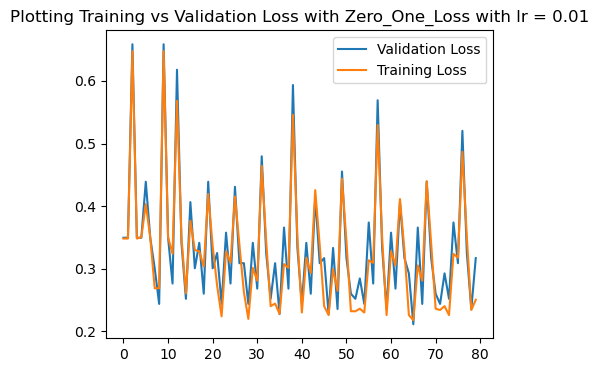

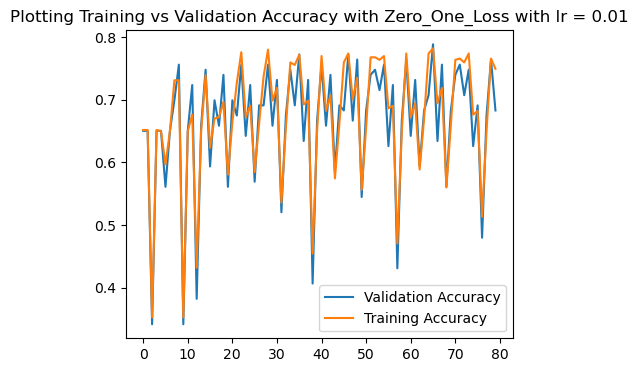

best accuracy:  0.7886178861788617
best weights:  [-1.11030714 -4.37175034  1.21433063 -0.44196926  1.03734964 -2.38623132
 -0.82148711 -0.2114199  -0.17012724]


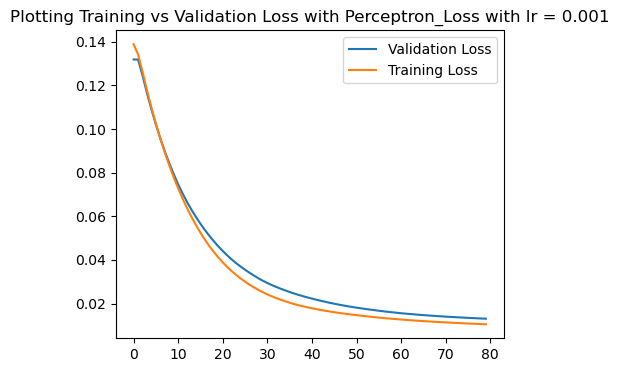

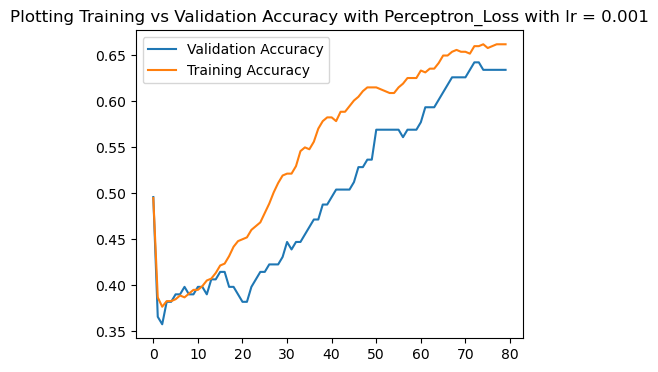

best accuracy:  0.6422764227642277
best weights:  [ 0.0226673  -0.11802766  0.04435084 -0.03513178  0.1543712  -0.08497969
  0.02894168  0.0004376   0.16023058]


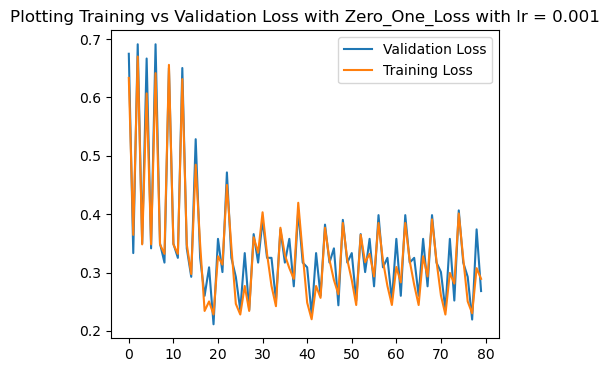

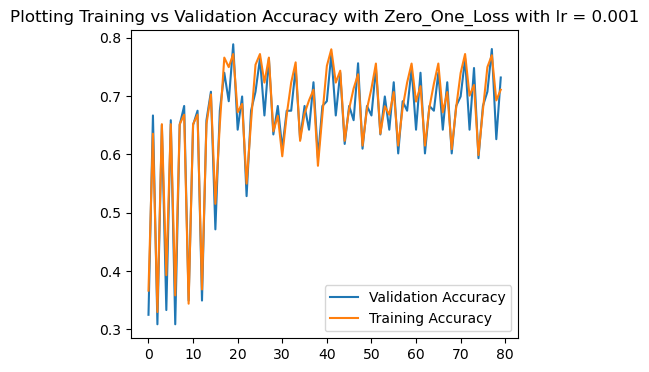

best accuracy:  0.7886178861788617
best weights:  [-0.14807058 -0.45038433  0.14442853 -0.1106745   0.06992706 -0.25155987
 -0.11968998 -0.06825238  0.15987276]


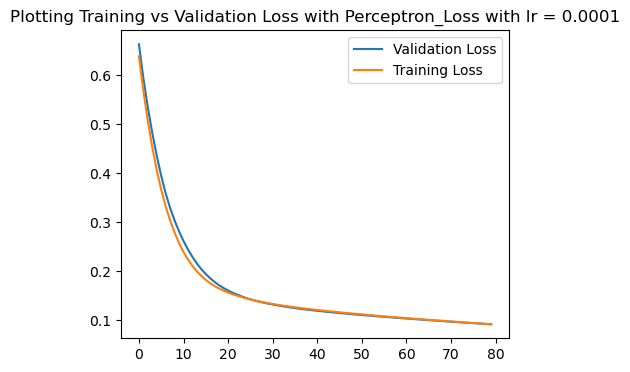

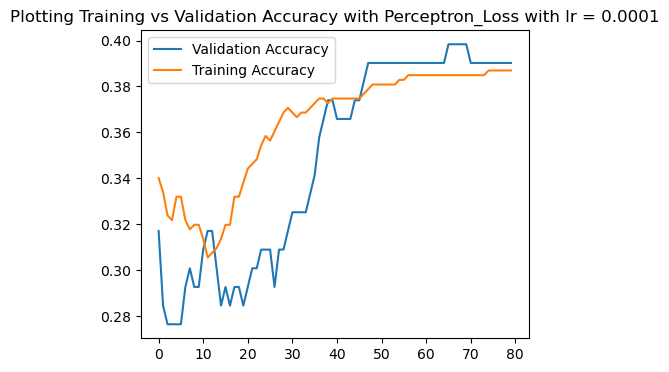

best accuracy:  0.3983739837398374
best weights:  [ 0.19210443  0.12898763  0.19543308 -0.07940283  0.27928789 -0.06028325
 -0.03361945  0.14487085  0.34112281]


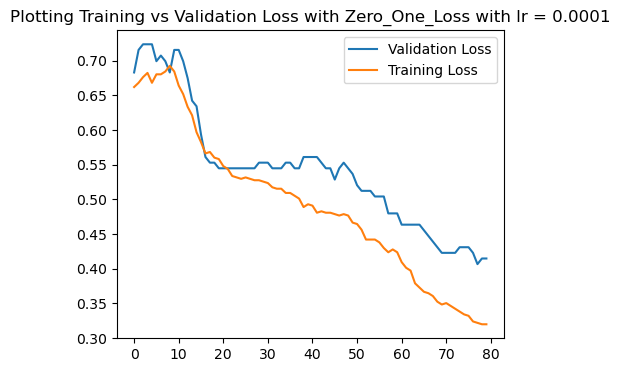

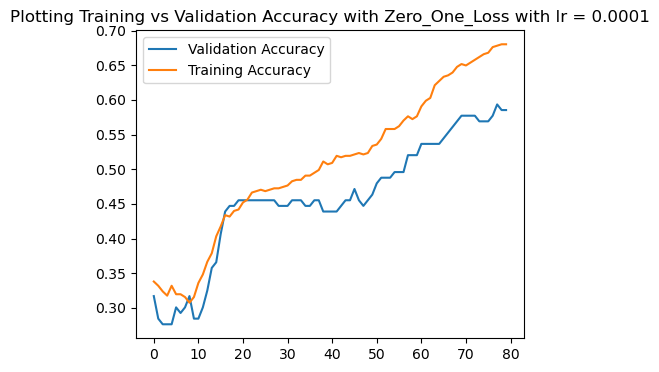

best accuracy:  0.5934959349593496
best weights:  [ 0.03178253 -0.12539096  0.06461698 -0.05604507  0.24003967 -0.1151874
  0.00371847  0.00506102  0.22097276]


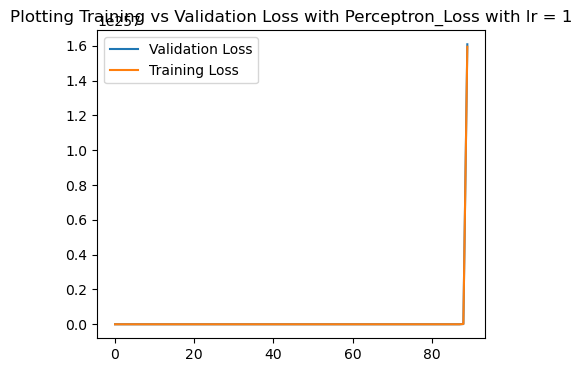

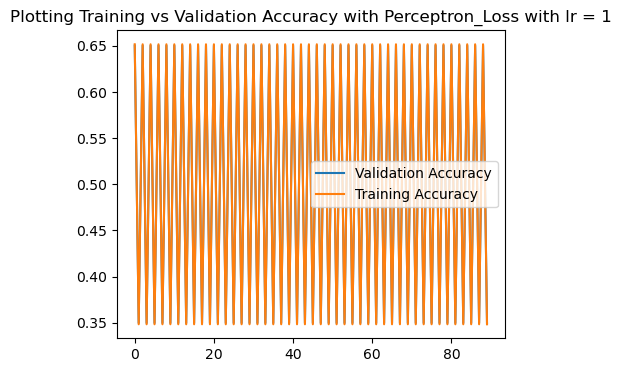

best accuracy:  0.6504065040650406
best weights:  [ 3.74592743e+256 -3.42166086e+256 -1.20018389e+256  4.43650176e+256
  6.07221442e+256 -3.37276951e+255  4.99637546e+256  4.01297115e+256
 -7.81719272e+256]


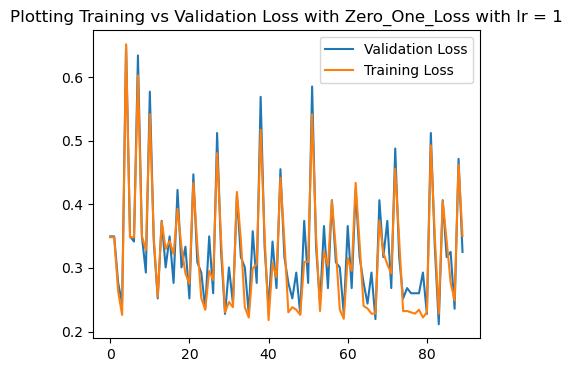

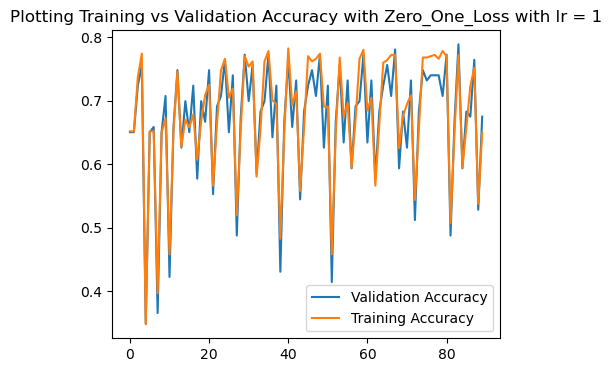

best accuracy:  0.7886178861788617
best weights:  [-202.20635518 -353.56306552  137.15982393 -146.46892429  -50.39126309
 -230.18081876 -203.06862995 -124.68651697  166.09987276]


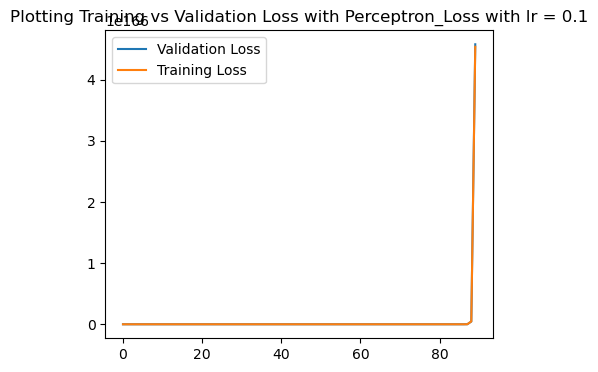

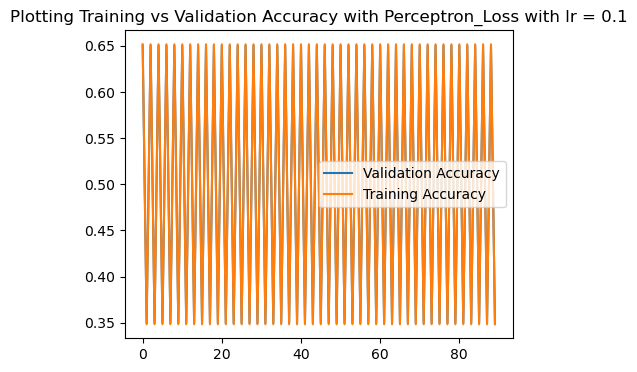

best accuracy:  0.6504065040650406
best weights:  [ 1.06228729e+166 -9.88867951e+165 -3.43481701e+165  1.26207082e+166
  1.72864772e+166 -1.02361891e+165  1.42162027e+166  1.13774972e+166
 -2.22895321e+166]


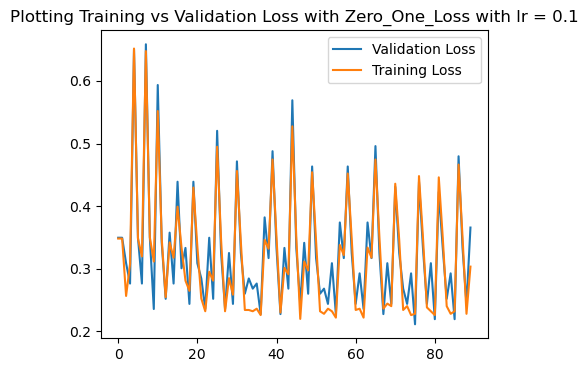

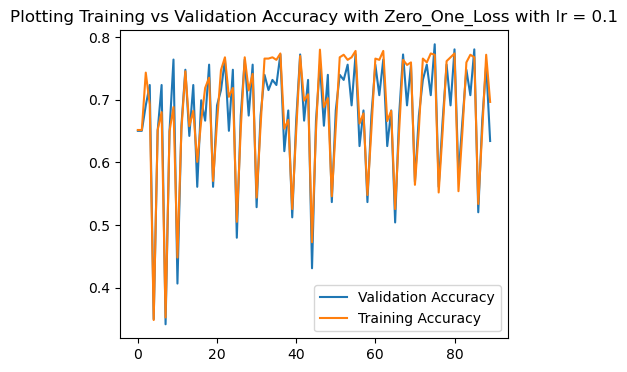

best accuracy:  0.7886178861788617
best weights:  [ -9.37090828 -37.25560961  11.18761749  -2.82027063   9.61686791
 -22.19743357  -7.26764888  -0.84642849  -2.70012724]


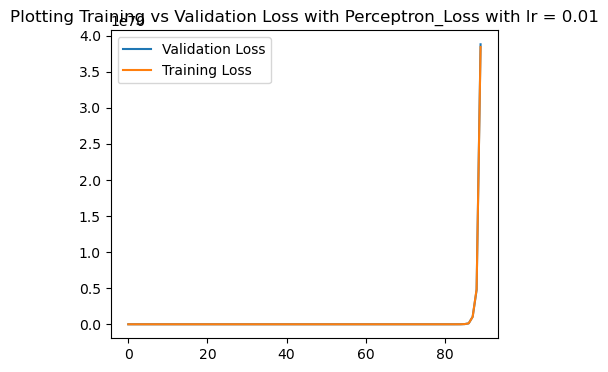

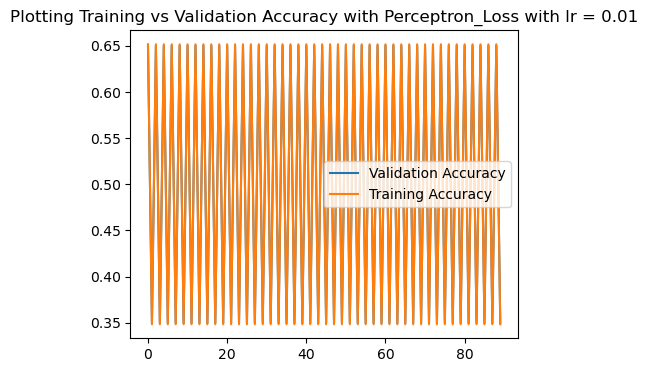

best accuracy:  0.6504065040650406
best weights:  [ 8.53708015e+69 -1.01825016e+70 -3.12747615e+69  1.06129583e+70
  1.46921022e+70 -1.63567719e+69  1.19874666e+70  9.11537459e+69
 -1.93660080e+70]


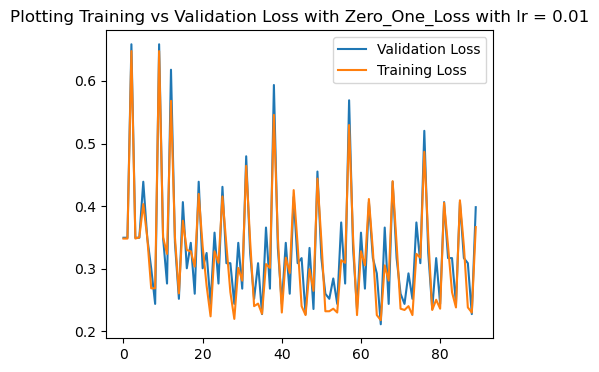

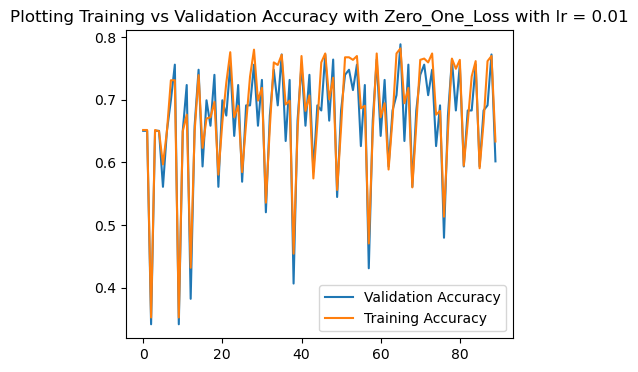

best accuracy:  0.7886178861788617
best weights:  [-0.93207198 -4.30345875  1.17974062 -0.29358543  1.17976058 -2.33819858
 -0.67660241 -0.03541993 -0.30012724]


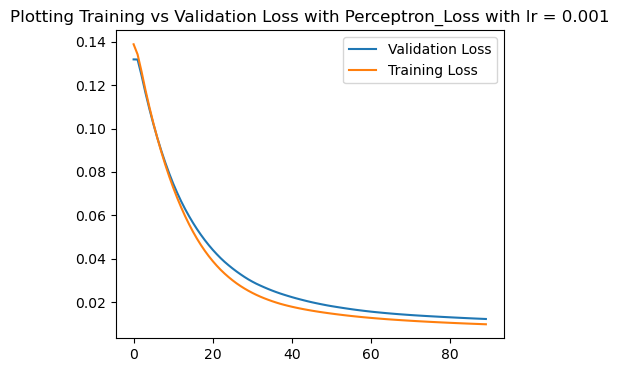

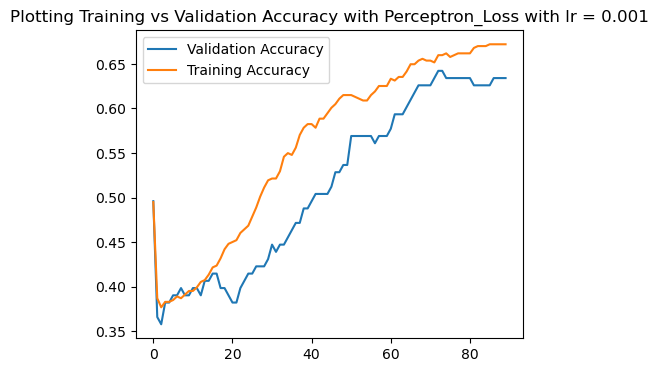

best accuracy:  0.6422764227642277
best weights:  [ 1.85830185e-02 -1.19341189e-01  4.15269237e-02 -3.29337782e-02
  1.43999497e-01 -8.26980443e-02  2.94187185e-02  1.02988689e-04
  1.51774019e-01]


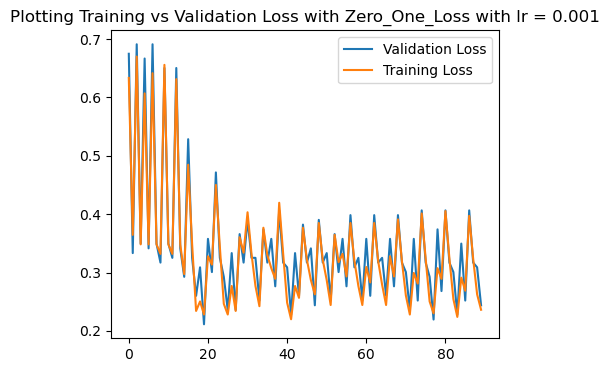

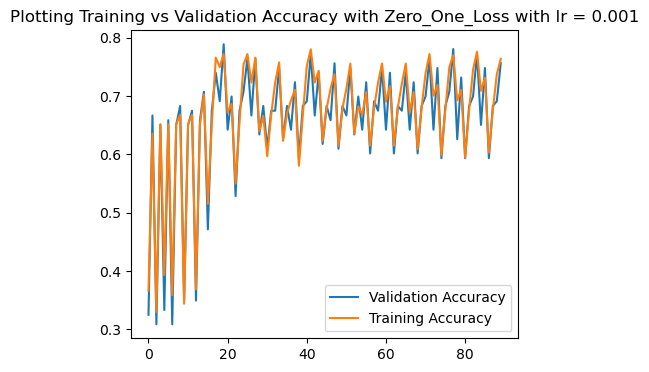

best accuracy:  0.7886178861788617
best weights:  [-0.13636471 -0.46753507  0.1340351  -0.08941188  0.09042583 -0.25219325
 -0.09805121 -0.05495239  0.11887276]


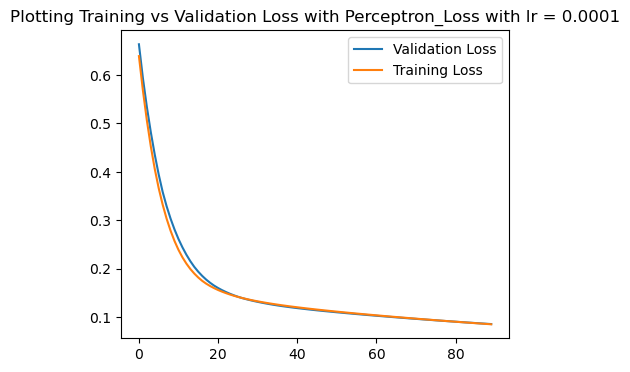

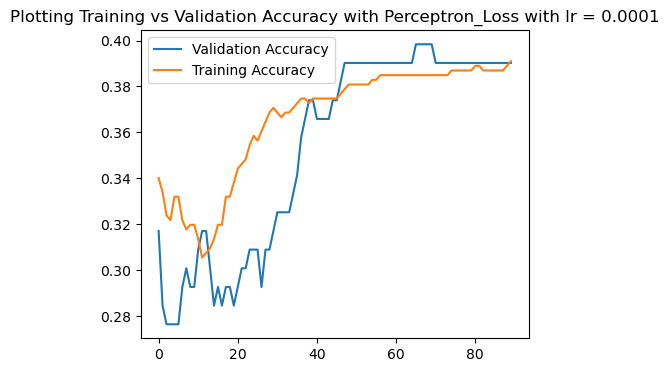

best accuracy:  0.3983739837398374
best weights:  [ 0.18260719  0.11340639  0.18652708 -0.07710844  0.27696876 -0.06384359
 -0.02996228  0.1350873   0.33349013]


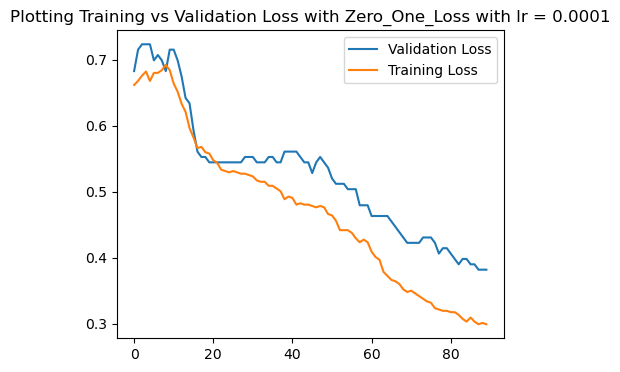

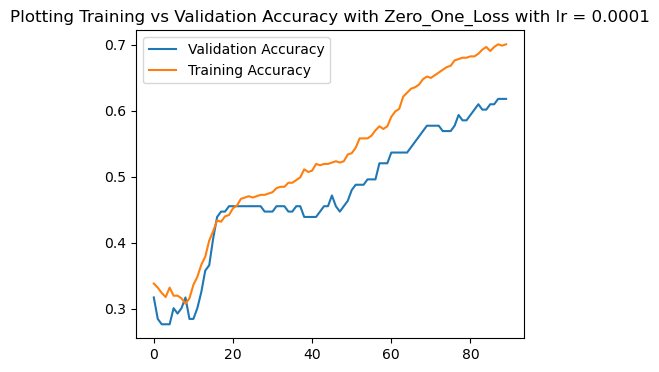

best accuracy:  0.6178861788617886
best weights:  [ 0.01844724 -0.13702362  0.0538678  -0.05471477  0.22389758 -0.11168263
  0.00676791  0.00356436  0.20447276]


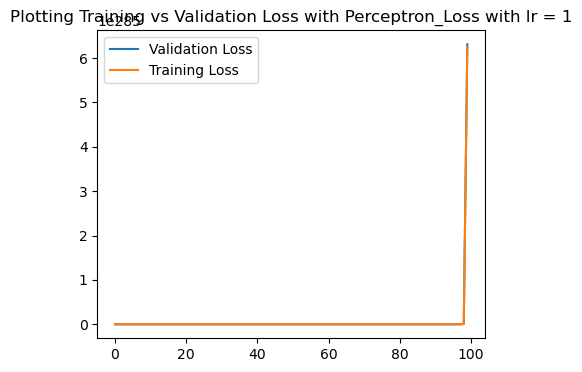

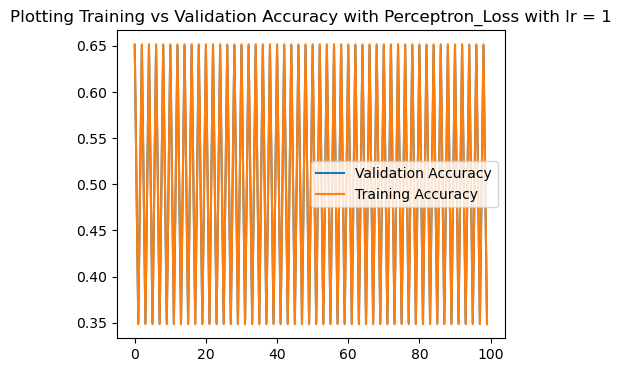

best accuracy:  0.6504065040650406
best weights:  [ 1.46886393e+285 -1.34171158e+285 -4.70619588e+284  1.73965394e+285
  2.38105433e+285 -1.32254016e+284  1.95919323e+285  1.57357788e+285
 -3.06530028e+285]


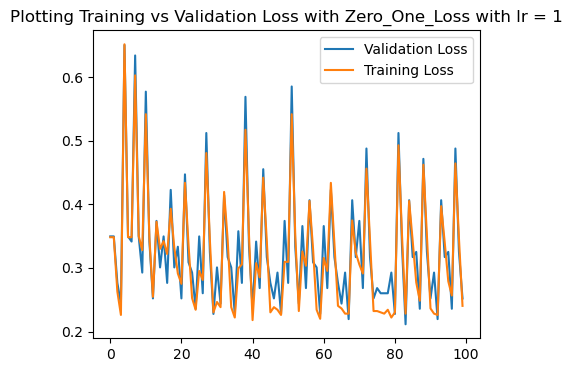

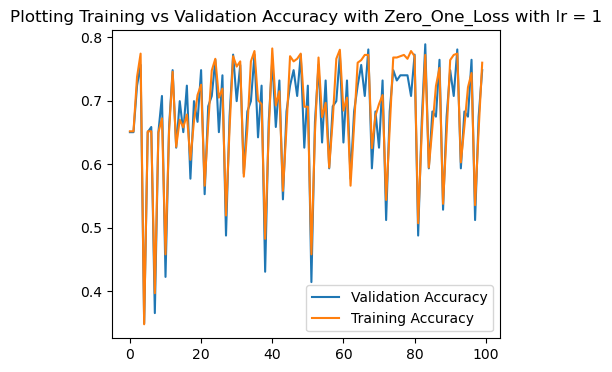

best accuracy:  0.7886178861788617
best weights:  [-130.20635268 -439.9349046   109.27458153  -56.36794549   75.50467321
 -241.45653855 -100.34019447  -47.21985707   -3.90012724]


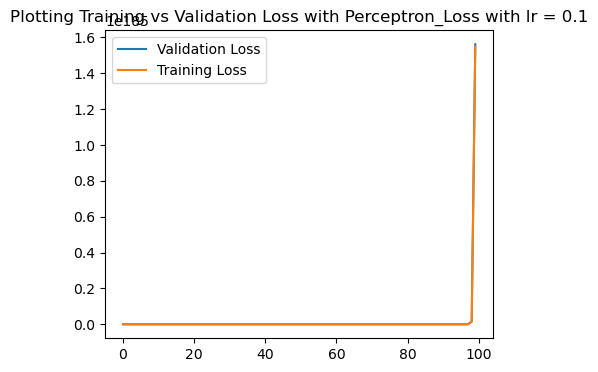

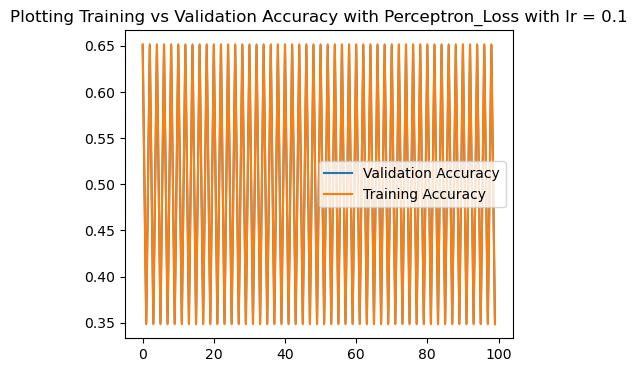

best accuracy:  0.6504065040650406
best weights:  [ 3.62183309e+184 -3.37151230e+184 -1.17108940e+184  4.30298836e+184
  5.89376676e+184 -3.48999455e+183  4.84696689e+184  3.87911971e+184
 -7.59954162e+184]


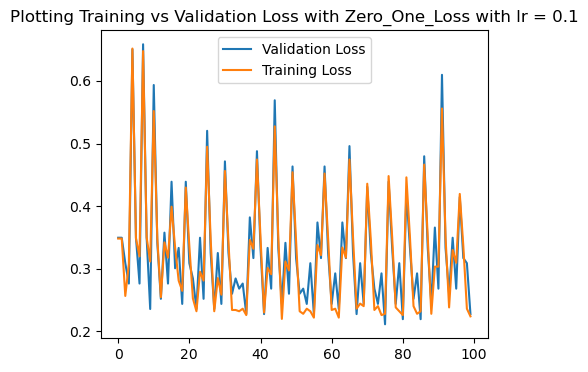

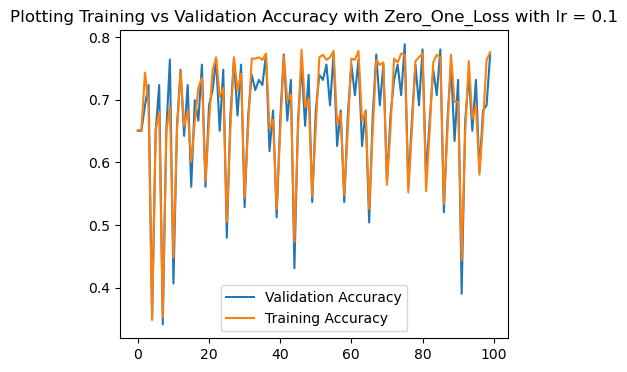

best accuracy:  0.7886178861788617
best weights:  [-13.64738098 -43.89932697  11.56138858  -6.91017207   5.28353034
 -24.92157743 -10.87243116  -5.47309672   1.39987276]


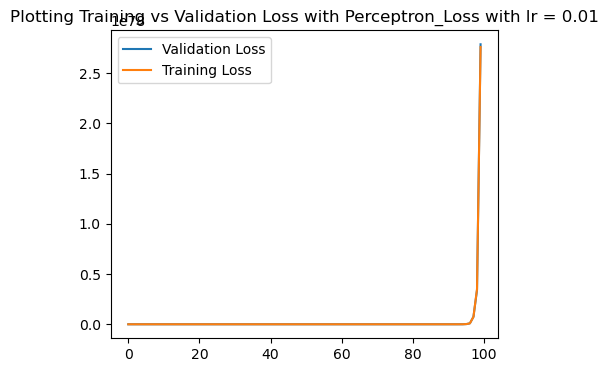

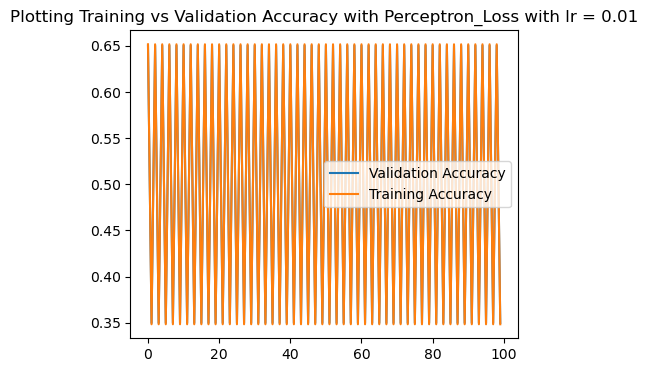

best accuracy:  0.6504065040650406
best weights:  [ 6.13560827e+77 -7.31817439e+77 -2.24772032e+77  7.62754401e+77
  1.05592289e+78 -1.17556288e+77  8.61540459e+77  6.55122908e+77
 -1.39183698e+78]


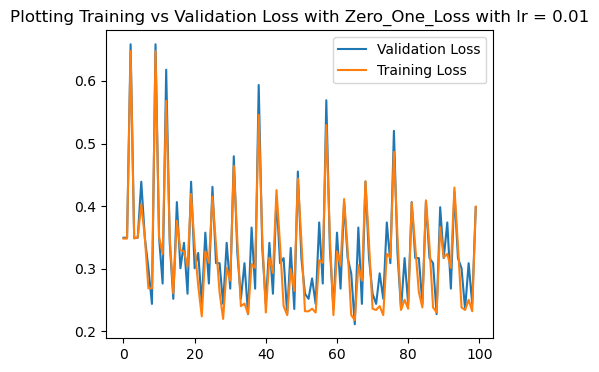

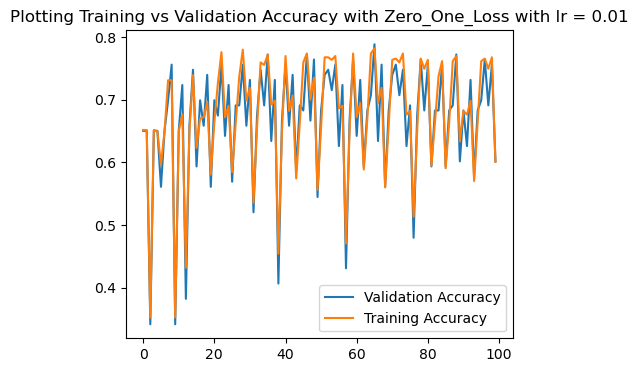

best accuracy:  0.7886178861788617
best weights:  [-0.88854273 -4.2331069   1.21088829 -0.25661575  1.21621408 -2.31319122
 -0.638336    0.02591333 -0.26012724]


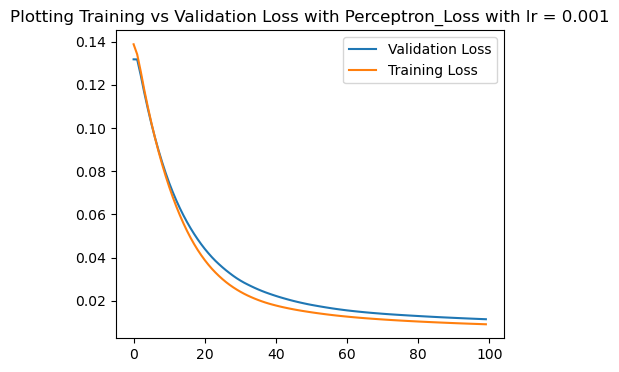

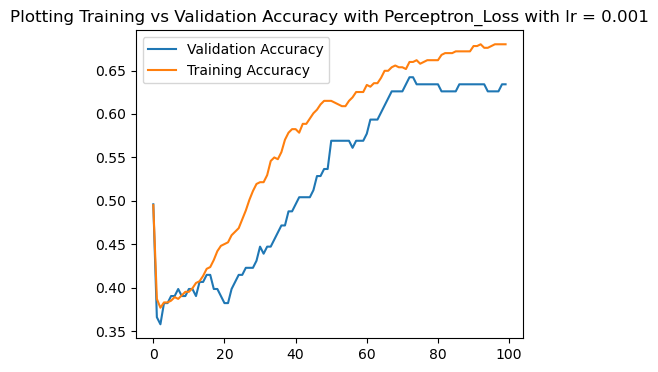

best accuracy:  0.6422764227642277
best weights:  [ 0.01520045 -0.11947962  0.0392801  -0.03086773  0.13476357 -0.08045295
  0.02956775  0.00022767  0.14418542]


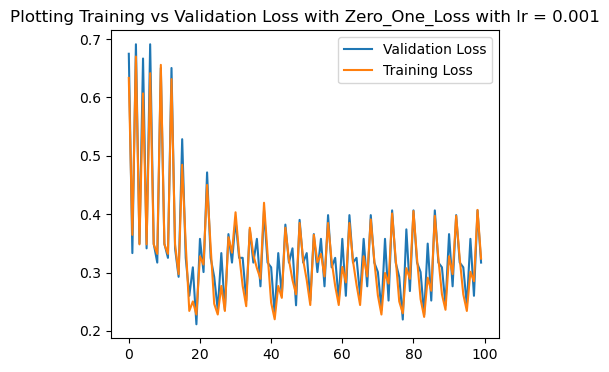

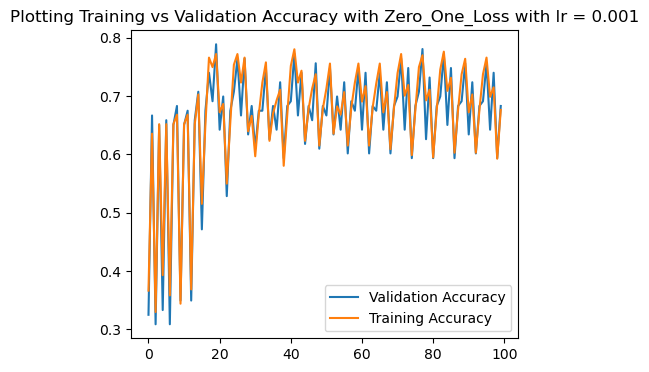

best accuracy:  0.7886178861788617
best weights:  [-0.18030592 -0.44035416  0.14675642 -0.1386947   0.0194707  -0.25477895
 -0.15276684 -0.1019524   0.19787276]


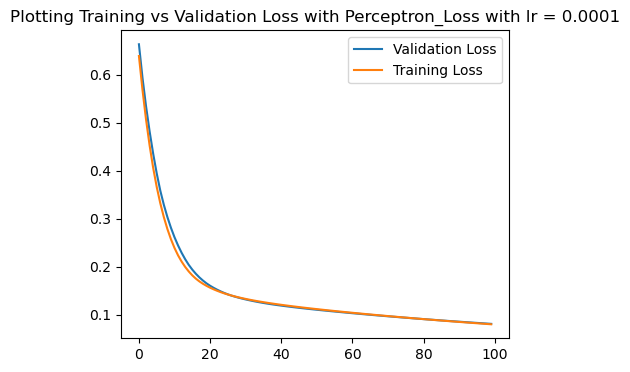

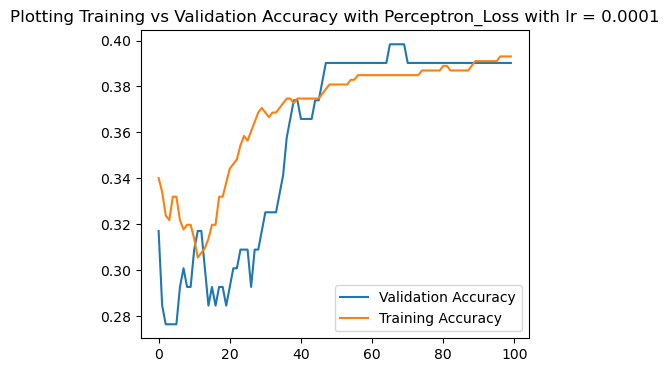

best accuracy:  0.3983739837398374
best weights:  [ 0.17375345  0.09888533  0.17819215 -0.07495942  0.2746408  -0.06706486
 -0.02653161  0.12599731  0.32625098]


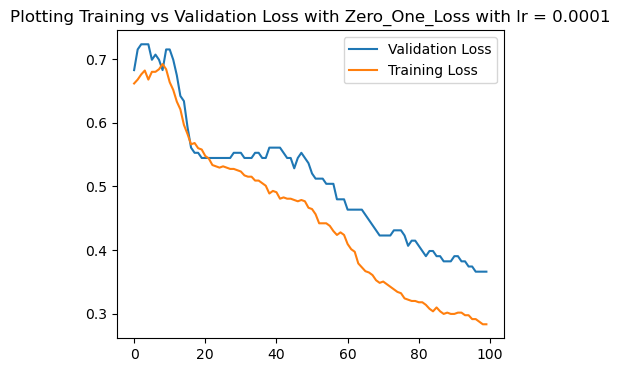

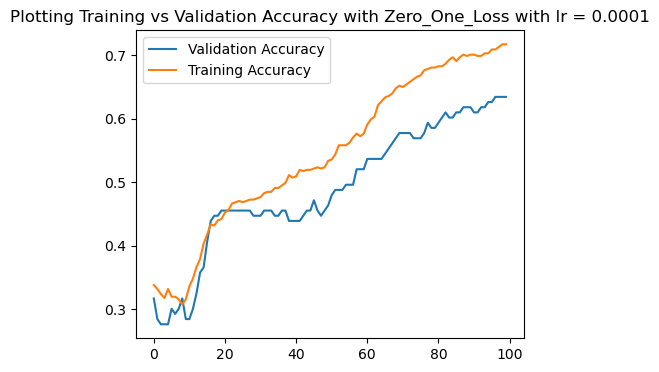

best accuracy:  0.6341463414634146
best weights:  [ 0.00951782 -0.14306784  0.04680551 -0.05363598  0.2075302  -0.10748918
  0.00837842  0.00607436  0.19087276]


In [15]:
import matplotlib.pyplot as plt
b_accuracy_table = list()
learning_Rates = [1,.1,.01,.001,0.0001]
epoch = np.arange(10,101,10)
loss =["perceptron","zero_one"]
for e in epoch:
    for lr_rate in learning_Rates:
        for l in loss:
            best_weights = 0
            best_epoch = 0
            best_accu = 0
            e_val_loss_list = []
            e_train_loss_list = []
            e_val_acc_list = []
            e_train_acc_list = []
            np.random.seed(89)
            b_weights = np.random.rand(9)
            for i in range(e):
                b_weights = update_weights(b_weights,b_X_train,b_y_train,l,lr_rate)
                train_acc = predict(b_X_train,b_y_train,b_weights)
                val_acc = predict(b_X_Val,b_y_Val,b_weights)
                e_val_acc_list.append(val_acc)
                e_train_acc_list.append(train_acc)
                if l =="zero_one":
                    e_train_loss = zero_one_loss(b_X_train,b_y_train,b_weights)
                    e_val_loss = zero_one_loss(b_X_Val,b_y_Val,b_weights)
                else:
                    e_train_loss = perceptron_loss(b_X_train,b_y_train,b_weights)
                    e_val_loss = perceptron_loss(b_X_Val,b_y_Val,b_weights)
                e_val_loss_list.append(e_val_loss)
                e_train_loss_list.append(e_train_loss)
            #     print("Iteration ",i)
            #     print("Training accuracy:",train_acc," Validation accuracy:",val_acc,"Validation Loss:",val_loss,"Training Loss ",train_loss)
                if val_acc>best_accu:
                    best_epoch = (i+1)
                    best_accu = val_acc
                    best_weights = b_weights

            b_accuracy_table.append((best_accu,lr_rate,l,best_epoch,e,best_weights))
            #Plotting Loss Curve
            plt.figure(figsize=(5, 4))
            if l =="zero_one":
                plt.title("Plotting Training vs Validation Loss with Zero_One_Loss with lr = "+ str(lr_rate))
            else:
                plt.title("Plotting Training vs Validation Loss with Perceptron_Loss with lr = "+ str(lr_rate))
            plt.plot(np.arange(e), e_val_loss_list, label = "Validation Loss")
            plt.plot(np.arange(e), e_train_loss_list, label = "Training Loss")
            plt.legend()
            plt.show()

            #Plotting Validation Curve
            plt.figure(figsize=(5, 4))
            if l =="zero_one":
                plt.title("Plotting Training vs Validation Accuracy with Zero_One_Loss with lr = "+ str(lr_rate))
            else:
                plt.title("Plotting Training vs Validation Accuracy with Perceptron_Loss with lr = "+ str(lr_rate))

            plt.plot(np.arange(e), e_val_acc_list, label = "Validation Accuracy")
            plt.plot(np.arange(e), e_train_acc_list, label = "Training Accuracy")
            plt.legend()
            plt.show()
            print("best accuracy: ",best_accu)
            print("best weights: " ,best_weights)

In [16]:
import pandas as pd
b_accuracy_table.sort(reverse=True)
dfb = pd.DataFrame(b_accuracy_table, columns=["Val_Accuracy", "Learning Rate","Loss","nth Epoch","Epoch Range","Best Weights"])
dfb.iloc[:45,:]

,Val_Accuracy,Learning Rate,Loss,nth Epoch,Epoch Range,Best Weights
0,0.788618,1.000,zero_one,84,100,"[-130.2063526795285, -439.9349045956876, 109.2..."
1,0.788618,1.000,zero_one,84,90,"[-202.20635517952866, -353.5630655156877, 137...."
2,0.788618,0.100,zero_one,76,100,"[-13.647380979530904, -43.89932696868829, 11.5..."
3,0.788618,0.100,zero_one,76,90,"[-9.370908279530937, -37.2556096126883, 11.187..."
4,0.788618,0.100,zero_one,76,80,"[-10.200318579530958, -37.69932956468831, 11.7..."
5,0.788618,0.010,zero_one,66,100,"[-0.8885427295311398, -4.233106898488324, 1.21..."
6,0.788618,0.010,zero_one,66,90,"[-0.9320719795311407, -4.303458752288324, 1.17..."
7,0.788618,0.010,zero_one,66,80,"[-1.1103071395311424, -4.371750336088324, 1.21..."
8,0.788618,0.010,zero_one,66,70,"[-1.9785424695311433, -3.987428883088325, 1.44..."
9,0.788618,0.001,zero_one,20,100,"[-0.18030591503116294, -0.4403541554783294, 0...."


Testing accuracy: 0.7727272727272727
F1 Score : 0.8275862068965517
Precision : 0.8155339805825242
Recall : 0.84
Confusion Matrix :


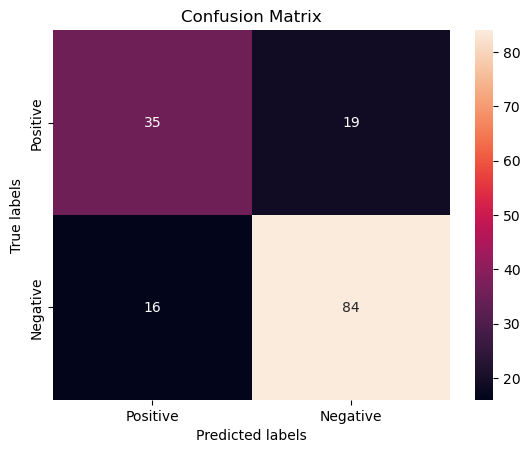

In [17]:
overall_best_weights = dfb['Best Weights'][0]
test_acc = predict(b_X_test,b_y_test,overall_best_weights)
print("Testing accuracy:",test_acc)
accuracy_scores(b_X_test,b_y_test,overall_best_weights)

### Hyperparameter Tuning Without Bias

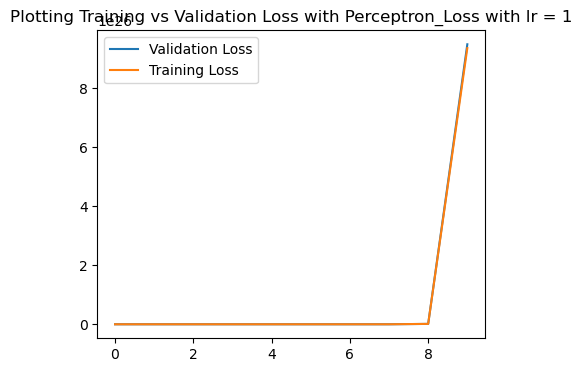

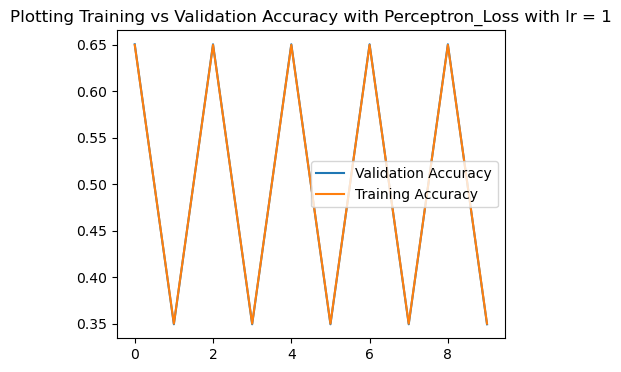

best accuracy:  0.6504065040650406
best weights:  [ 3.27741210e+26 -2.84762806e+26 -9.82811799e+25  3.82418771e+26
  5.23084089e+26 -2.77510719e+25  4.28241572e+26  3.47798642e+26]


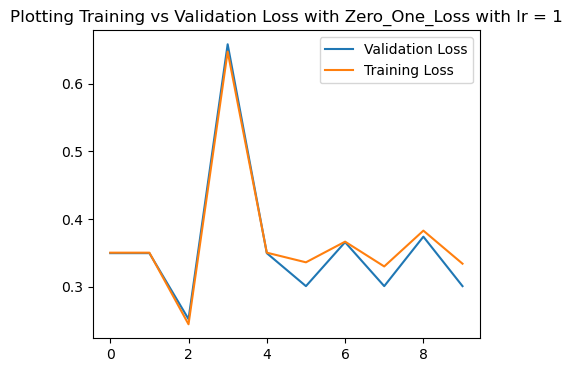

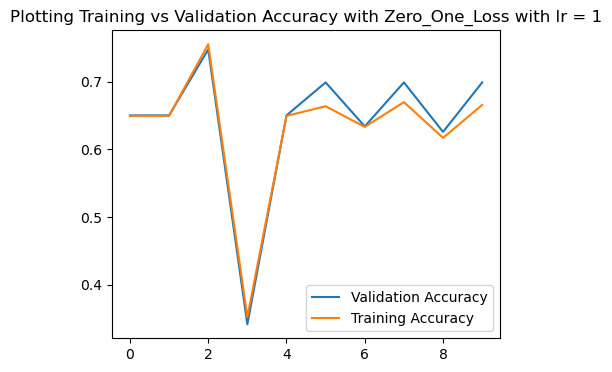

best accuracy:  0.7479674796747967
best weights:  [-125.65987151 -203.81566755   26.35706107  -95.40189689  -87.56312384
 -109.80235415 -104.03392854 -106.04171244]


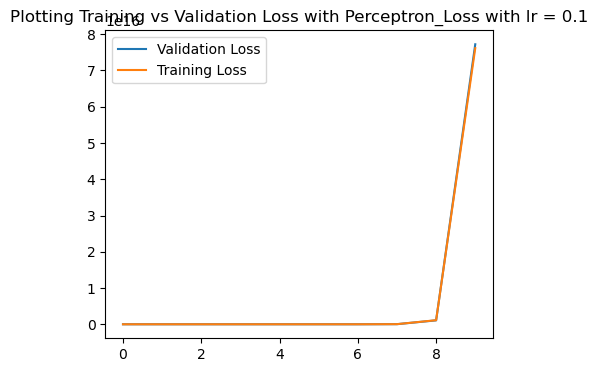

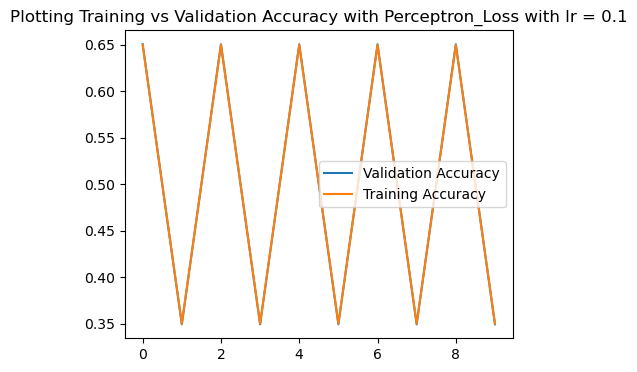

best accuracy:  0.6504065040650406
best weights:  [ 2.65650127e+16 -2.37175329e+16 -8.06840269e+15  3.11264729e+16
  4.26295645e+16 -2.49113492e+15  3.48665839e+16  2.81706837e+16]


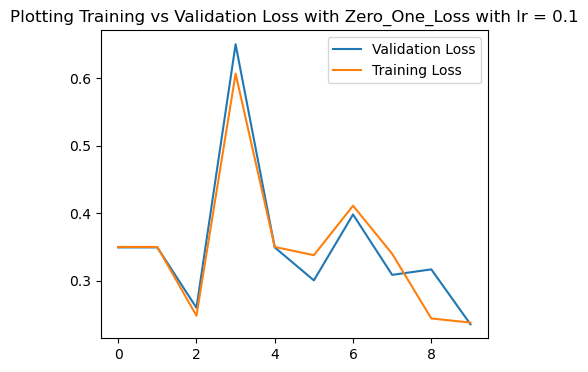

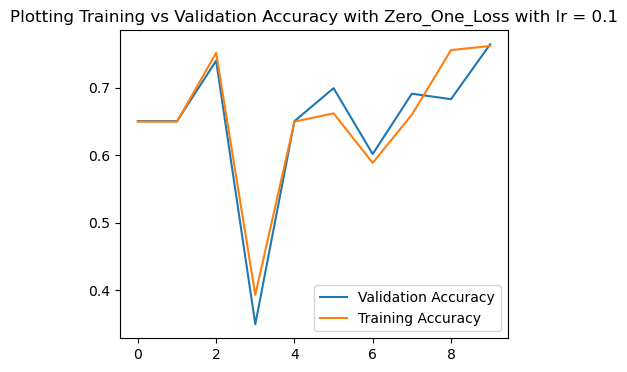

best accuracy:  0.7642276422764228
best weights:  [ -5.81866656 -21.16493135   1.56198973  -2.68364854  -0.16994127
  -9.4808885   -3.42829024  -3.39502113]


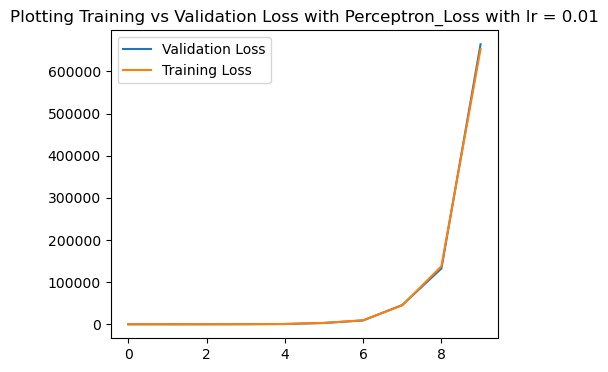

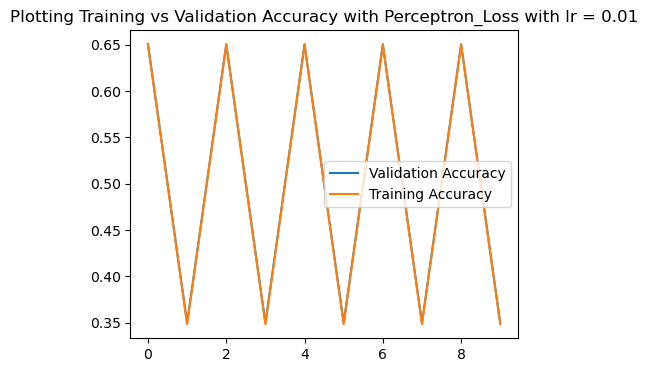

best accuracy:  0.6504065040650406
best weights:  [ 213461.9994462  -287715.50139866  -79364.89479691  269288.2905594
  377640.02531329  -57340.75070308  303255.00665848  223731.53612748]


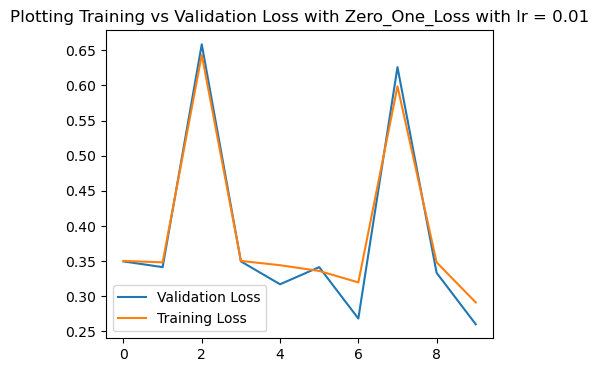

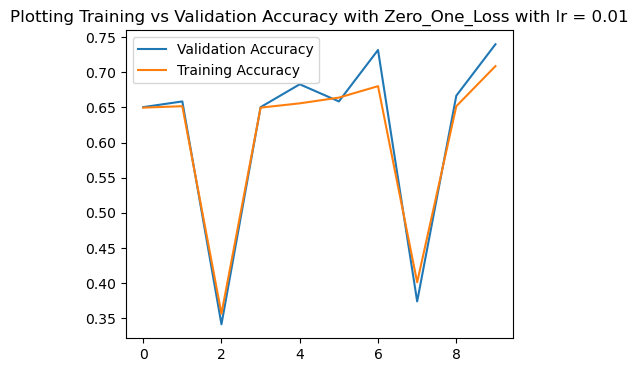

best accuracy:  0.7398373983739838
best weights:  [-1.30984168 -2.51804889  0.17887547 -0.59384418 -0.2892521  -1.28623763
 -0.90456628 -1.17435292]


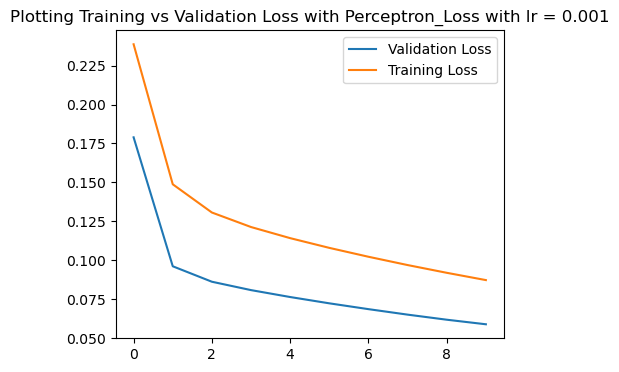

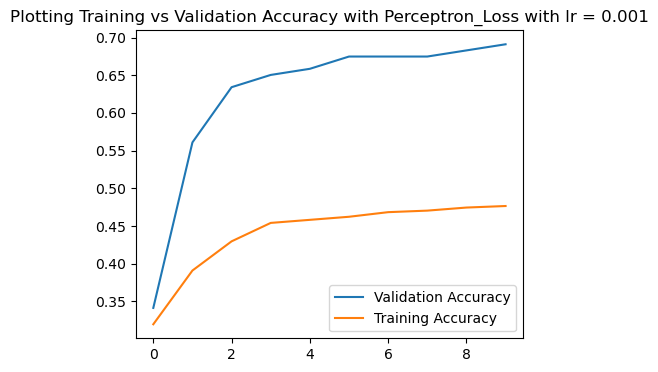

best accuracy:  0.6910569105691057
best weights:  [-0.20253733  0.23085072  0.22157756  0.13053396  0.35625388 -0.01934003
 -0.23729266 -0.08989586]


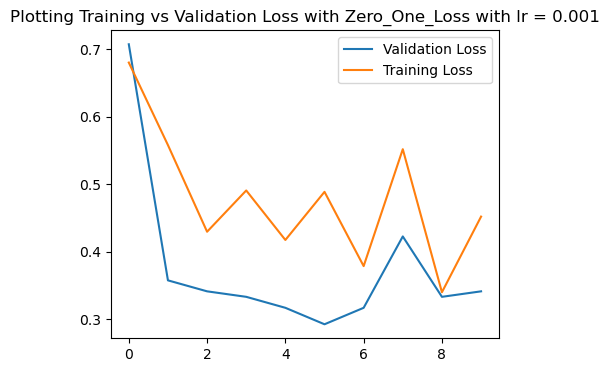

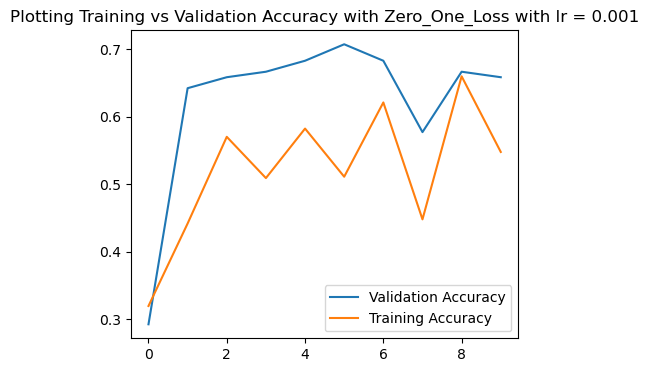

best accuracy:  0.7073170731707317
best weights:  [-0.11872375 -0.06168227  0.14807236  0.0517627   0.28200126 -0.12676363
 -0.19778234 -0.04028598]


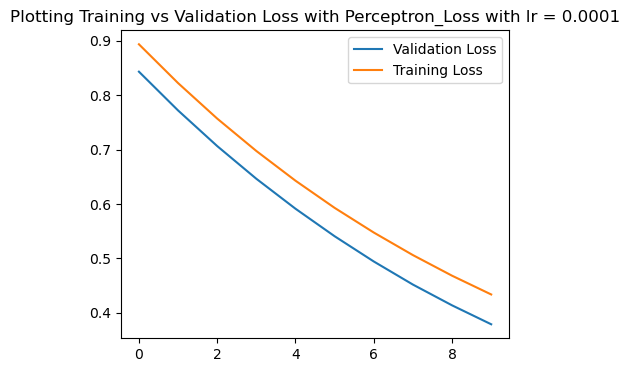

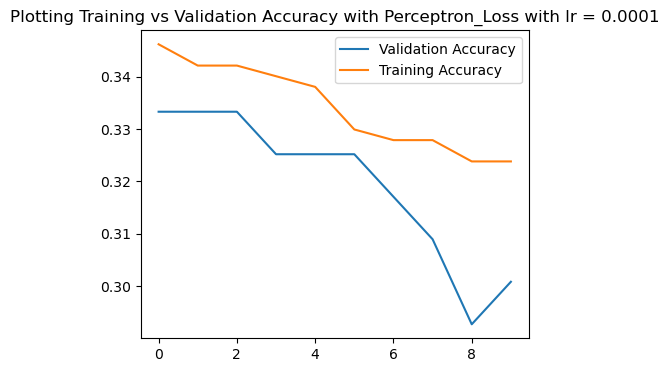

best accuracy:  0.3333333333333333
best weights:  [-0.15418713  0.38260338  0.2681643   0.39550333  0.68572721  0.08084693
 -0.06740543  0.03283514]


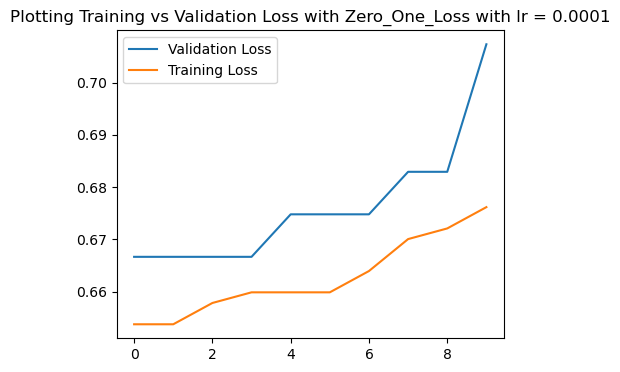

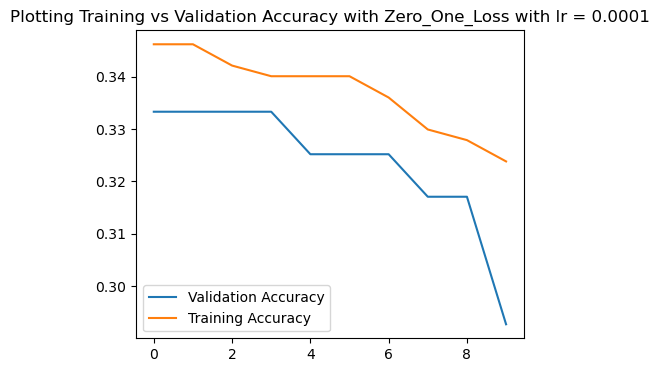

best accuracy:  0.3333333333333333
best weights:  [-0.13851198  0.39137096  0.2793609   0.43412647  0.72045639  0.0951365
 -0.04397139  0.05675071]


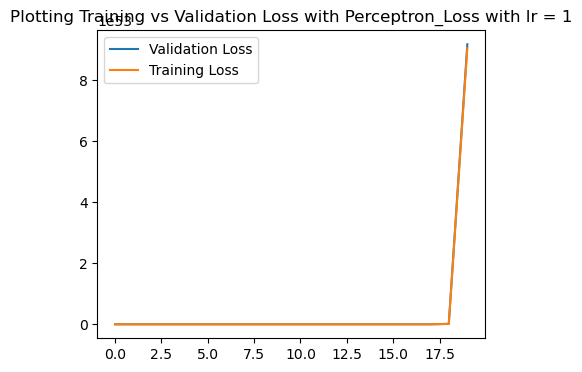

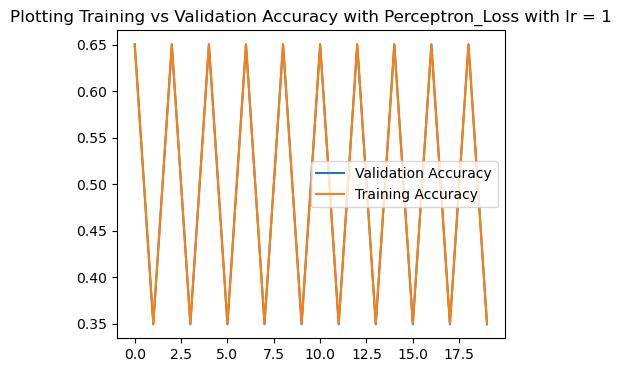

best accuracy:  0.6504065040650406
best weights:  [ 3.16842483e+53 -2.75293285e+53 -9.50129312e+52  3.69701793e+53
  5.05689416e+53 -2.68282359e+52  4.14000799e+53  3.36232923e+53]


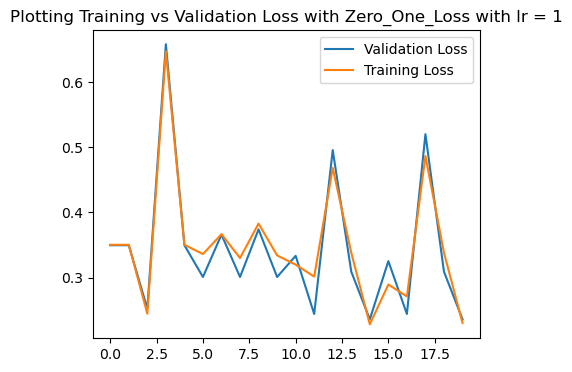

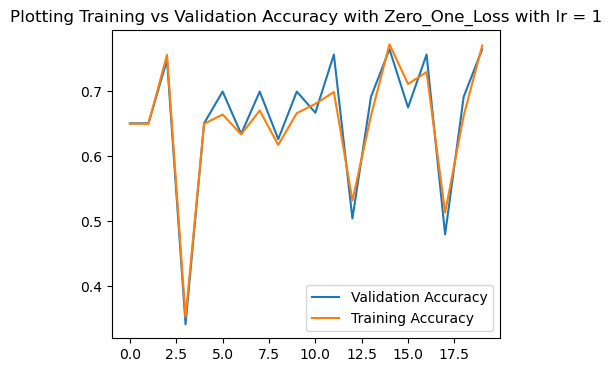

best accuracy:  0.7642276422764228
best weights:  [ -93.83634651 -304.39354837   39.99640227  -50.78577229   13.97820816
 -143.62800635  -59.68466006  -51.24172384]


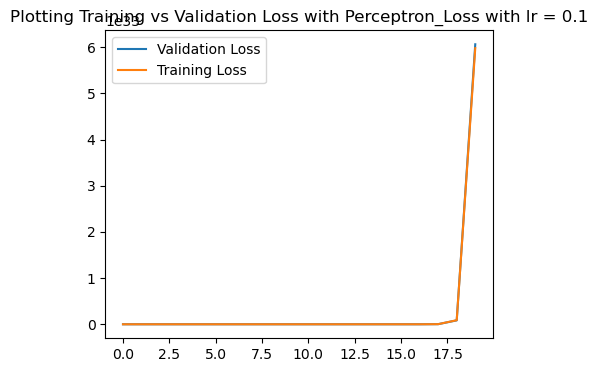

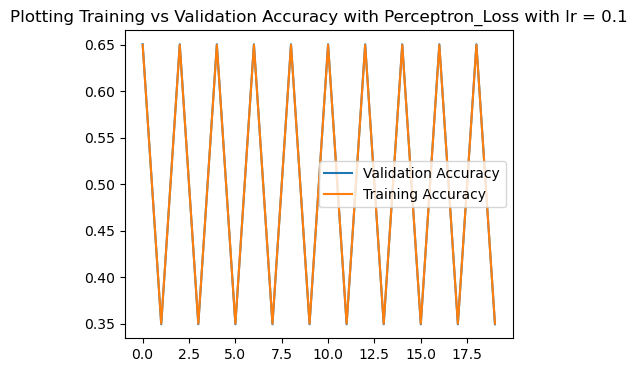

best accuracy:  0.6504065040650406
best weights:  [ 2.08509179e+33 -1.86159268e+33 -6.33290125e+32  2.44312148e+33
  3.34600084e+33 -1.95529549e+32  2.73668334e+33  2.21112114e+33]


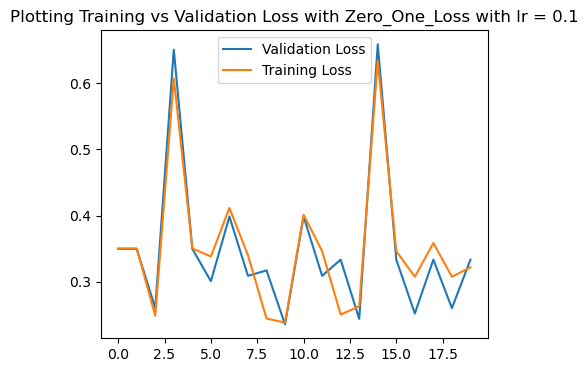

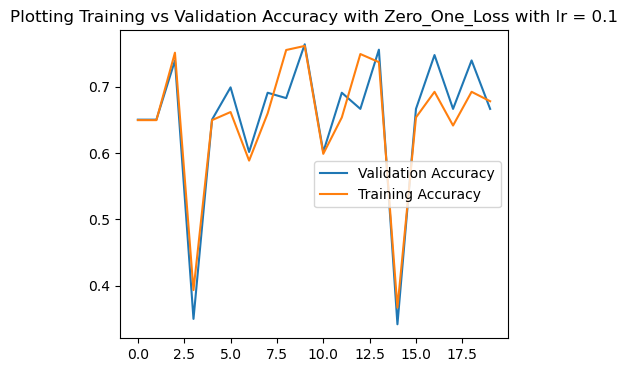

best accuracy:  0.7642276422764228
best weights:  [ -6.17749146 -31.7754829    2.67838305  -1.34122907   5.57260785
 -14.41159067  -1.15433663  -2.17502282]


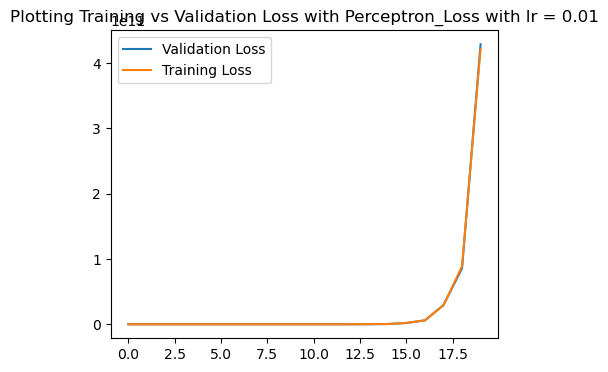

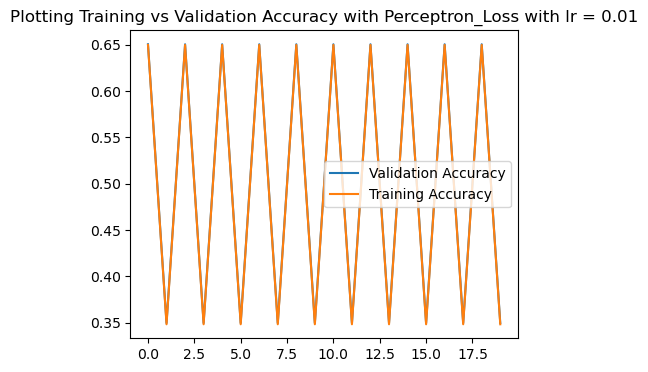

best accuracy:  0.6504065040650406
best weights:  [ 1.37746462e+11 -1.85662114e+11 -5.12139433e+10  1.73771025e+11
  2.43690116e+11 -3.70018514e+10  1.95689689e+11  1.44373379e+11]


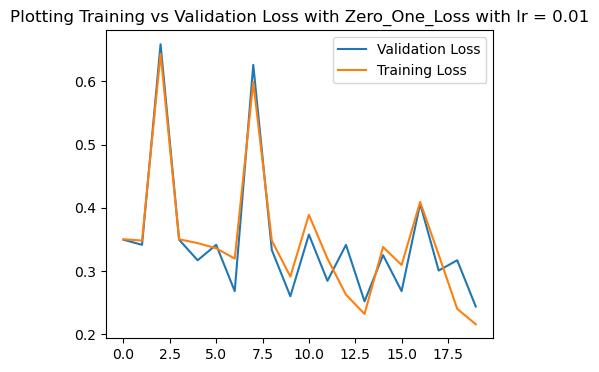

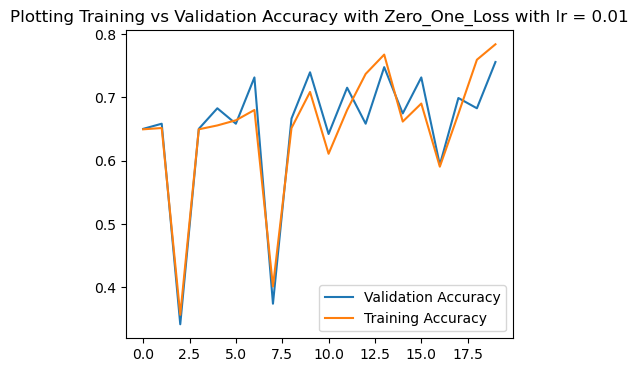

best accuracy:  0.7560975609756098
best weights:  [-0.91160653 -2.76111412  0.59002309 -0.50950089  0.14632671 -1.43567146
 -0.75584726 -0.43168629]


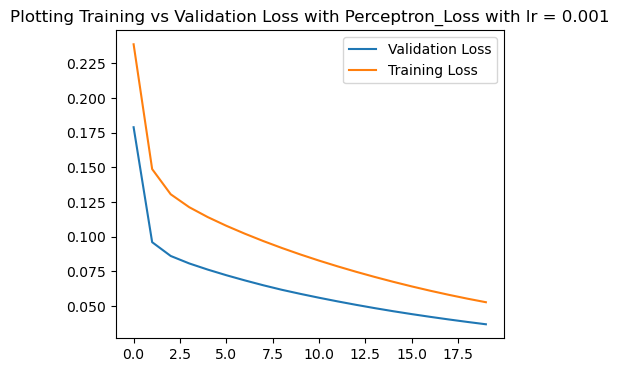

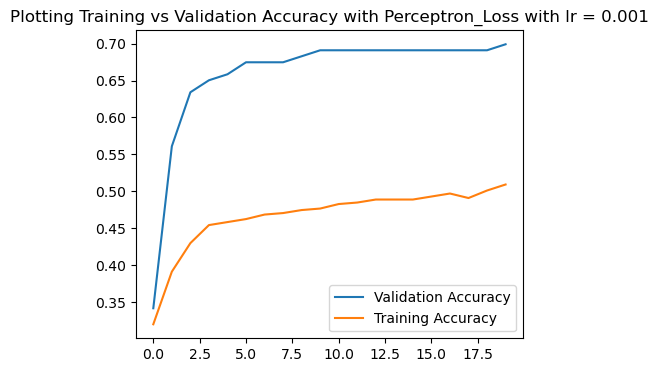

best accuracy:  0.6991869918699187
best weights:  [-0.12687384  0.11201696  0.17051679  0.0704503   0.28039001 -0.06002437
 -0.21037604 -0.05679937]


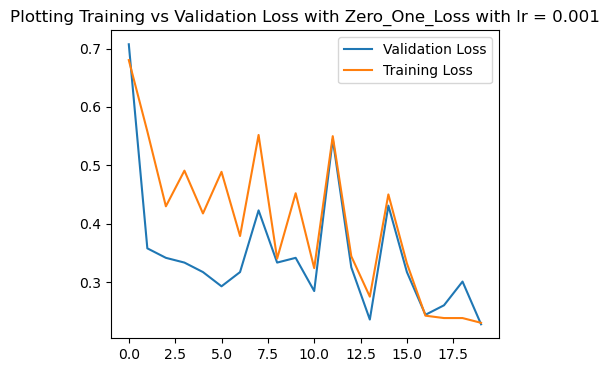

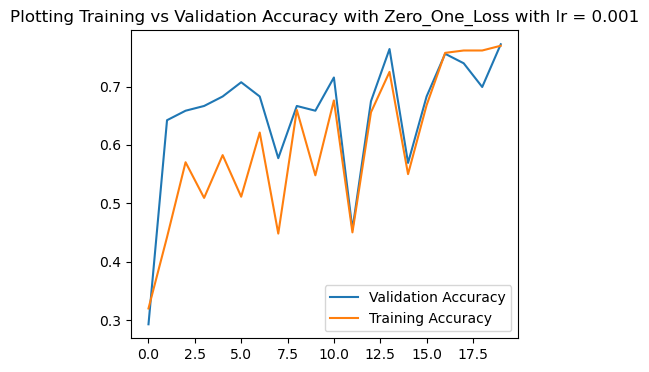

best accuracy:  0.7723577235772358
best weights:  [-0.06978258 -0.22413449  0.10497401 -0.04484342  0.10844802 -0.1795833
 -0.1406218  -0.02125265]


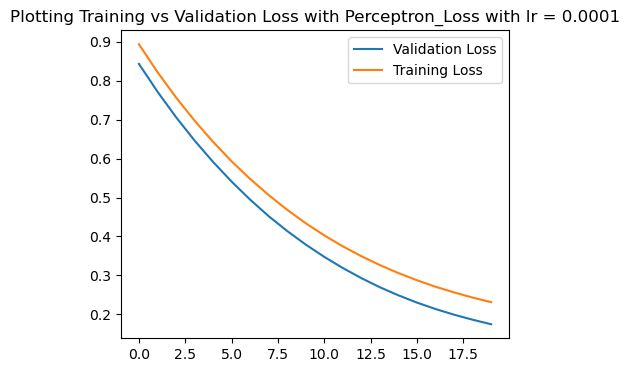

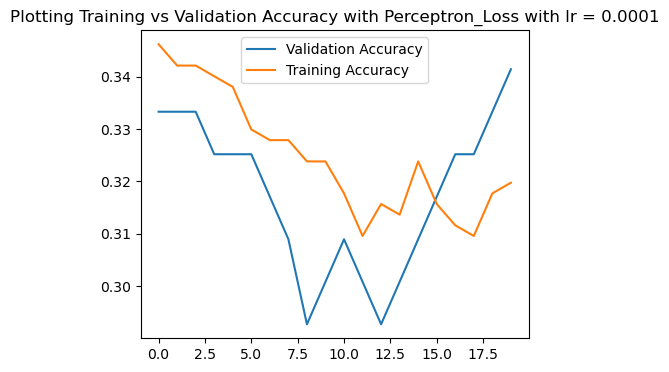

best accuracy:  0.34146341463414637
best weights:  [-0.23006416  0.37725012  0.27367824  0.2886763   0.54690364  0.05538785
 -0.16874608 -0.05722892]


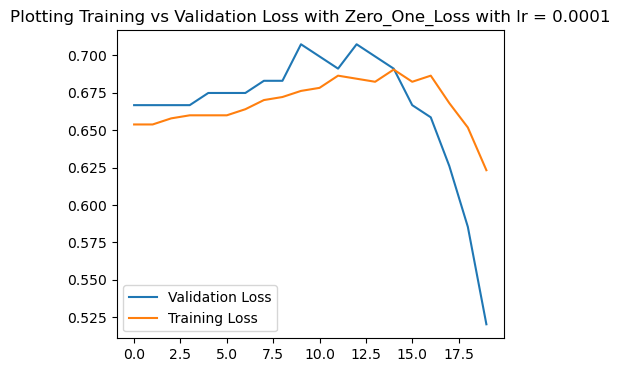

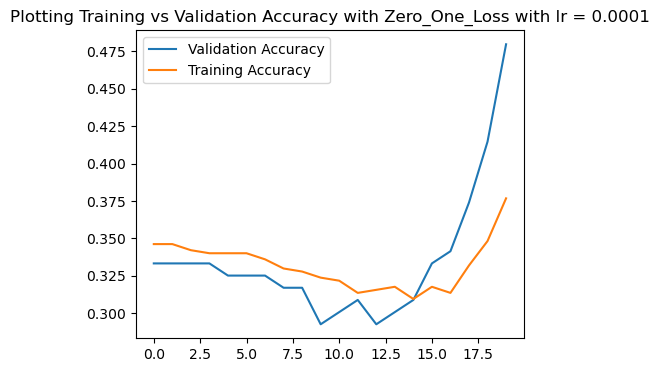

best accuracy:  0.4796747967479675
best weights:  [-0.27445319  0.37835086  0.30059533  0.26235677  0.48610603  0.05384202
 -0.21803134 -0.0993993 ]


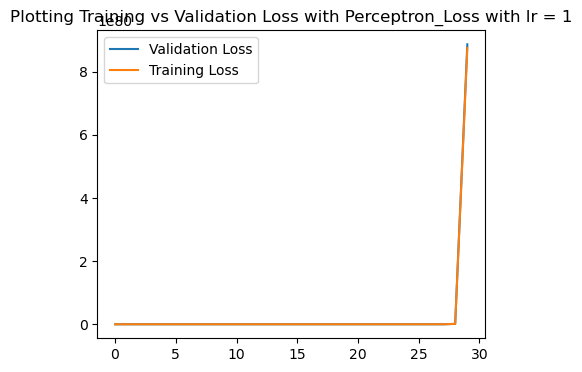

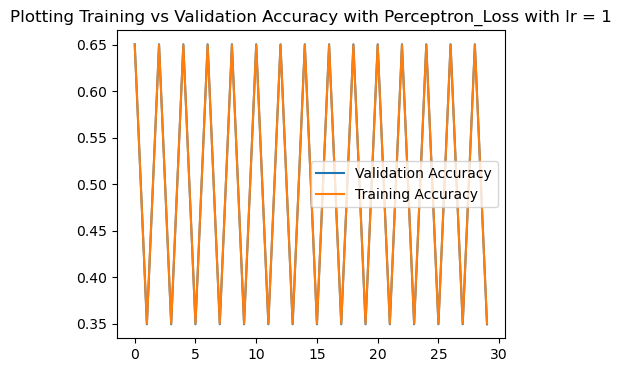

best accuracy:  0.6504065040650406
best weights:  [ 3.06306182e+80 -2.66138664e+80 -9.18533649e+79  3.57407705e+80
  4.88873187e+80 -2.59360880e+79  4.00233589e+80  3.25051812e+80]


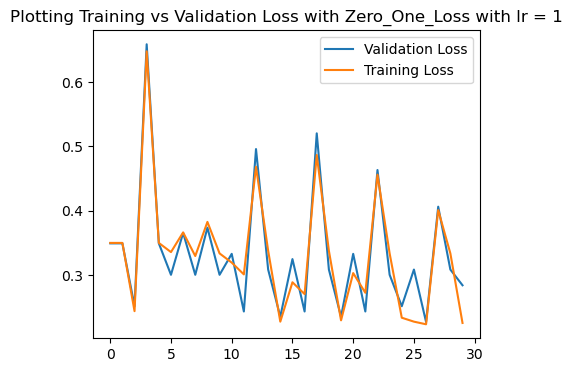

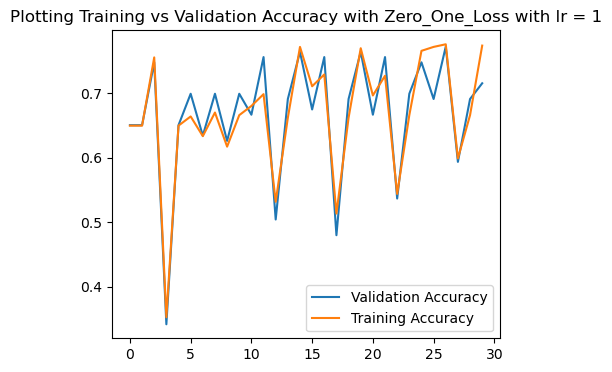

best accuracy:  0.7723577235772358
best weights:  [ -73.71871201 -297.83072542   61.43904007  -27.55345679   59.14601426
 -145.83368202  -46.19960984  -15.07506124]


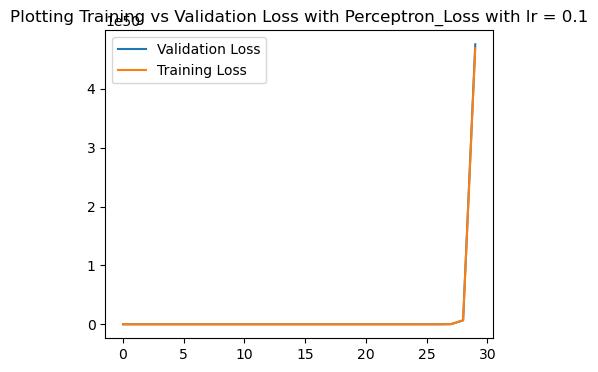

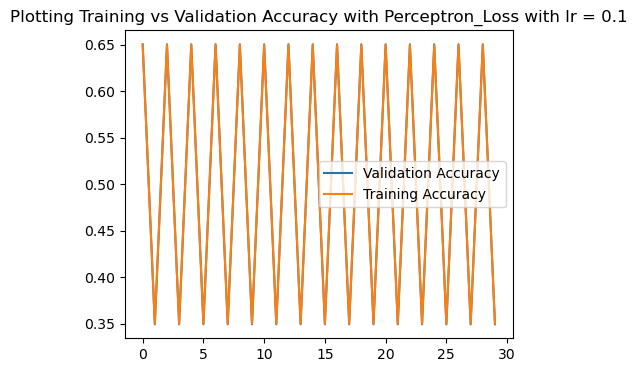

best accuracy:  0.6504065040650406
best weights:  [ 1.63659164e+50 -1.46116685e+50 -4.97070358e+49  1.91760967e+50
  2.62628102e+50 -1.53471433e+49  2.14802681e+50  1.73551226e+50]


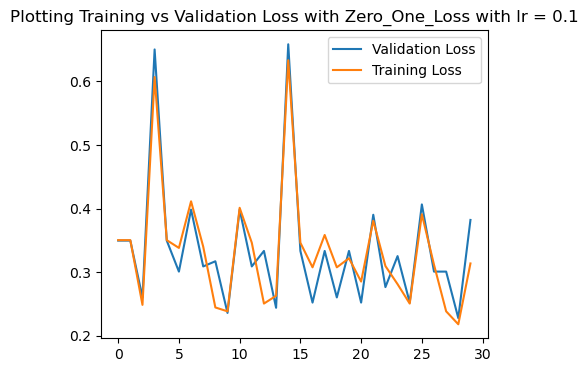

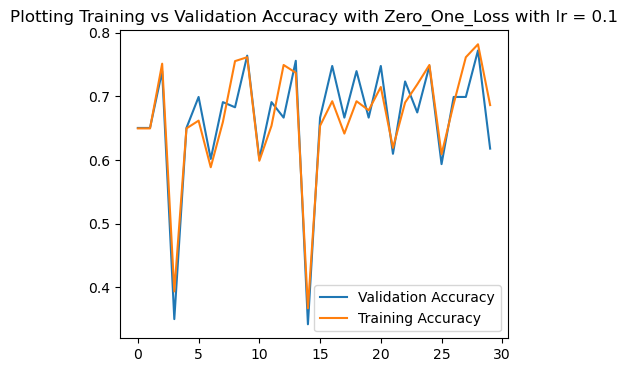

best accuracy:  0.7723577235772358
best weights:  [ -5.95984636 -29.01920094   6.39313864  -1.60688547   6.4678758
 -14.28118963  -2.94630944   0.04497606]


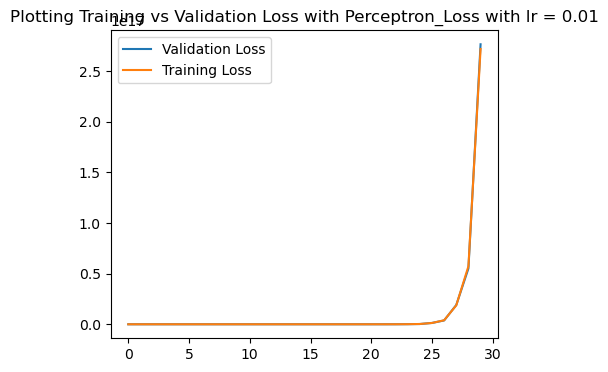

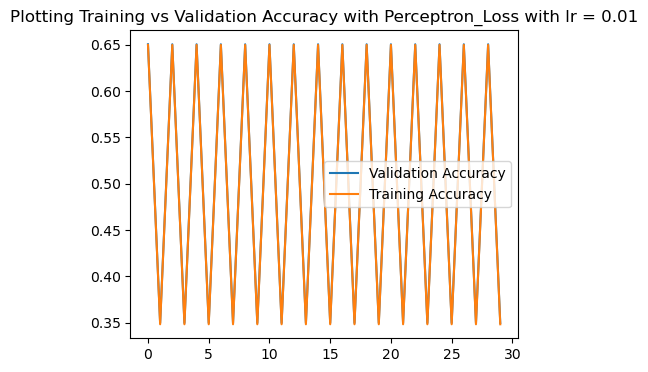

best accuracy:  0.6504065040650406
best weights:  [ 8.88874324e+16 -1.19807278e+17 -3.30482240e+16  1.12133989e+17
  1.57252596e+17 -2.38771982e+16  1.26278046e+17  9.31637649e+16]


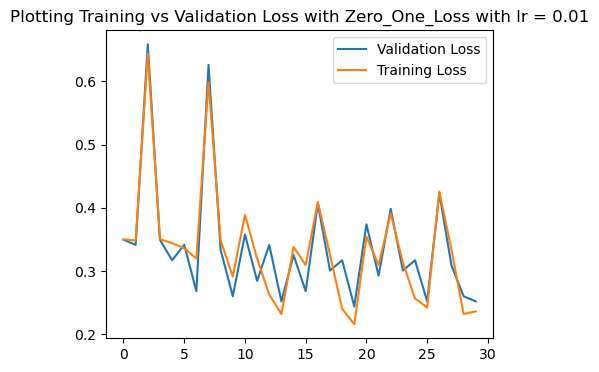

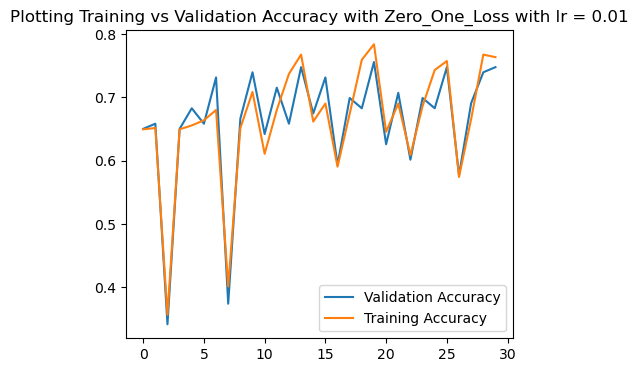

best accuracy:  0.7560975609756098
best weights:  [-0.78690077 -2.82272209  0.70035107 -0.34990503  0.47374946 -1.48619319
 -0.59588993 -0.1890197 ]


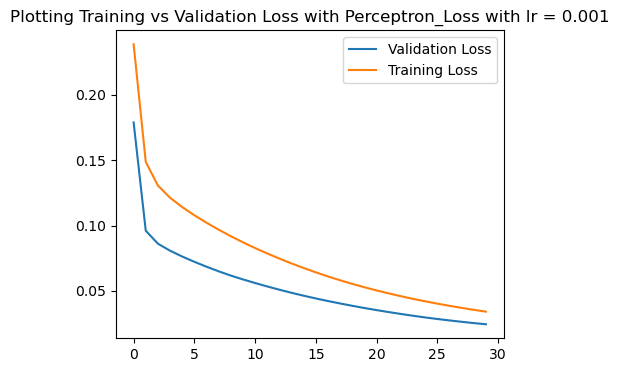

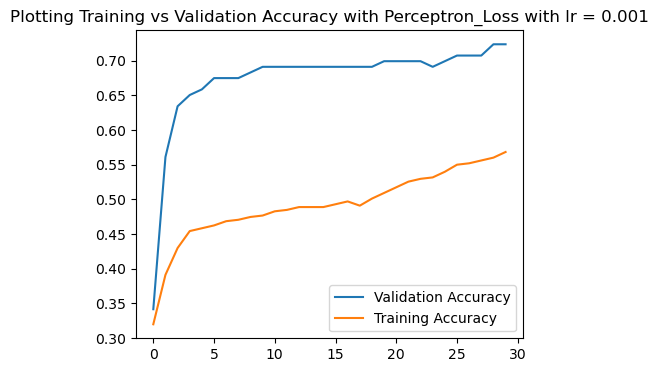

best accuracy:  0.7235772357723578
best weights:  [-0.08335127  0.04333738  0.13876956  0.03528615  0.22856496 -0.07909555
 -0.183317   -0.03972947]


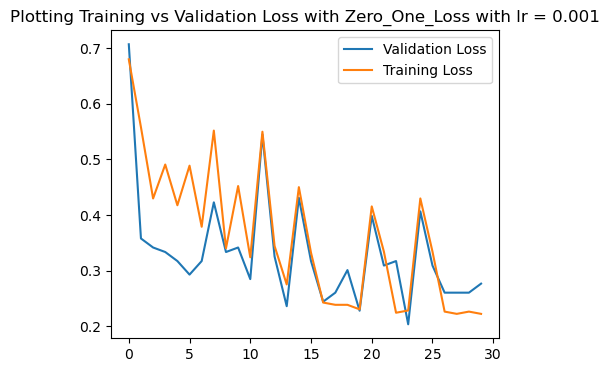

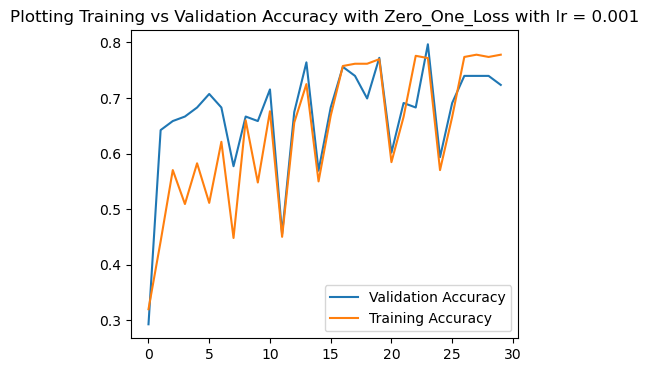

best accuracy:  0.7967479674796748
best weights:  [-0.05890024 -0.21952644  0.09044943 -0.02580302  0.07784042 -0.16190669
 -0.08409576 -0.00961932]


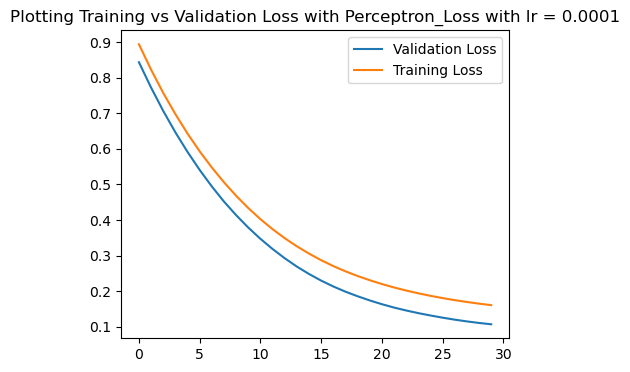

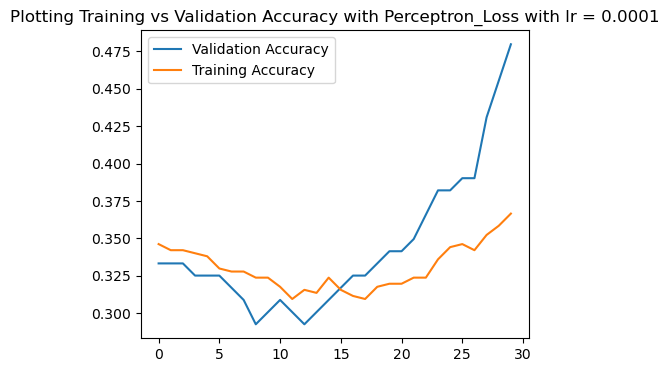

best accuracy:  0.4796747967479675
best weights:  [-0.25348979  0.36314312  0.27068556  0.23570348  0.47962674  0.0398893
 -0.21096139 -0.09087995]


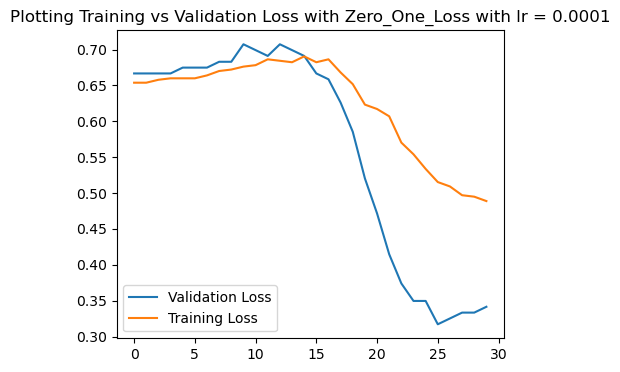

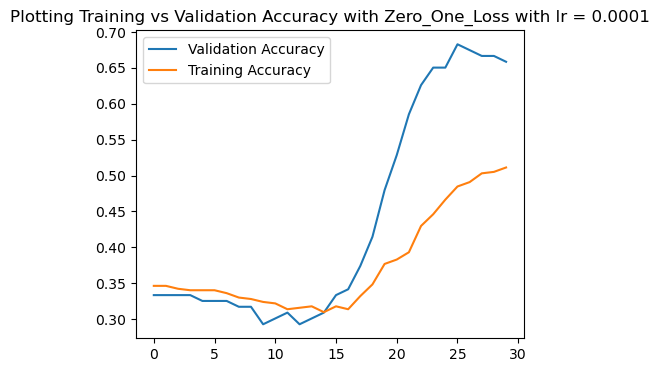

best accuracy:  0.6829268292682927
best weights:  [-0.28774143  0.32050312  0.28561172  0.183582    0.39581218  0.0180377
 -0.26564031 -0.13078931]


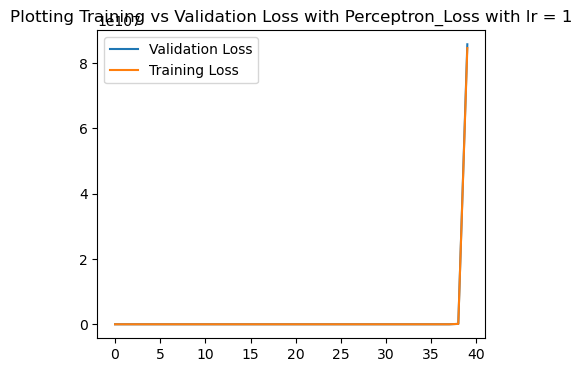

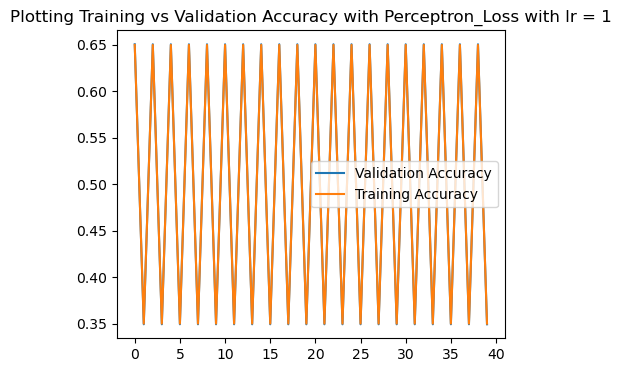

best accuracy:  0.6504065040650406
best weights:  [ 2.96120256e+107 -2.57288472e+107 -8.87988671e+106  3.45522446e+107
  4.72616166e+107 -2.50736077e+106  3.86924195e+107  3.14242518e+107]


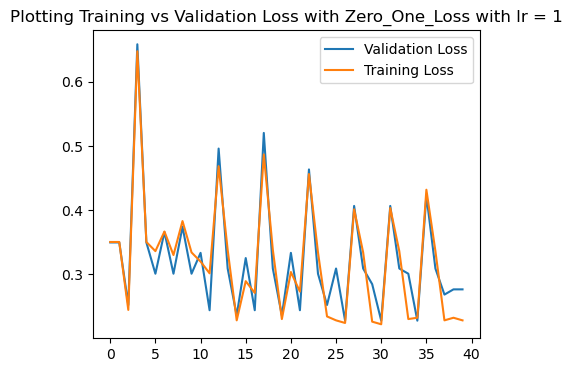

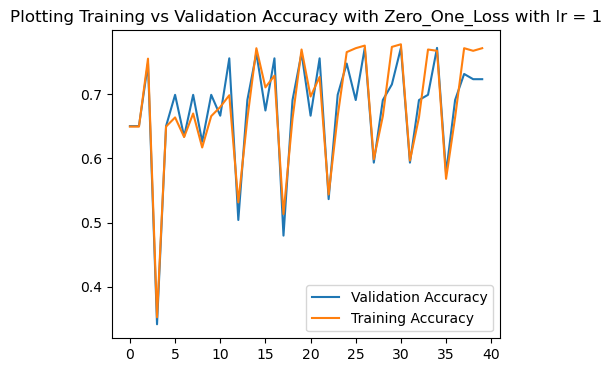

best accuracy:  0.7723577235772358
best weights:  [ -74.71872851 -252.41865724   76.45545337  -30.93729219   56.88356046
 -140.34784818  -60.05870632   -9.07506264]


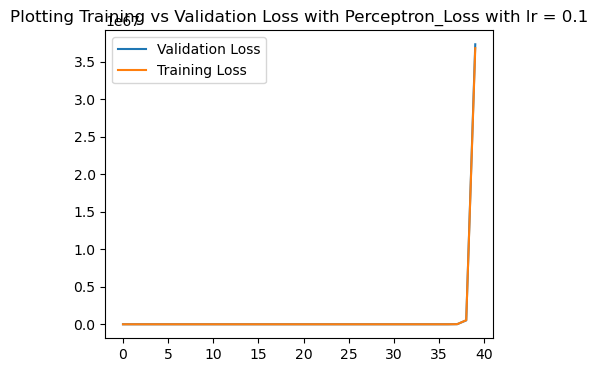

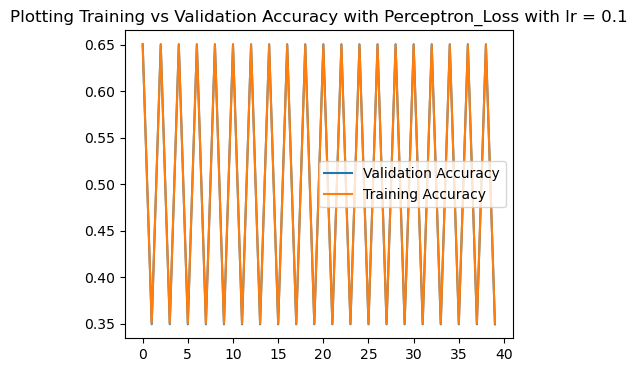

best accuracy:  0.6504065040650406
best weights:  [ 1.28456320e+67 -1.14687203e+67 -3.90151262e+66  1.50513468e+67
  2.06137187e+67 -1.20459956e+66  1.68598943e+67  1.36220615e+67]


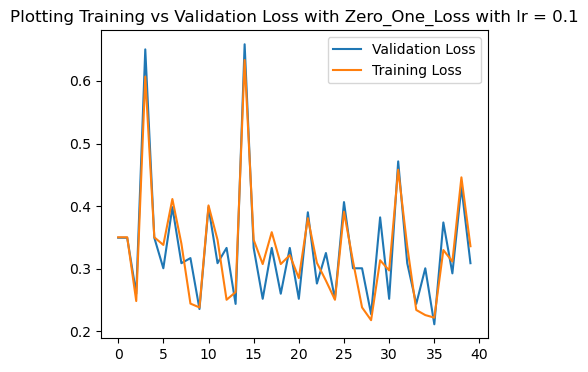

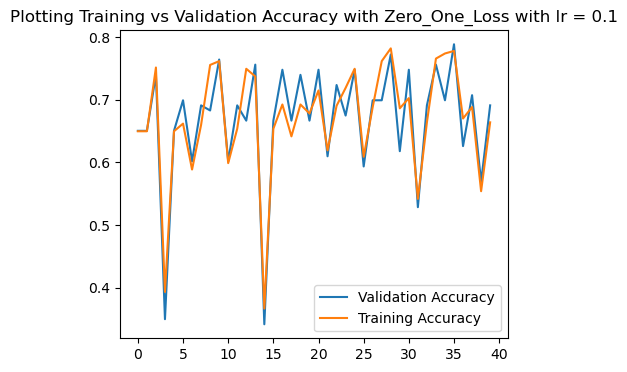

best accuracy:  0.7886178861788617
best weights:  [-16.10690861 -24.04784396   9.62100891 -13.00587486  -7.53780218
 -15.42381321 -16.5172745  -10.96835866]


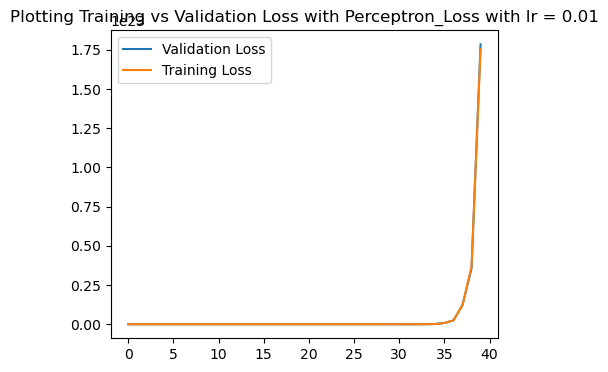

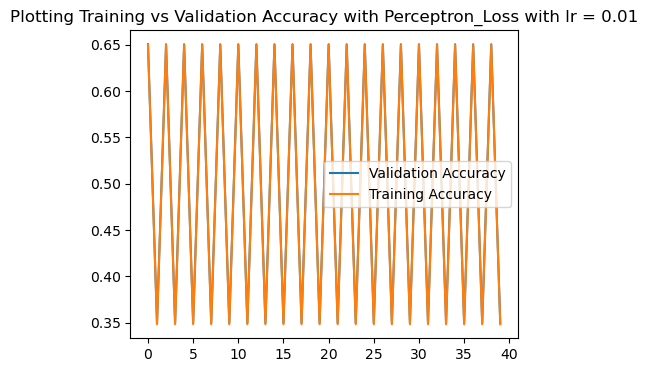

best accuracy:  0.6504065040650406
best weights:  [ 5.73588282e+22 -7.73113239e+22 -2.13259327e+22  7.23597704e+22
  1.01474690e+23 -1.54078937e+22  8.14868933e+22  6.01183344e+22]


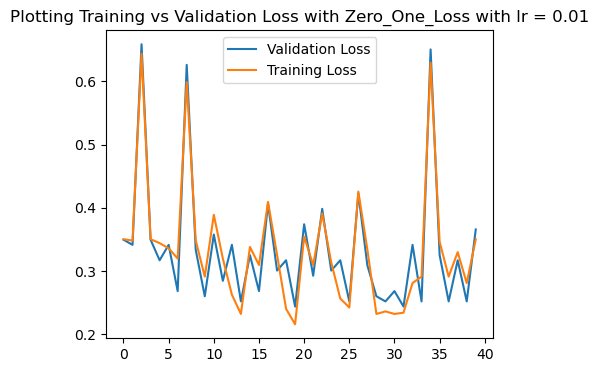

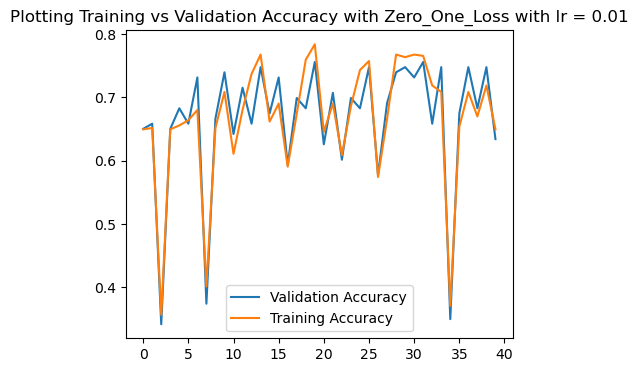

best accuracy:  0.7560975609756098
best weights:  [-0.64807735 -3.19106374  0.59871184 -0.14808707  0.86292164 -1.6820801
 -0.28670127 -0.12935317]


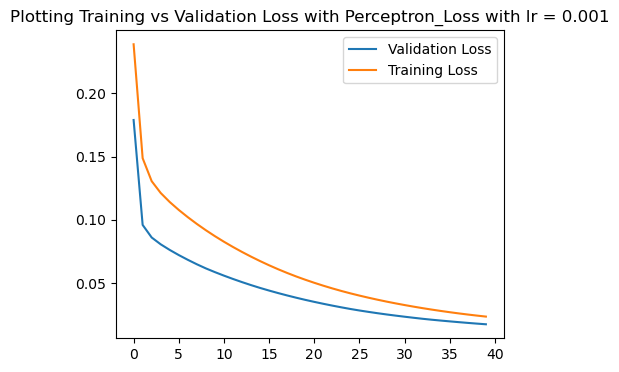

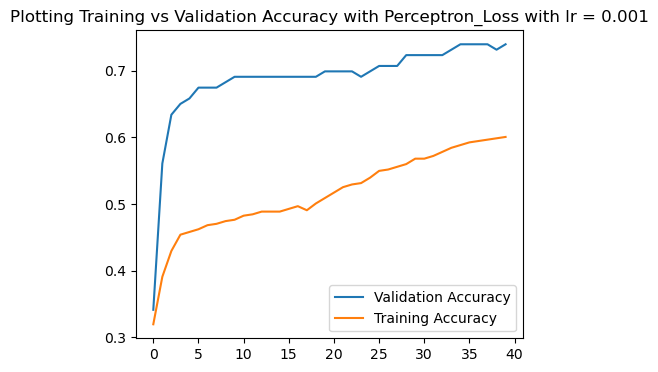

best accuracy:  0.7398373983739838
best weights:  [-0.05821513  0.00210844  0.11799996  0.01420852  0.19157686 -0.08701099
 -0.15916991 -0.0314938 ]


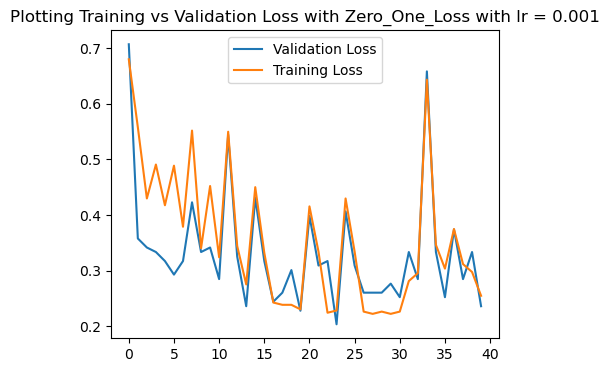

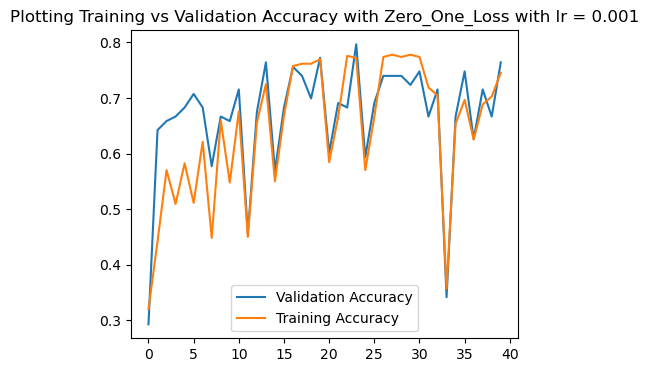

best accuracy:  0.7967479674796748
best weights:  [-0.11319438 -0.27557165  0.08671173 -0.07205556  0.00686874 -0.18335976
 -0.10776272 -0.06841934]


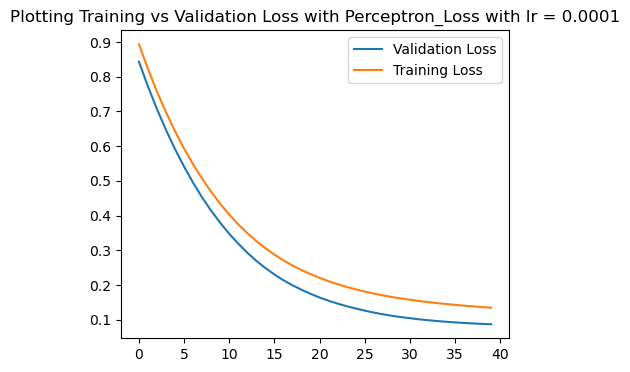

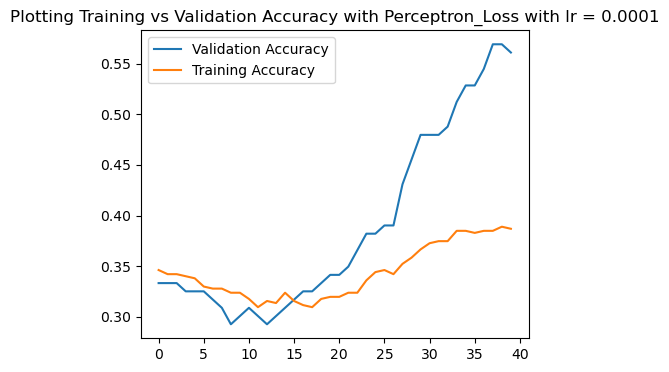

best accuracy:  0.5691056910569106
best weights:  [-0.25638547  0.34577014  0.26461247  0.20548     0.44244738  0.0286274
 -0.22912916 -0.10231384]


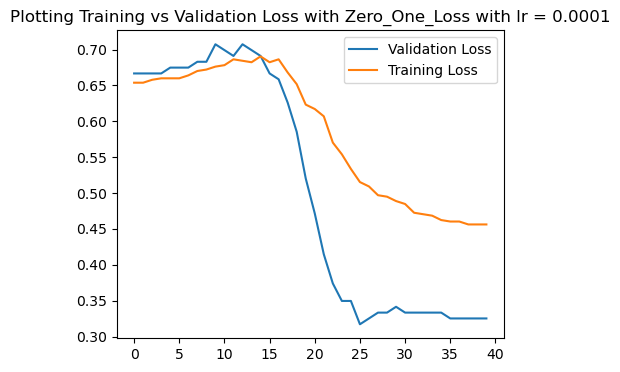

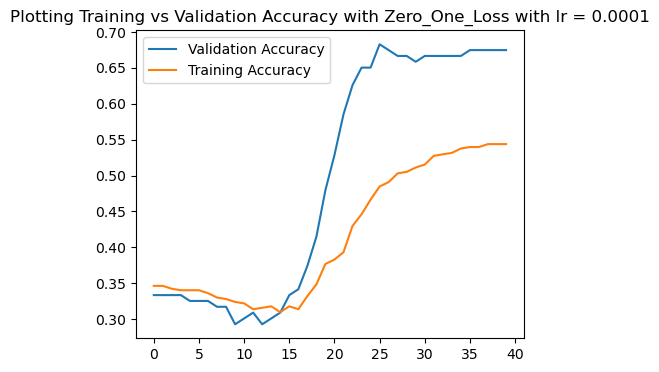

best accuracy:  0.6829268292682927
best weights:  [-0.25954142  0.25581971  0.261615    0.14967087  0.3664552  -0.01078197
 -0.2645392  -0.11820264]


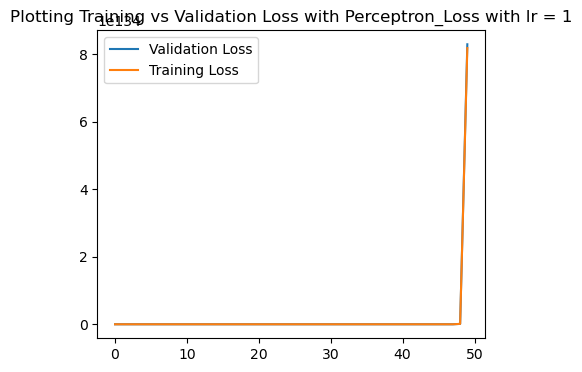

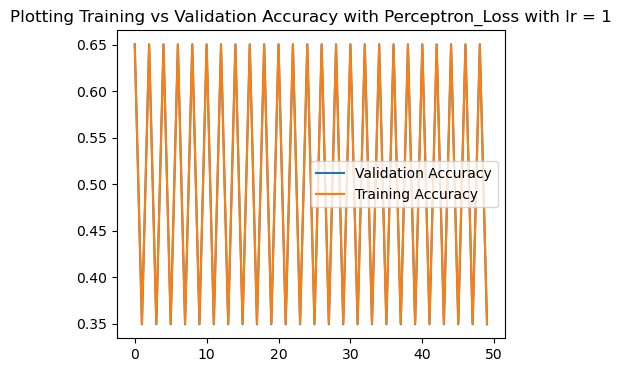

best accuracy:  0.6504065040650406
best weights:  [ 2.86273054e+134 -2.48732584e+134 -8.58459438e+133  3.34032420e+134
  4.56899758e+134 -2.42398083e+133  3.74057393e+134  3.03792676e+134]


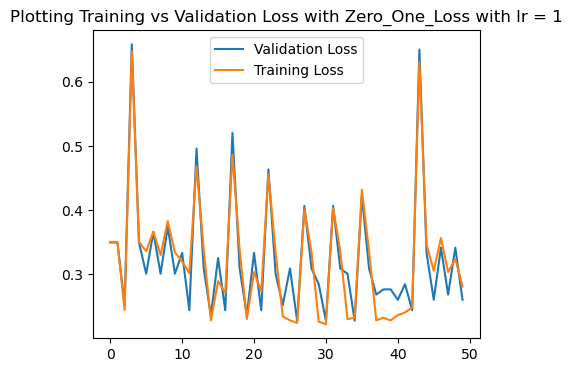

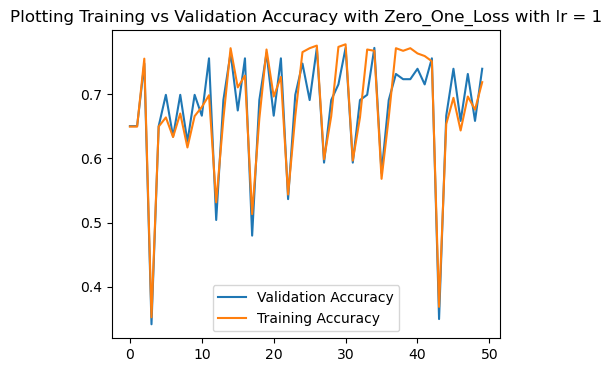

best accuracy:  0.7723577235772358
best weights:  [-125.60110551 -268.87593593   82.35710477  -89.18983279  -13.24650534
 -163.81283426 -116.22267294  -73.20841374]


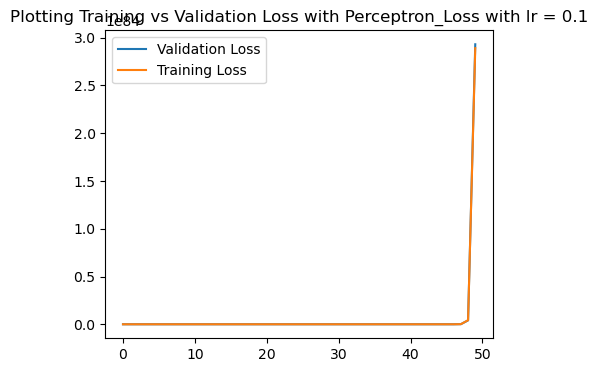

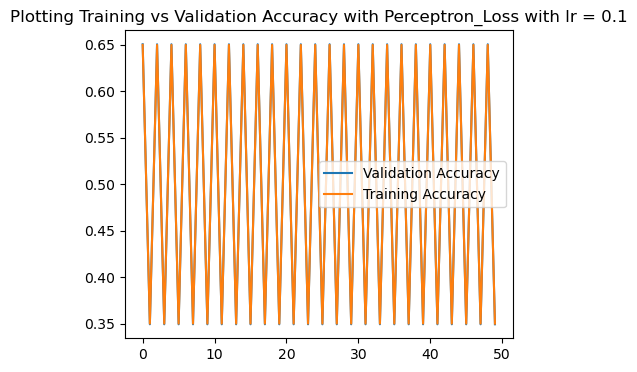

best accuracy:  0.6504065040650406
best weights:  [ 1.00825556e+84 -9.00181558e+83 -3.06230304e+83  1.18138244e+84
  1.61797384e+84 -9.45491980e+82  1.32333561e+84  1.06919763e+84]


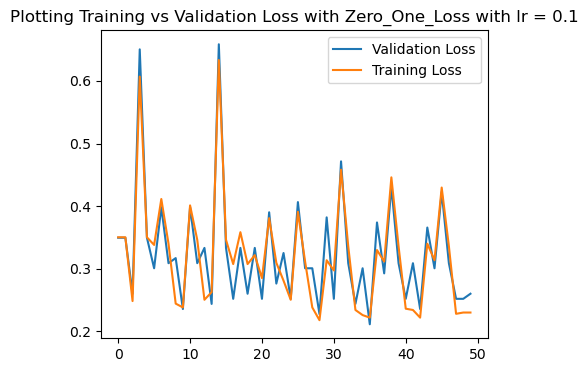

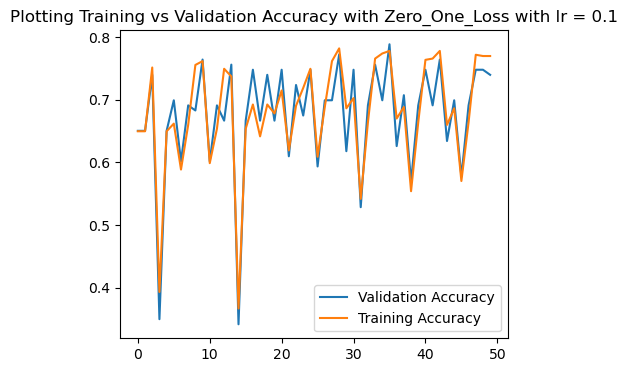

best accuracy:  0.7886178861788617
best weights:  [ -7.57161436 -25.76693847   7.91609181  -3.32607829   6.08016044
 -14.85436648  -6.1767963   -1.30502541]


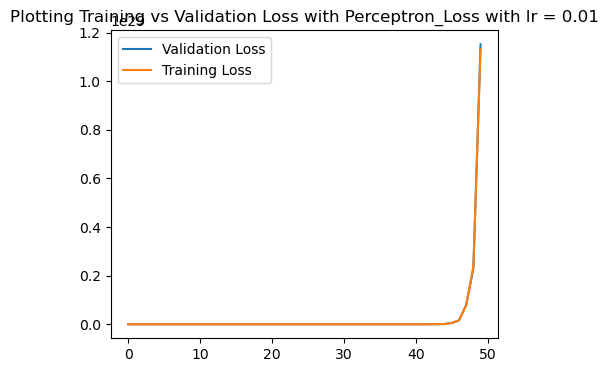

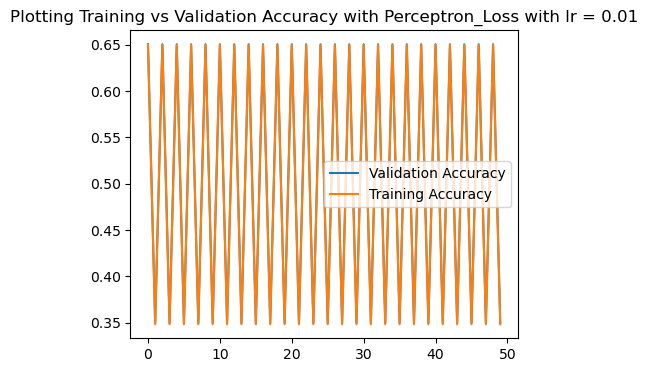

best accuracy:  0.6504065040650406
best weights:  [ 3.70135022e+28 -4.98887956e+28 -1.37615687e+28  4.66935710e+28
  6.54813527e+28 -9.94267359e+27  5.25832796e+28  3.87942043e+28]


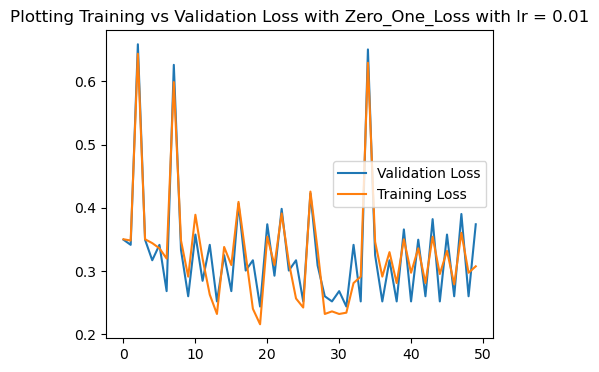

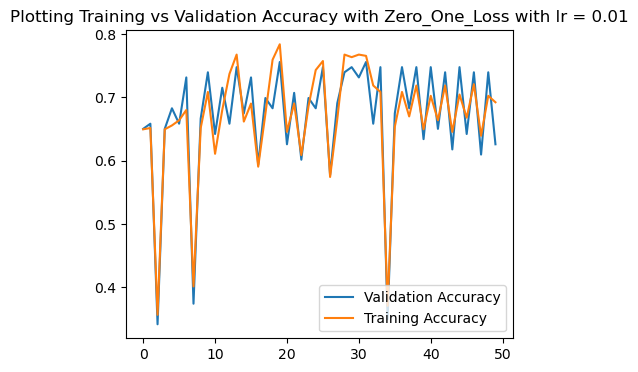

best accuracy:  0.7560975609756098
best weights:  [-0.65101874 -3.33473211  0.7716627  -0.26333961  0.85937516 -1.73911451
 -0.41480549 -0.08302   ]


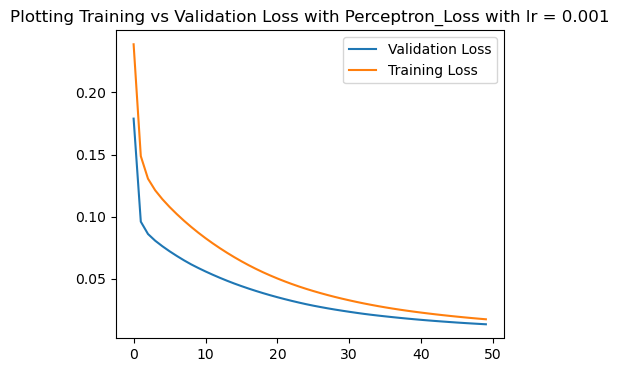

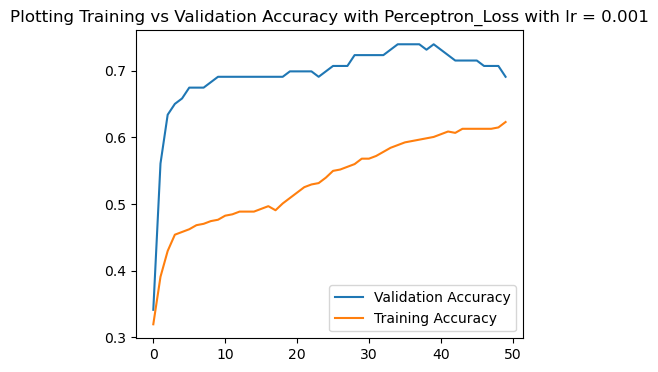

best accuracy:  0.7398373983739838
best weights:  [-0.04365287 -0.02362932  0.10397492  0.00113176  0.16393828 -0.08923095
 -0.13853421 -0.02731356]


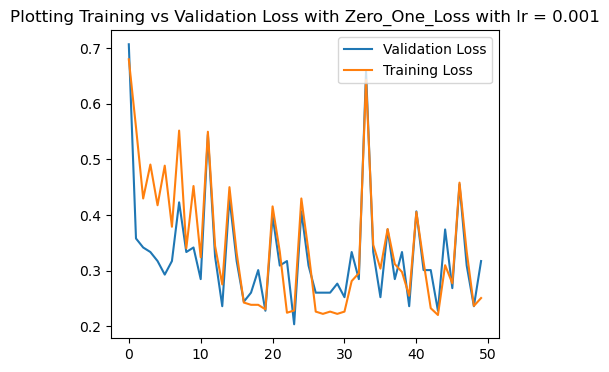

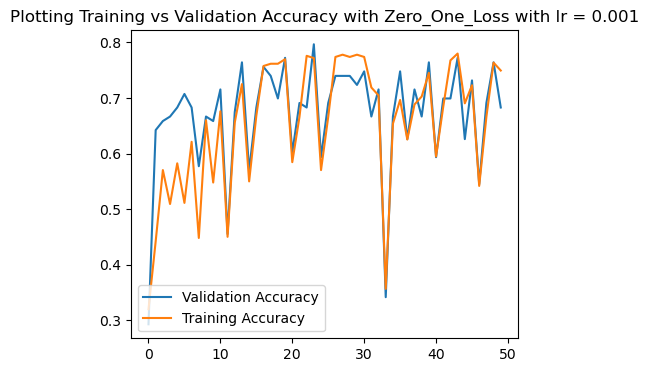

best accuracy:  0.7967479674796748
best weights:  [-0.06837085 -0.29902892  0.08208879 -0.02458083  0.07416657 -0.18197676
 -0.05232037 -0.01851934]


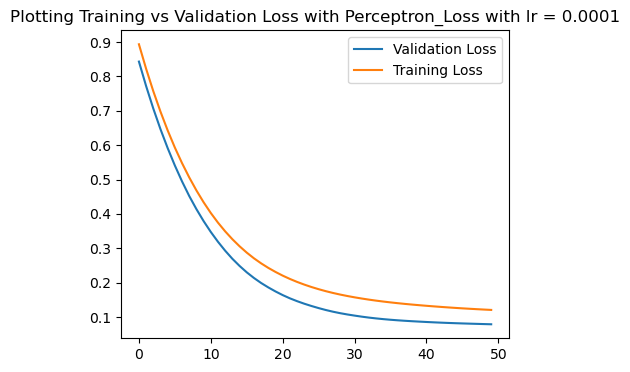

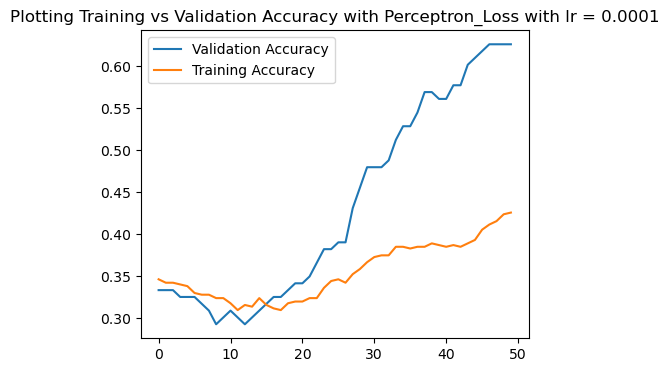

best accuracy:  0.6260162601626016
best weights:  [-0.25109115  0.32723317  0.25742629  0.18575347  0.41885336  0.01935201
 -0.23674191 -0.1046795 ]


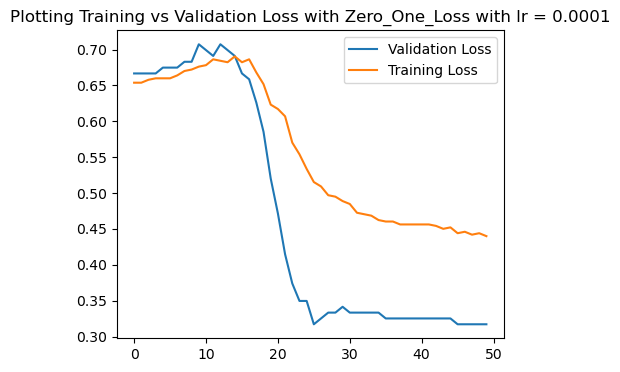

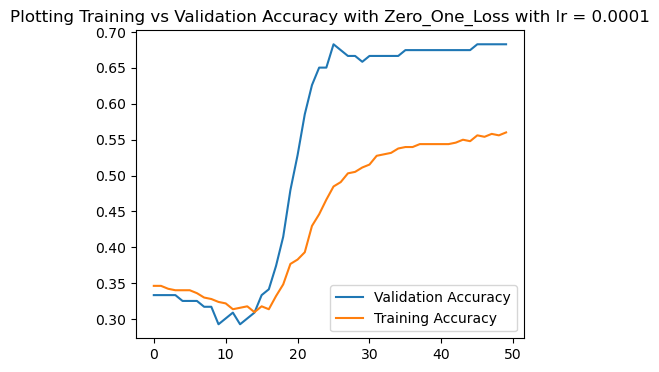

best accuracy:  0.6829268292682927
best weights:  [-0.2282473   0.19293328  0.23722483  0.12131328  0.34341382 -0.03693666
 -0.25595628 -0.09958597]


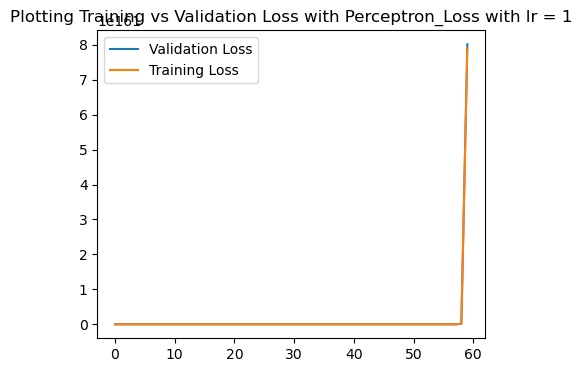

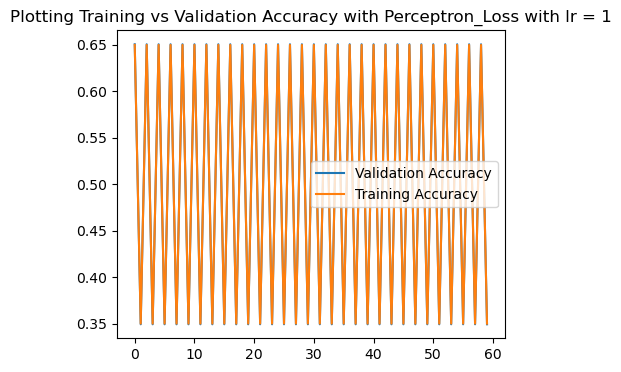

best accuracy:  0.6504065040650406
best weights:  [ 2.76753311e+161 -2.40461214e+161 -8.29912172e+160  3.22924484e+161
  4.41705983e+161 -2.34337361e+160  3.61618464e+161  2.93690335e+161]


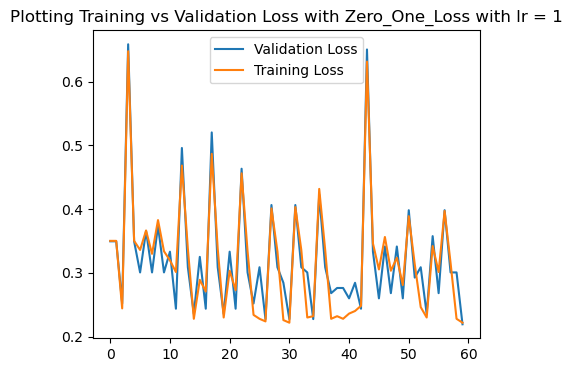

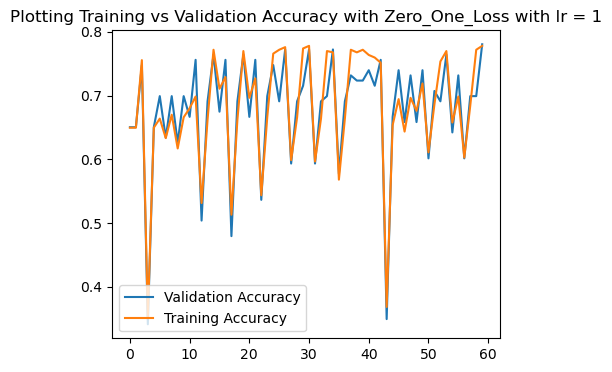

best accuracy:  0.7804878048780488
best weights:  [ -95.07170551 -287.95632858   84.63579967  -55.40196149   32.37756616
 -165.39108708  -80.09201702  -34.97508924]


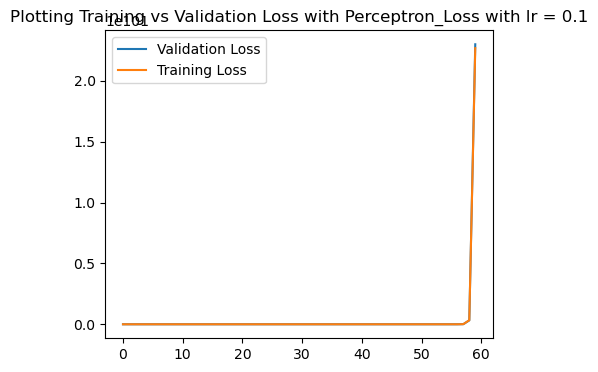

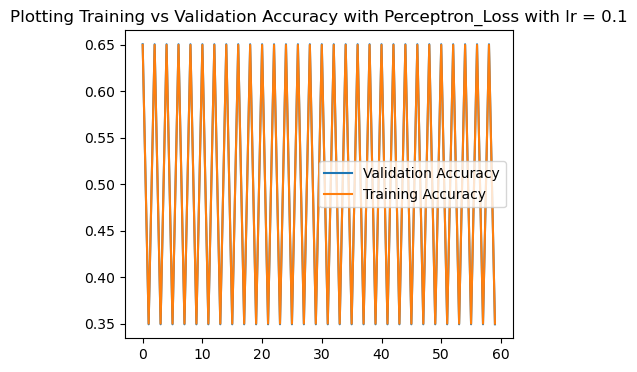

best accuracy:  0.6504065040650406
best weights:  [ 7.91381289e+100 -7.06553840e+100 -2.40360620e+100  9.27268830e+100
  1.26995007e+101 -7.42118058e+099  1.03868808e+101  8.39214805e+100]


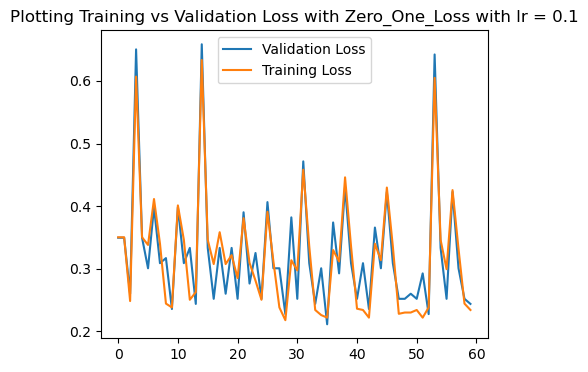

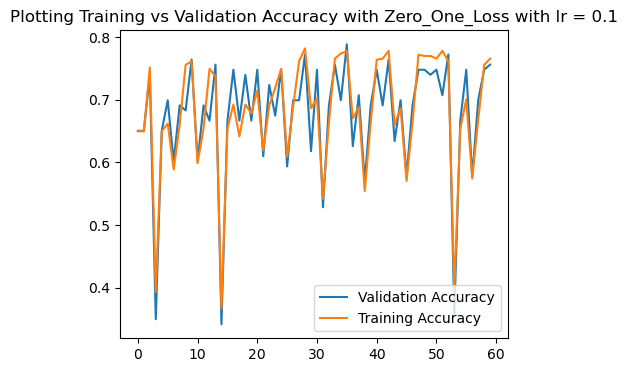

best accuracy:  0.7886178861788617
best weights:  [ -8.43043901 -29.30462621   7.00133905  -3.96244403   5.45982536
 -16.70146198  -6.34665181  -2.93502662]


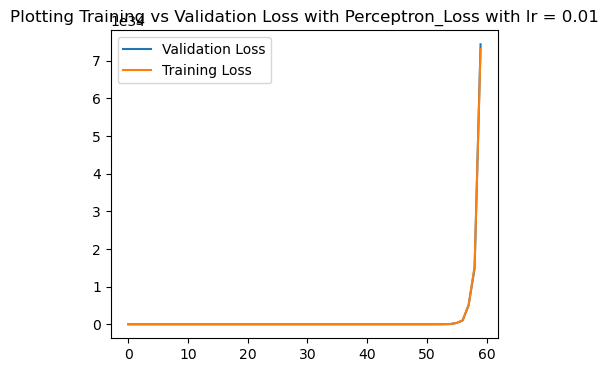

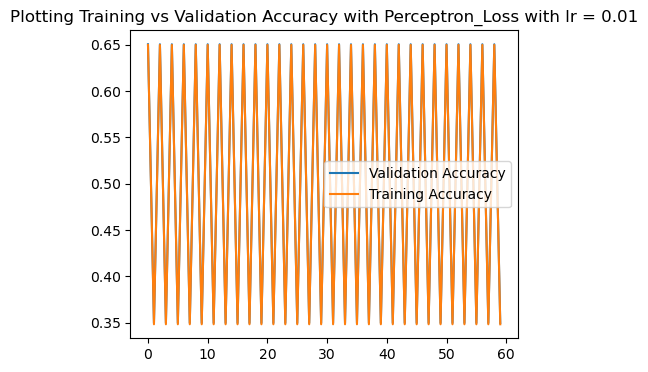

best accuracy:  0.6504065040650406
best weights:  [ 2.38847164e+34 -3.21931096e+34 -8.88030440e+33  3.01312396e+34
  4.22549460e+34 -6.41598133e+33  3.39318531e+34  2.50337988e+34]


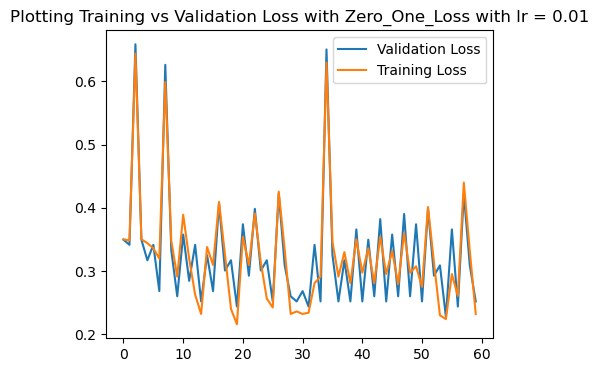

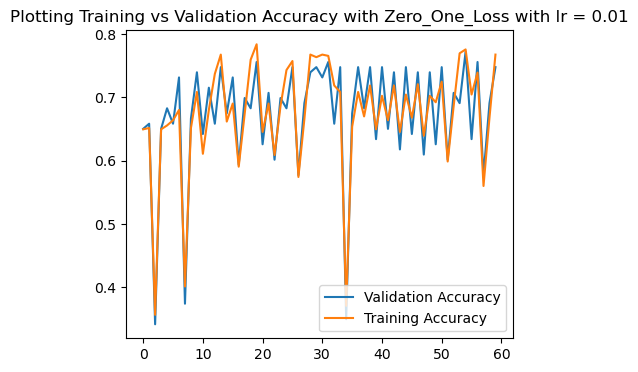

best accuracy:  0.7723577235772358
best weights:  [-0.88513662 -3.22588782  0.87067922 -0.46434977  0.61762528 -1.76301918
 -0.67051004 -0.30968679]


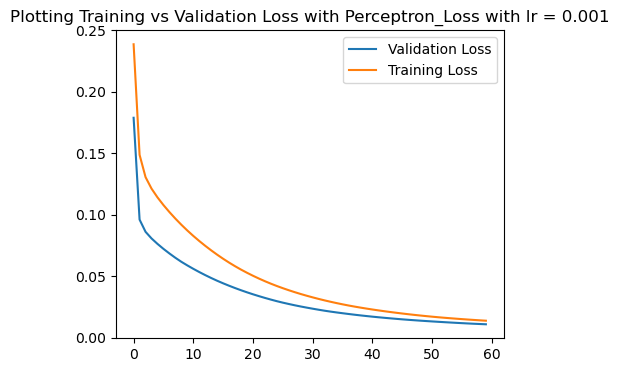

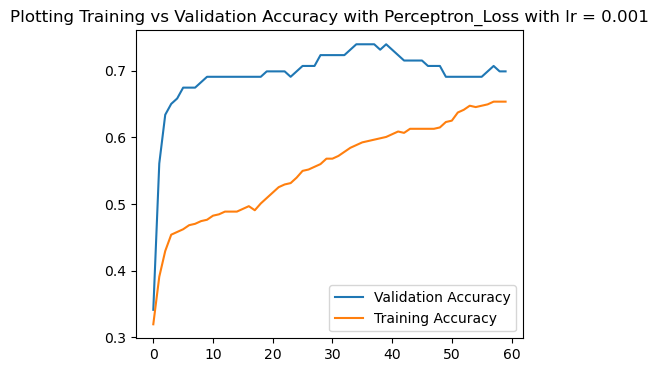

best accuracy:  0.7398373983739838
best weights:  [-0.03480264 -0.04003671  0.0939277  -0.00735617  0.14248867 -0.08869007
 -0.12134494 -0.02494849]


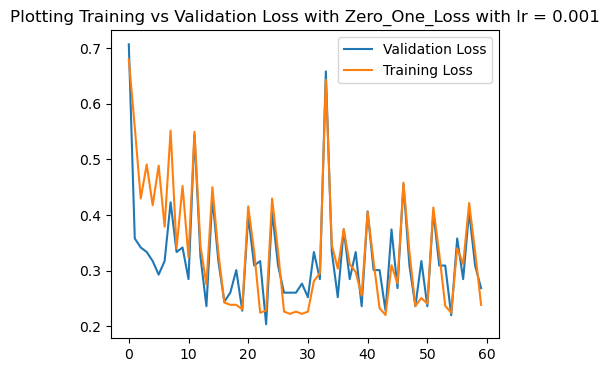

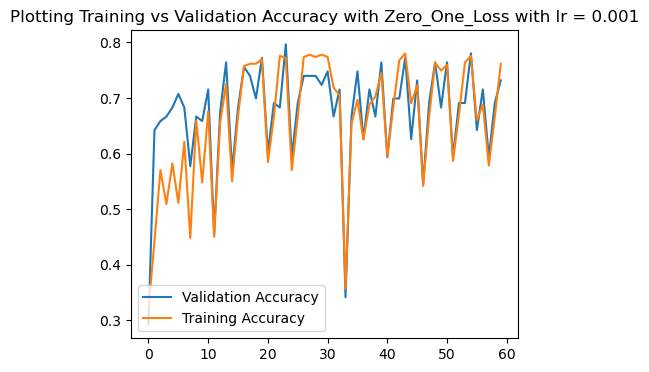

best accuracy:  0.7967479674796748
best weights:  [-0.0799591  -0.3074661   0.07844946 -0.03558084  0.06073154 -0.17965039
 -0.05770209 -0.02481935]


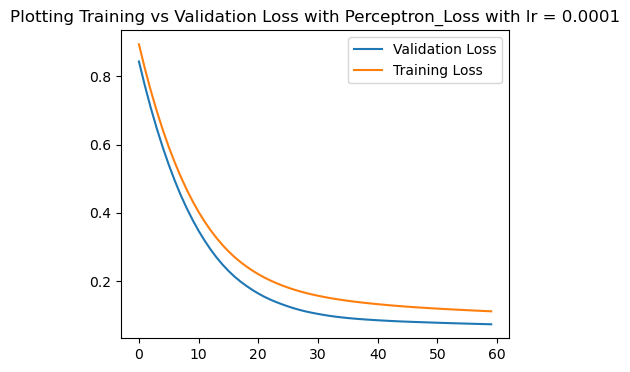

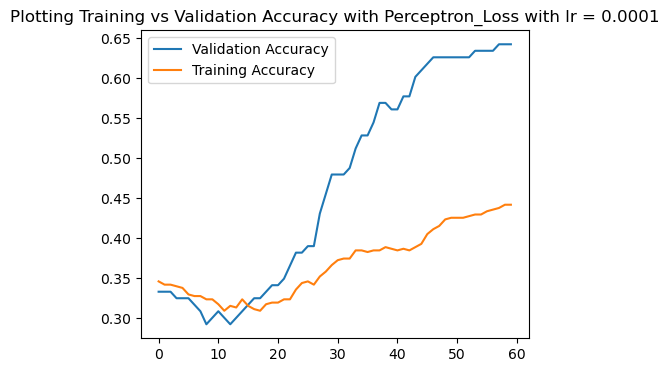

best accuracy:  0.6422764227642277
best weights:  [-0.24253986  0.30861858  0.24994828  0.17119582  0.40176817  0.01118396
 -0.23944782 -0.1031726 ]


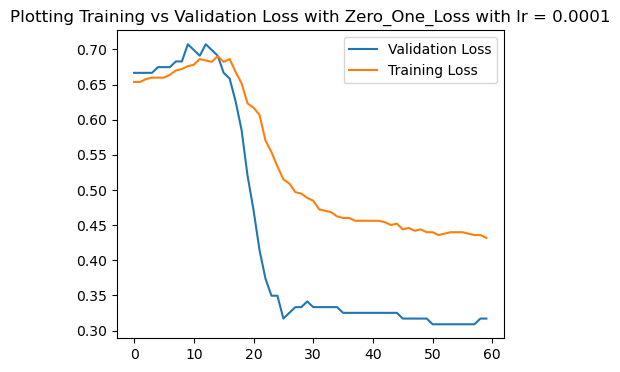

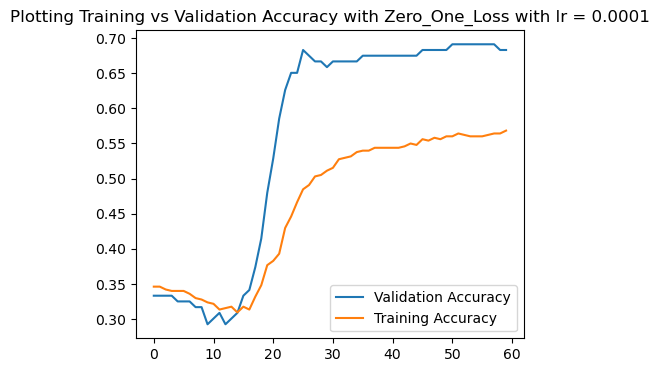

best accuracy:  0.6910569105691057
best weights:  [-0.19554141  0.1335363   0.21276581  0.09601225  0.32169774 -0.06077421
 -0.24368301 -0.07939597]


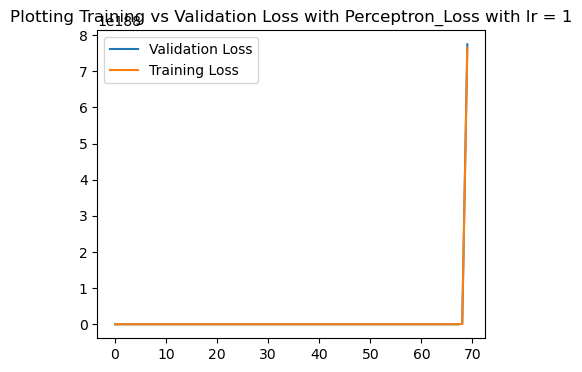

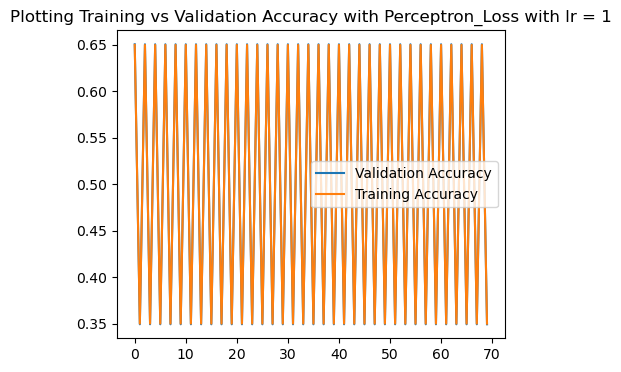

best accuracy:  0.6504065040650406
best weights:  [ 2.67550139e+188 -2.32464901e+188 -8.02314218e+187  3.12185932e+188
  4.27017464e+188 -2.26544691e+187  3.49593180e+188  2.83923937e+188]


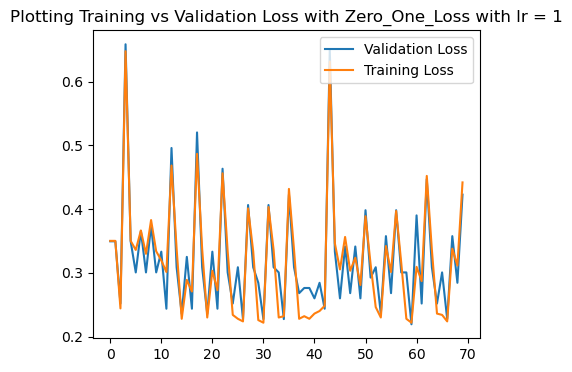

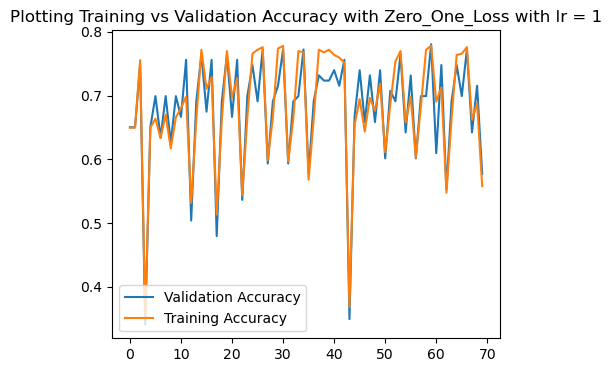

best accuracy:  0.7804878048780488
best weights:  [ -52.77759551 -286.05179619   76.58663187  -11.95752479   94.44608166
 -159.33894063  -30.6940658     7.92490366]


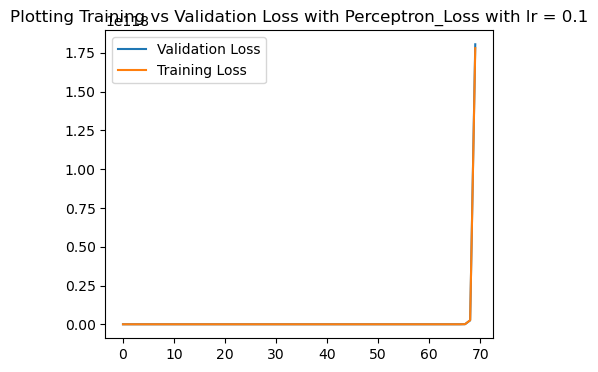

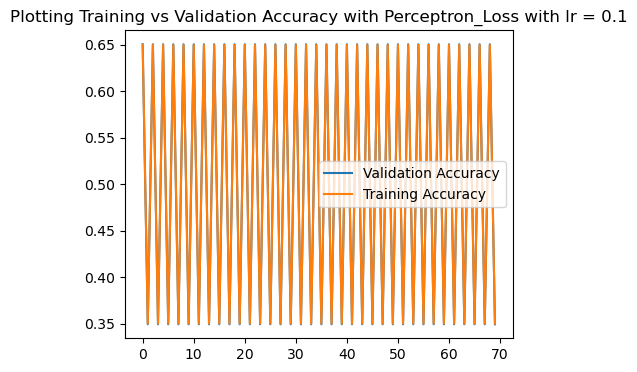

best accuracy:  0.6504065040650406
best weights:  [ 6.21156347e+117 -5.54575158e+117 -1.88659407e+117  7.27814680e+117
  9.96785692e+117 -5.82489565e+116  8.15267816e+117  6.58700946e+117]


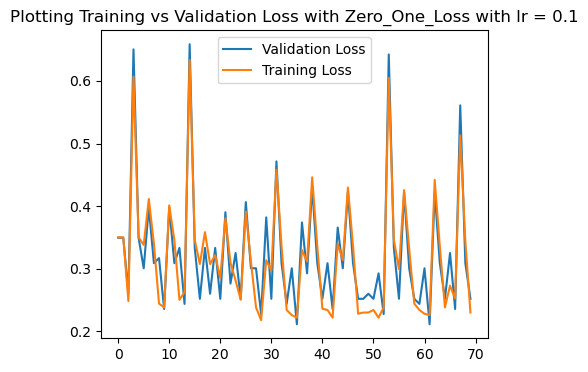

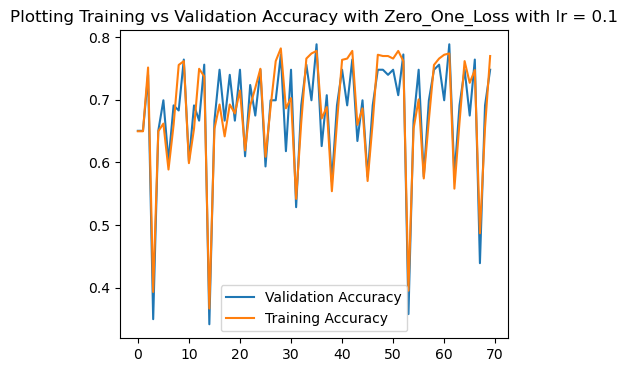

best accuracy:  0.7886178861788617
best weights:  [-10.34808771 -28.80211263   7.62757005  -5.952344     2.82270547
 -17.04810958  -8.54272364  -5.33502753]


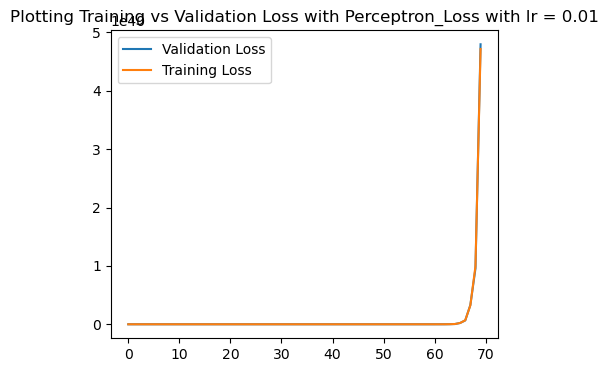

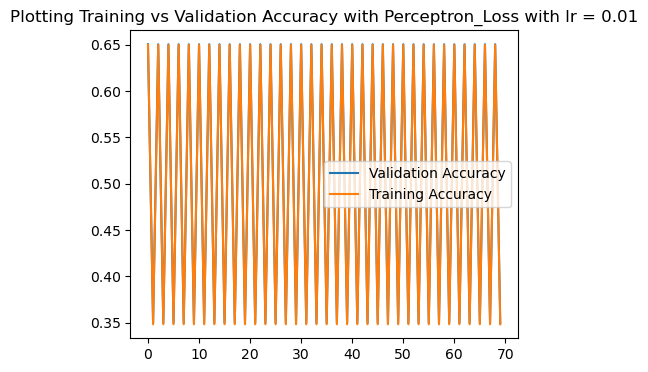

best accuracy:  0.6504065040650406
best weights:  [ 1.54127451e+40 -2.07741296e+40 -5.73043726e+39  1.94436103e+40
  2.72670064e+40 -4.14021601e+39  2.18961363e+40  1.61542451e+40]


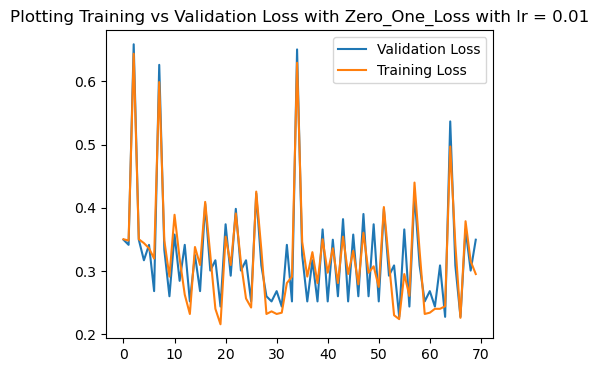

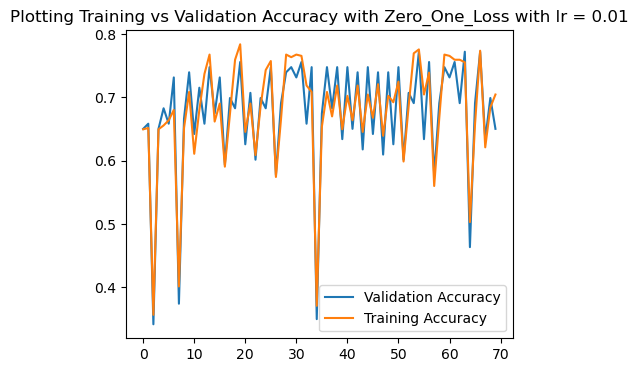

best accuracy:  0.7723577235772358
best weights:  [-0.66101908 -3.00171688  0.80576139 -0.25051142  0.81627737 -1.70556774
 -0.44644517 -0.08902016]


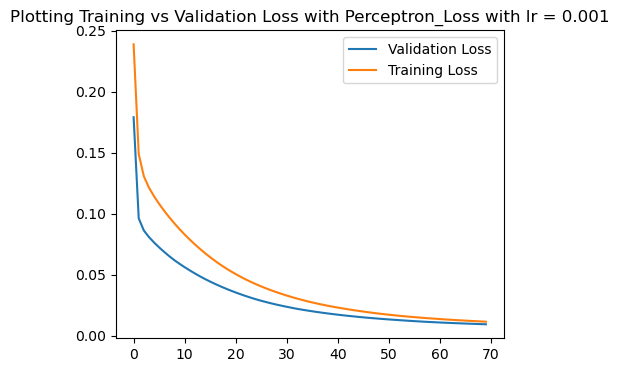

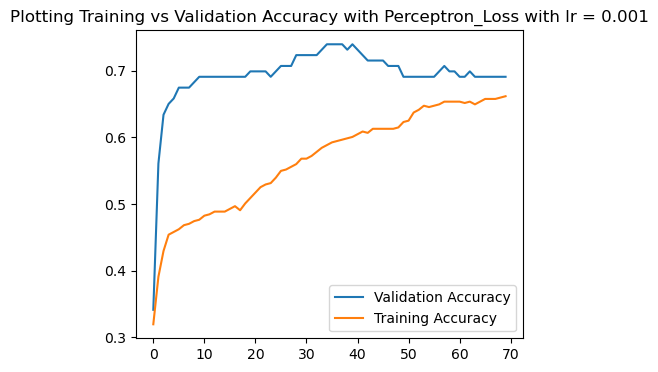

best accuracy:  0.7398373983739838
best weights:  [-0.02897425 -0.05084272  0.08627228 -0.01296633  0.12555644 -0.08689133
 -0.10689283 -0.02327617]


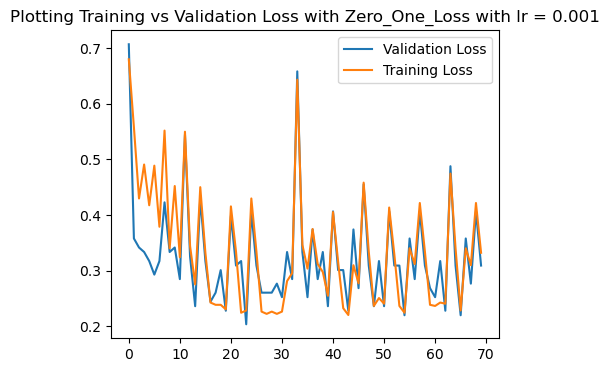

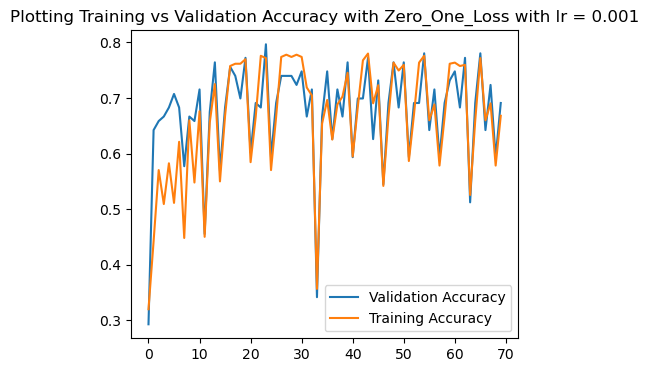

best accuracy:  0.7967479674796748
best weights:  [-0.15466502 -0.24713444  0.10451506 -0.12063133 -0.06064203 -0.17283669
 -0.16056204 -0.10535269]


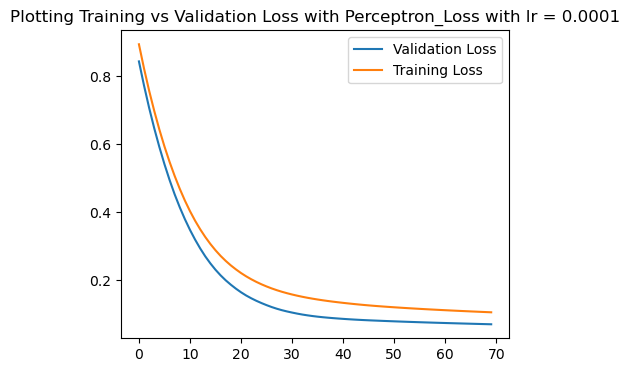

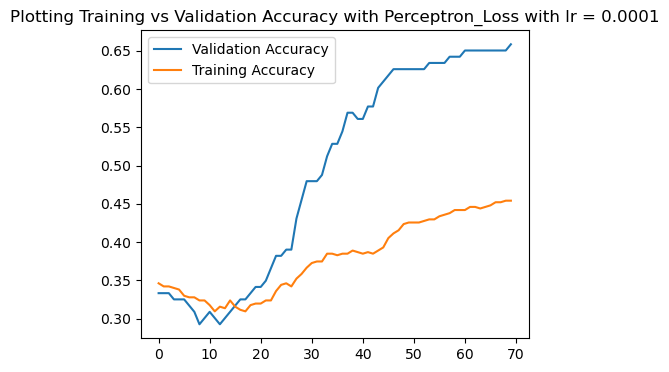

best accuracy:  0.6585365853658537
best weights:  [-0.23277307  0.29044091  0.24253806  0.15943421  0.3880656   0.00377697
 -0.2397269  -0.09997834]


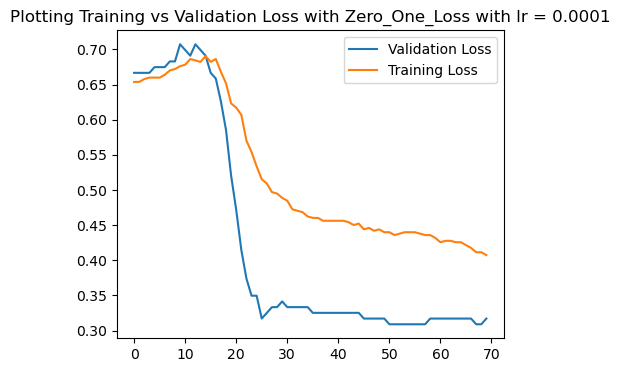

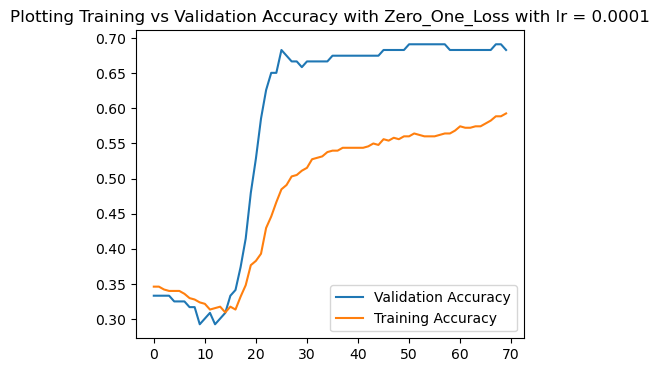

best accuracy:  0.6910569105691057
best weights:  [-0.164712    0.07884335  0.1884986   0.06869608  0.29625329 -0.08263069
 -0.23240394 -0.06289264]


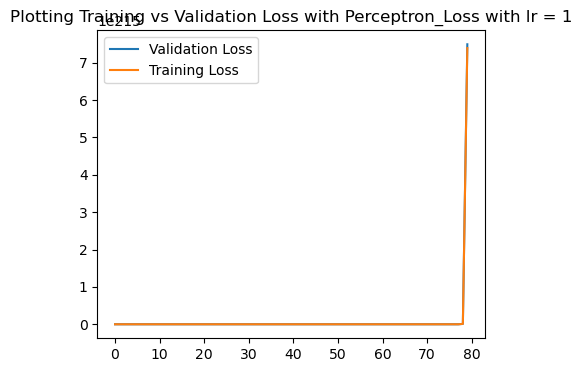

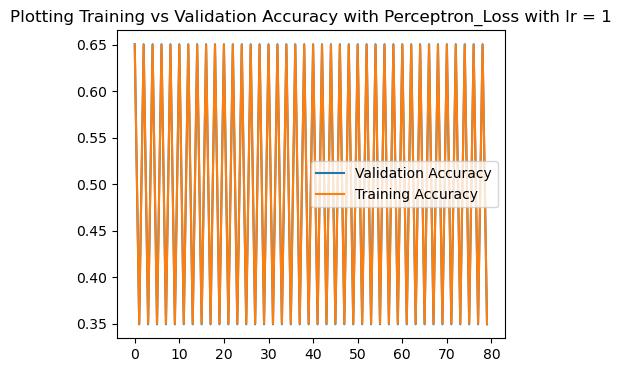

best accuracy:  0.6504065040650406
best weights:  [ 2.58653009e+215 -2.24734498e+215 -7.75634009e+214  3.01804481e+215
  4.12817397e+215 -2.19011159e+214  3.37967785e+215  2.74482312e+215]


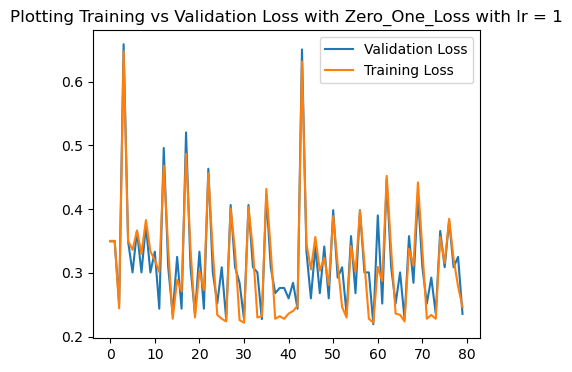

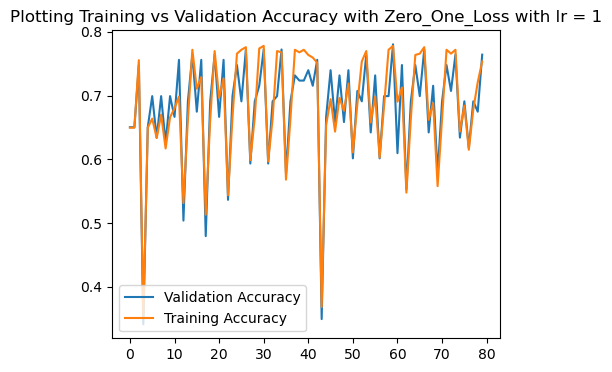

best accuracy:  0.7804878048780488
best weights:  [-107.07174051 -257.30304578   92.07844787  -70.39186549   15.11979786
 -158.44326653 -100.61635652  -47.90843994]


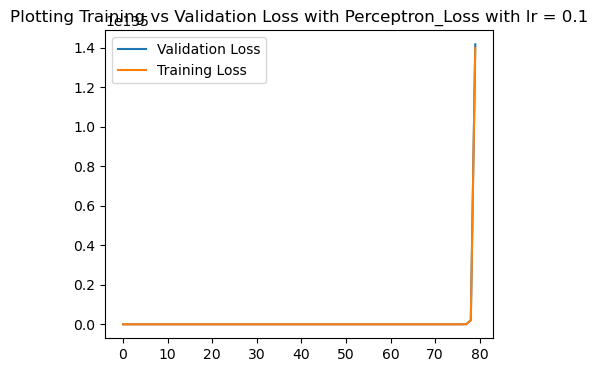

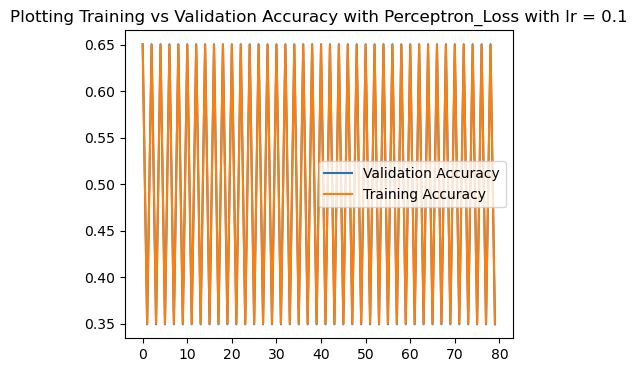

best accuracy:  0.6504065040650406
best weights:  [ 4.87546539e+134 -4.35286864e+134 -1.48079049e+134  5.71262822e+134
  7.82378568e+134 -4.57196923e+133  6.39904919e+134  5.17015350e+134]


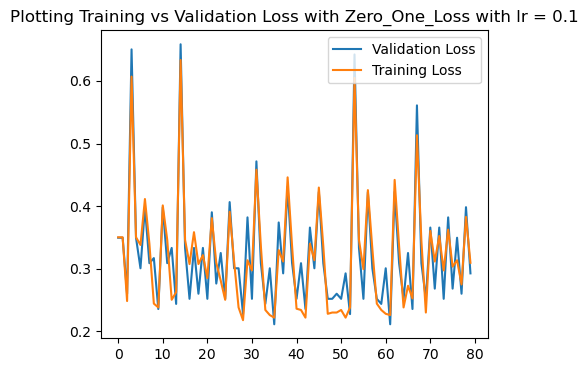

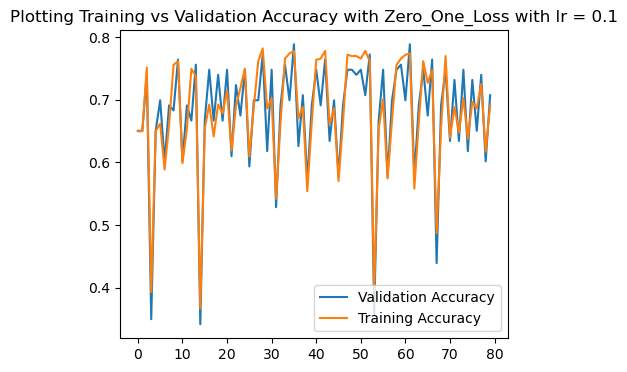

best accuracy:  0.7886178861788617
best weights:  [-14.48926701 -27.7990975   10.11281716 -11.1866874   -3.72505288
 -17.3422982  -14.52649854  -9.08836248]


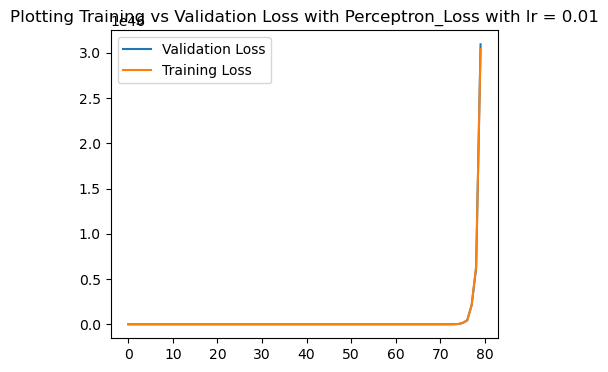

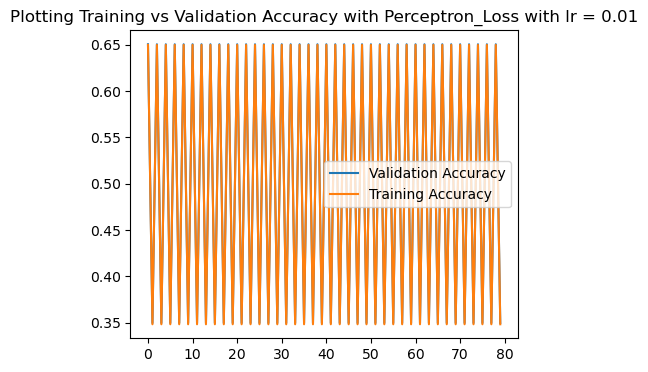

best accuracy:  0.6504065040650406
best weights:  [ 9.94580423e+45 -1.34054916e+46 -3.69783621e+45  1.25469110e+46
  1.75953281e+46 -2.67167059e+45  1.41295196e+46  1.04242922e+46]


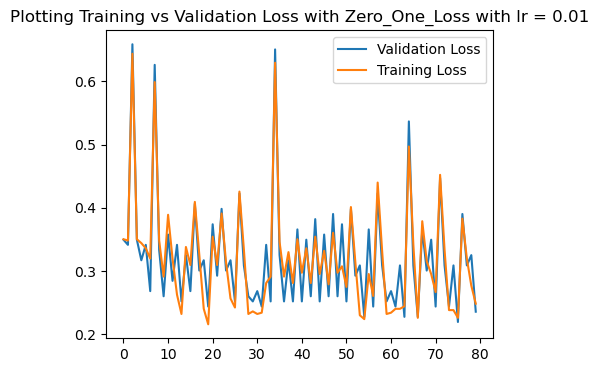

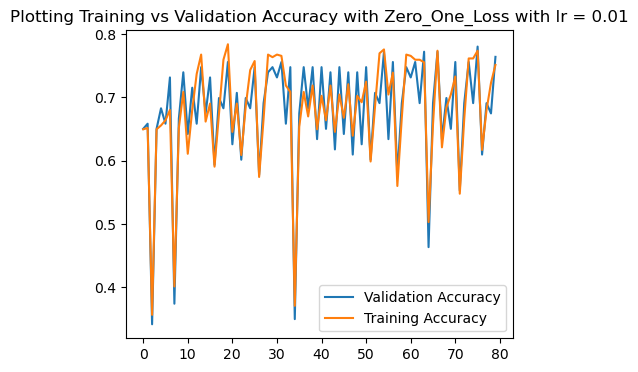

best accuracy:  0.7804878048780488
best weights:  [-1.08101932 -2.59498316  0.94051566 -0.71859219  0.16977577 -1.63546347
 -1.03313178 -0.50035358]


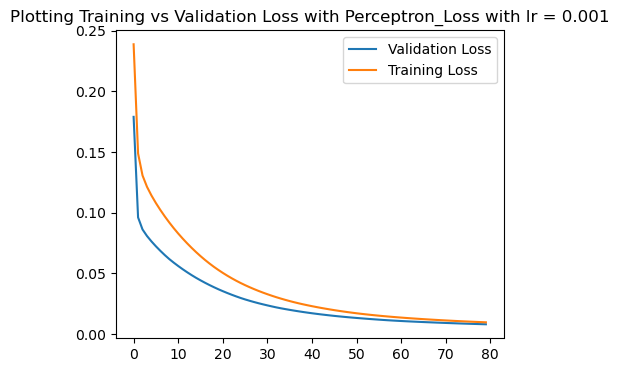

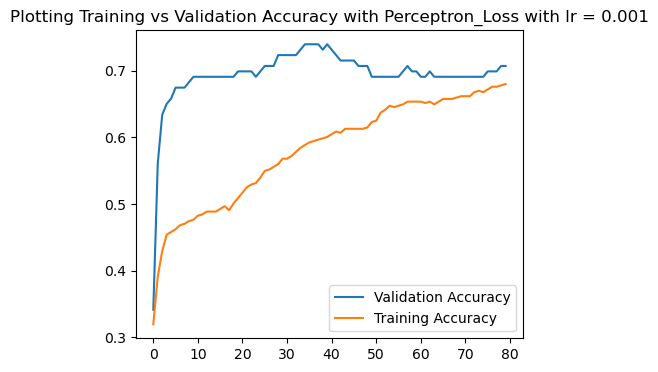

best accuracy:  0.7398373983739838
best weights:  [-0.02507873 -0.05781517  0.08021559 -0.01665801  0.11192001 -0.08446161
 -0.09465651 -0.02194328]


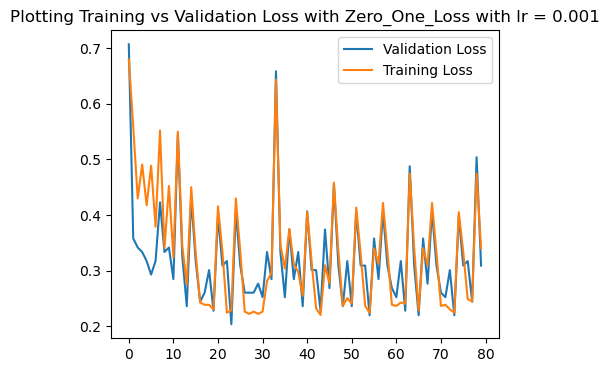

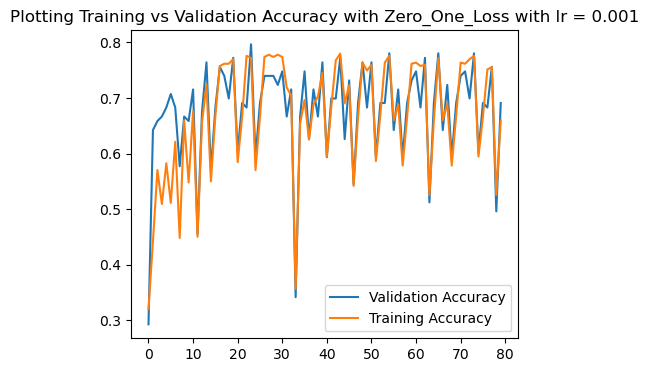

best accuracy:  0.7967479674796748
best weights:  [-0.17001798 -0.21165202  0.1052036  -0.13490406 -0.08361607 -0.16341941
 -0.18311627 -0.1239527 ]


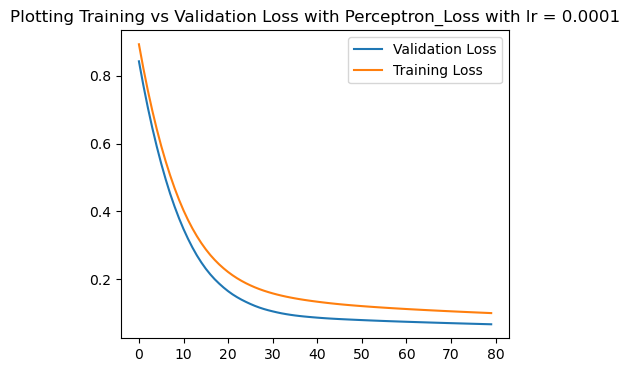

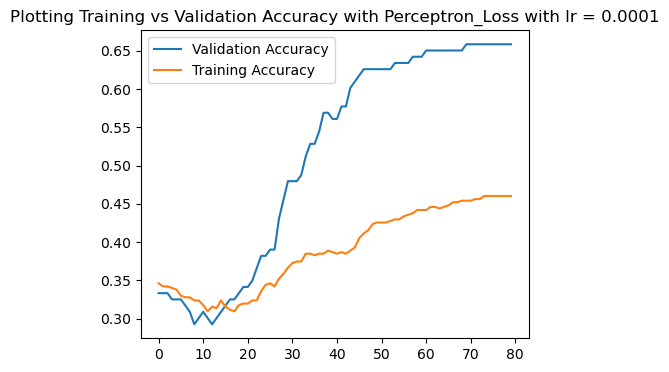

best accuracy:  0.6585365853658537
best weights:  [-0.22268978  0.27294428  0.23534302  0.14933169  0.37628385 -0.00303968
 -0.23872967 -0.09608514]


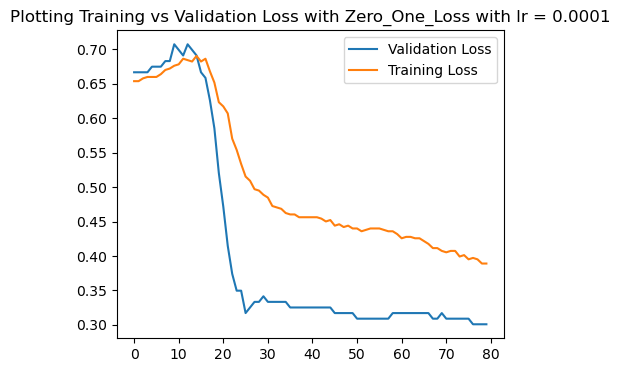

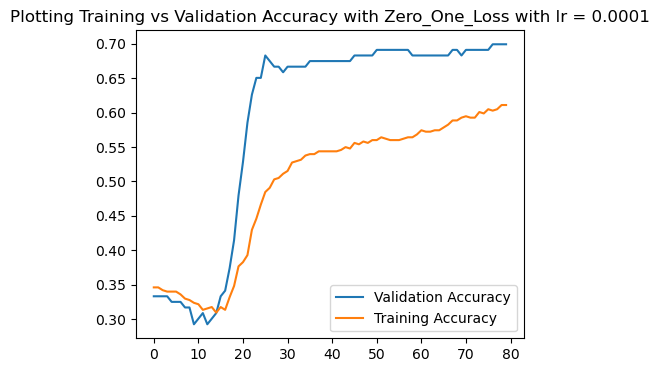

best accuracy:  0.6991869918699187
best weights:  [-0.13379435  0.03319813  0.16557401  0.04151626  0.26901499 -0.10105334
 -0.22030668 -0.0466793 ]


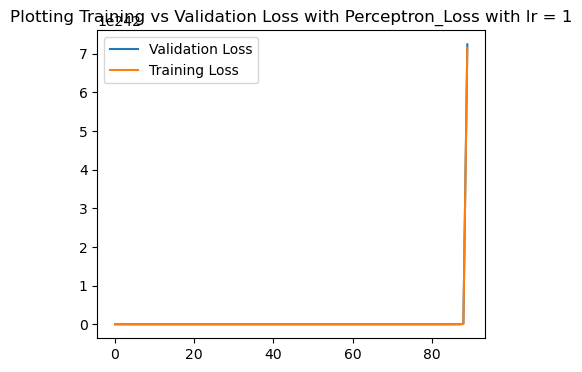

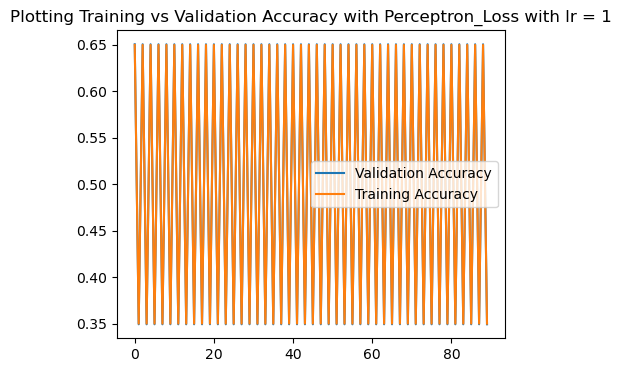

best accuracy:  0.6504065040650406
best weights:  [ 2.50051745e+242 -2.17261163e+242 -7.49841025e+241  2.91768255e+242
  3.99089540e+242 -2.11728148e+241  3.26728983e+242  2.65354659e+242]


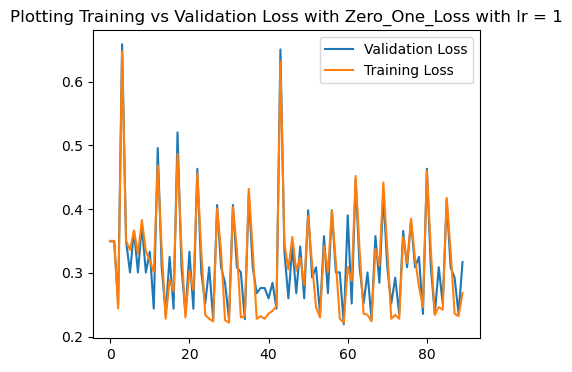

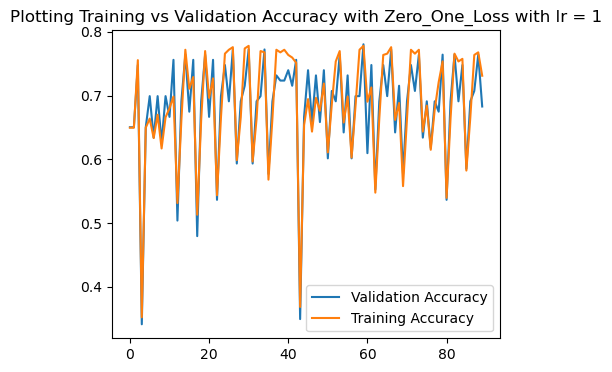

best accuracy:  0.7804878048780488
best weights:  [ -64.13056951 -264.37841276   83.47190507  -25.09894399   75.96845886
 -155.88590491  -54.758975     -1.27511034]


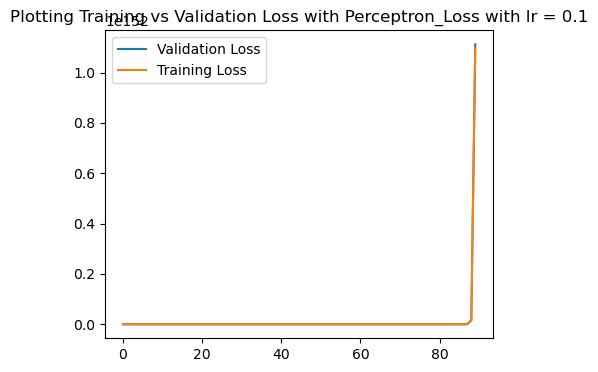

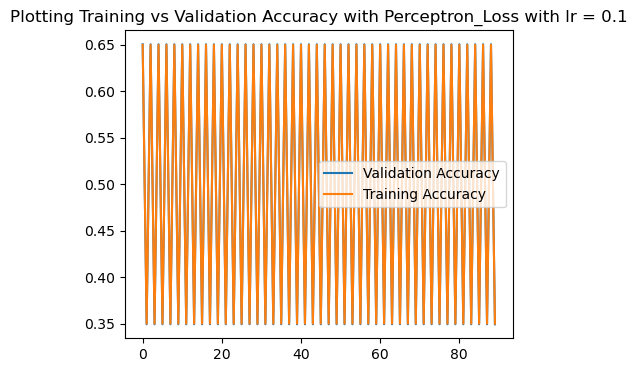

best accuracy:  0.6504065040650406
best weights:  [ 3.82676001e+151 -3.41657305e+151 -1.16227465e+151  4.48385037e+151
  6.14090099e+151 -3.58854543e+150  5.02262320e+151  4.05806115e+151]


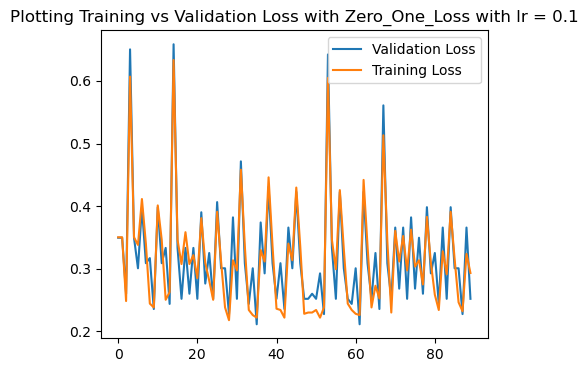

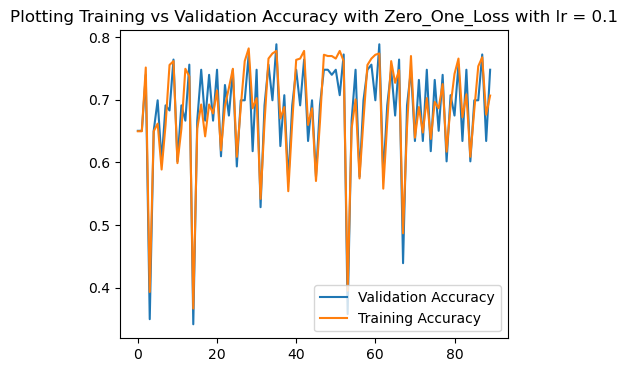

best accuracy:  0.7886178861788617
best weights:  [-12.49515071 -25.97045383   9.91937586  -9.14931369  -1.16051793
 -16.5507941  -12.55203164  -6.46502999]


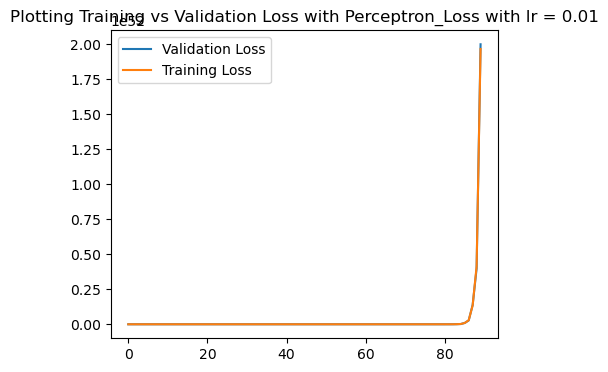

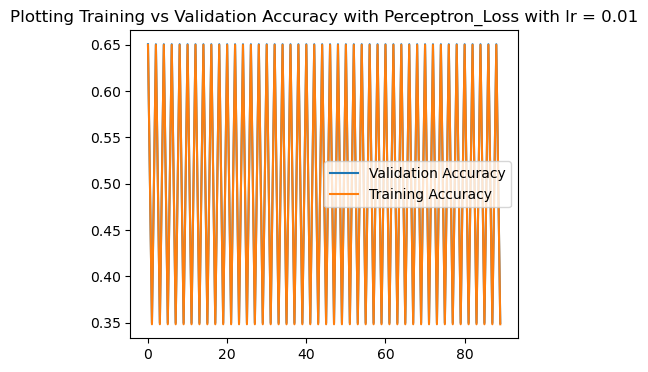

best accuracy:  0.6504065040650406
best weights:  [ 6.41800152e+51 -8.65052878e+51 -2.38620406e+51  8.09648891e+51
  1.13542193e+52 -1.72402206e+51  9.11774213e+51  6.72676854e+51]


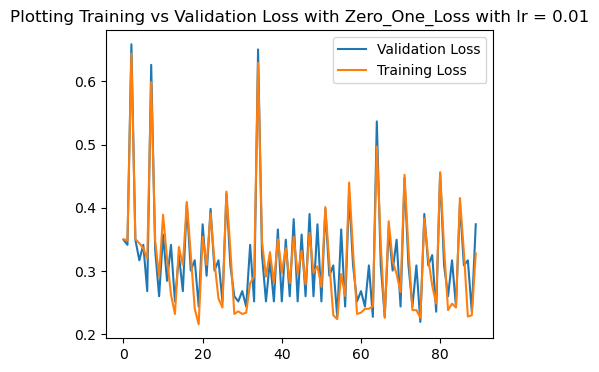

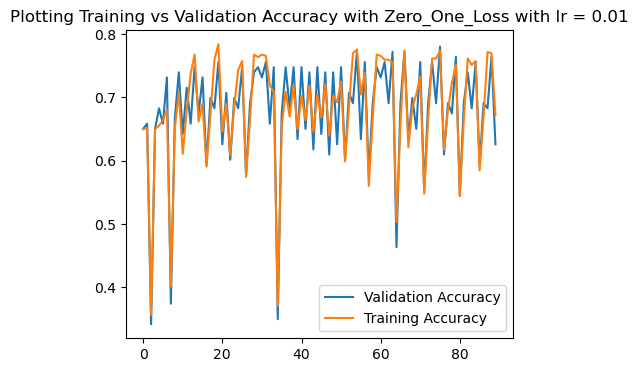

best accuracy:  0.7804878048780488
best weights:  [-0.58807818 -2.69608856  0.85084368 -0.18202664  0.84552005 -1.57355601
 -0.43756395  0.02631302]


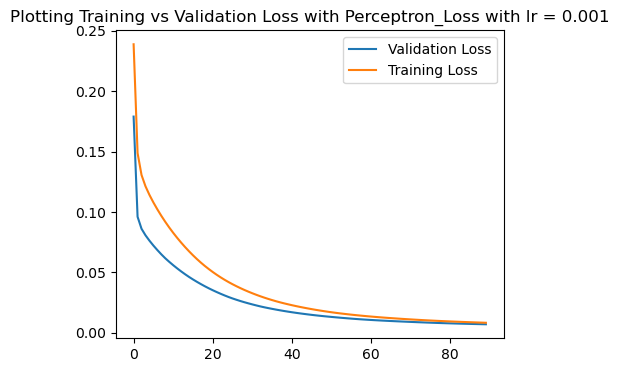

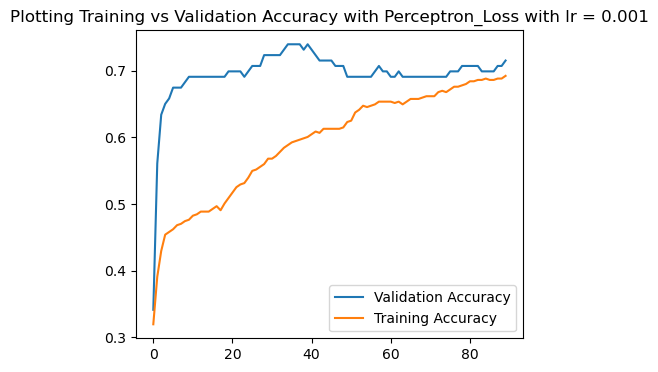

best accuracy:  0.7398373983739838
best weights:  [-0.02237459 -0.0621096   0.07520873 -0.01908072  0.10074115 -0.08180412
 -0.08420624 -0.0208012 ]


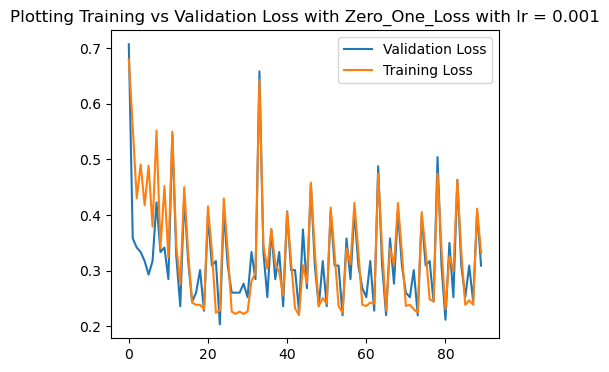

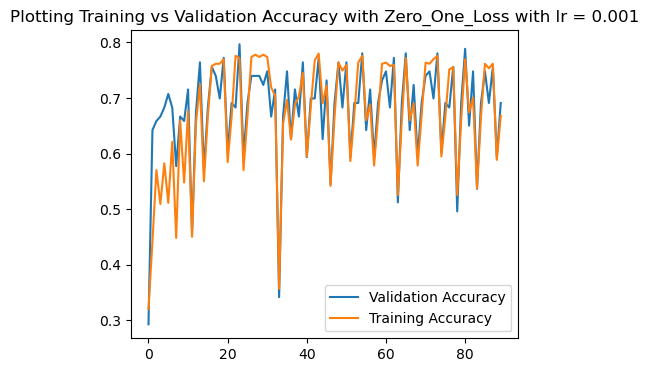

best accuracy:  0.7967479674796748
best weights:  [-0.14925328 -0.23670226  0.10643312 -0.11493438 -0.05587143 -0.16711689
 -0.16087972 -0.09818604]


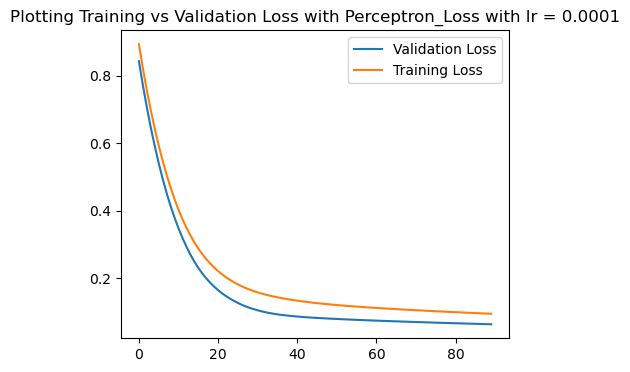

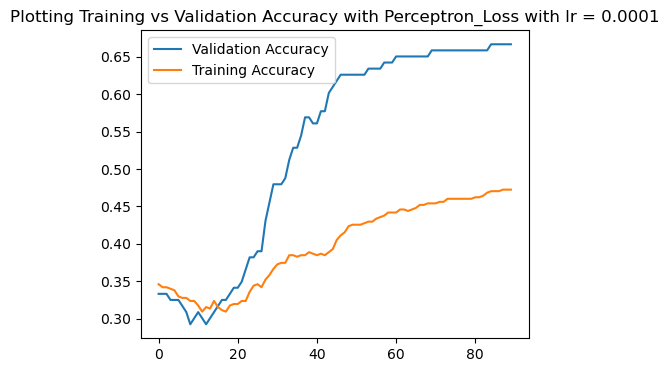

best accuracy:  0.6666666666666666
best weights:  [-0.21271276  0.2562312   0.22842223  0.14030796  0.36569187 -0.00936043
 -0.23702742 -0.0919677 ]


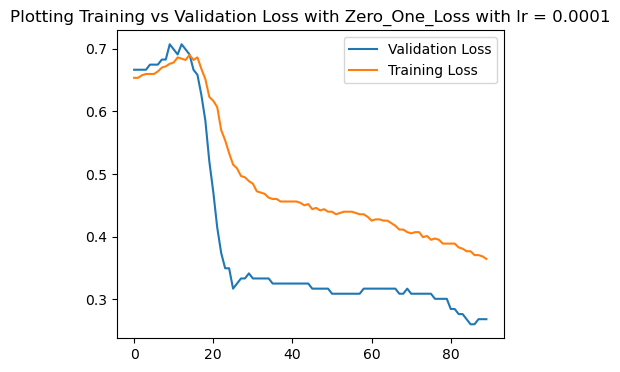

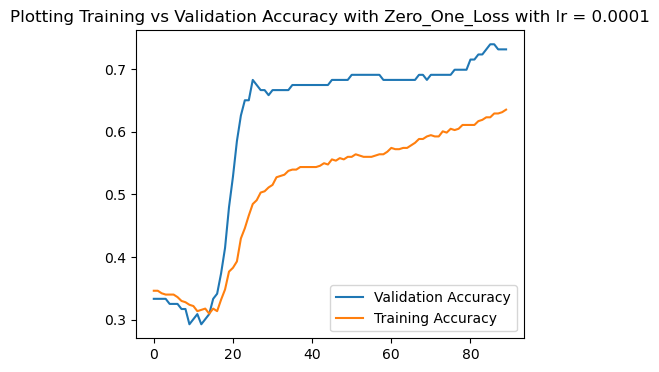

best accuracy:  0.7398373983739838
best weights:  [-0.10316493 -0.00748779  0.14343631  0.01862433  0.24255588 -0.11564097
 -0.20594955 -0.0339593 ]


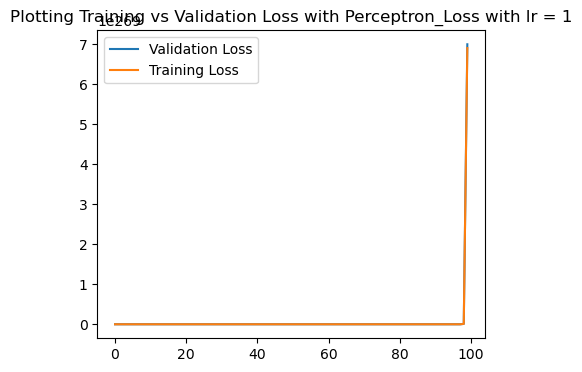

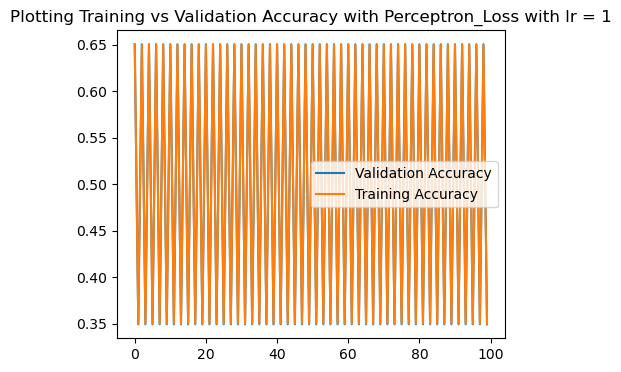

best accuracy:  0.6504065040650406
best weights:  [ 2.41736508e+269 -2.10036346e+269 -7.24905762e+268  2.82065774e+269
  3.85818191e+269 -2.04687326e+268  3.15863916e+269  2.56530538e+269]


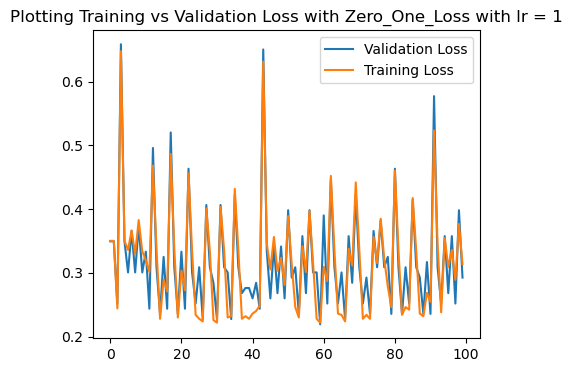

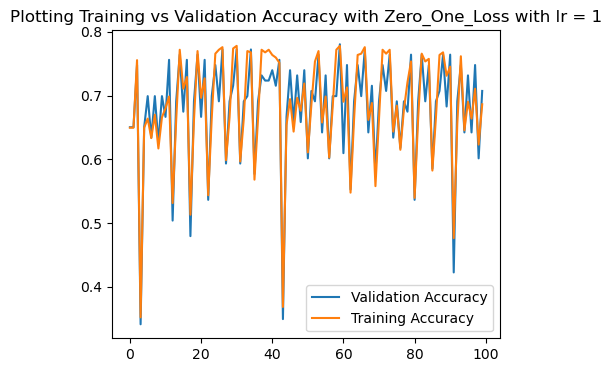

best accuracy:  0.7804878048780488
best weights:  [-141.30707201 -268.99147337  101.04568477 -110.18986079  -34.90392254
 -170.1839706  -143.62148554  -88.50846414]


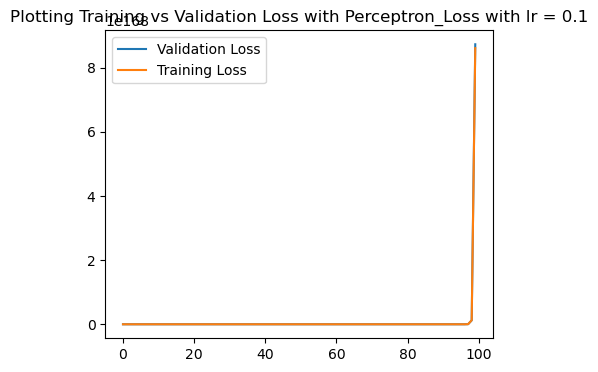

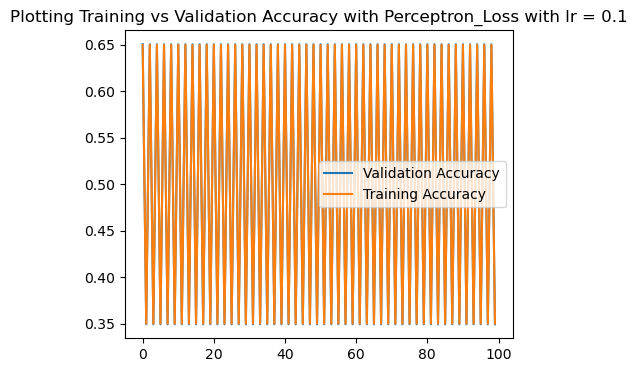

best accuracy:  0.6504065040650406
best weights:  [ 3.00362961e+168 -2.68167326e+168 -9.12271096e+167  3.51938080e+168
  4.82000230e+168 -2.81665464e+167  3.94226440e+168  3.18517822e+168]


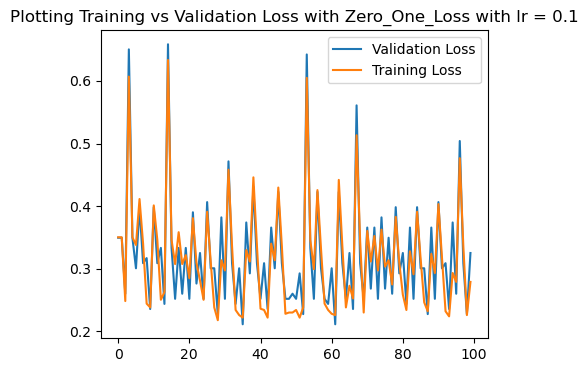

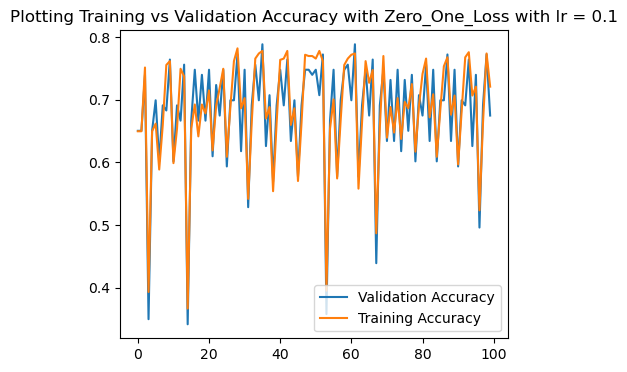

best accuracy:  0.7886178861788617
best weights:  [ -7.20691586 -30.86643271   8.21609774  -2.43719444   7.87517515
 -17.21532634  -4.69678042  -1.44836413]


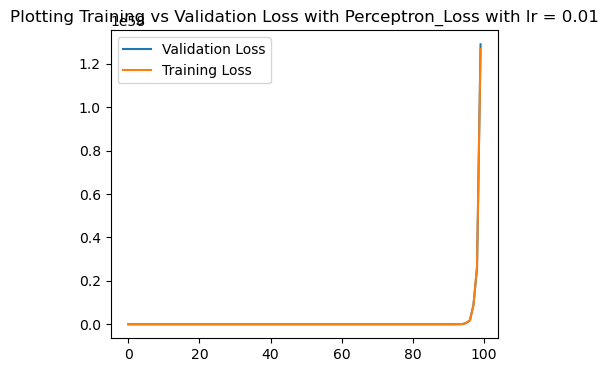

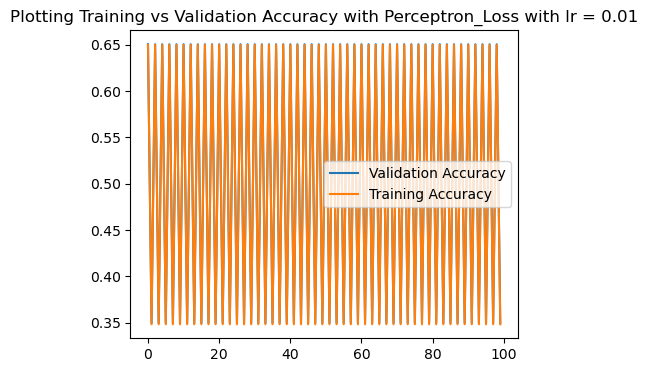

best accuracy:  0.6504065040650406
best weights:  [ 4.14151963e+57 -5.58216365e+57 -1.53981125e+57  5.22464317e+57
  7.32684809e+57 -1.11250694e+57  5.88365521e+57  4.34076619e+57]


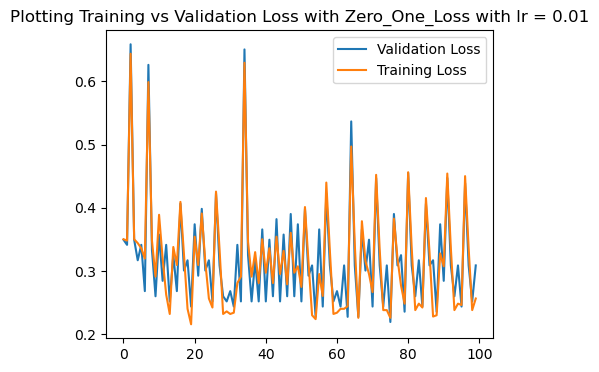

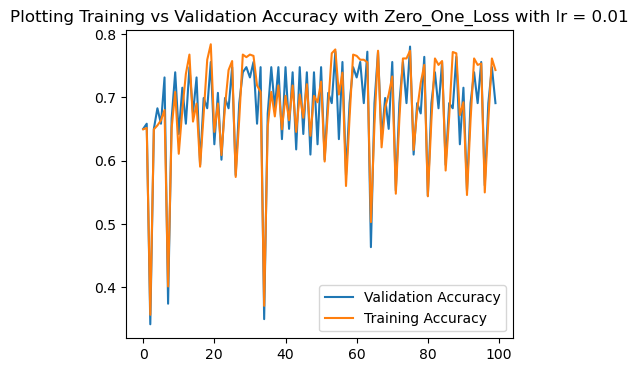

best accuracy:  0.7804878048780488
best weights:  [-0.67219595 -2.87382714  0.85067985 -0.27020855  0.76566148 -1.63372005
 -0.55215833 -0.09502039]


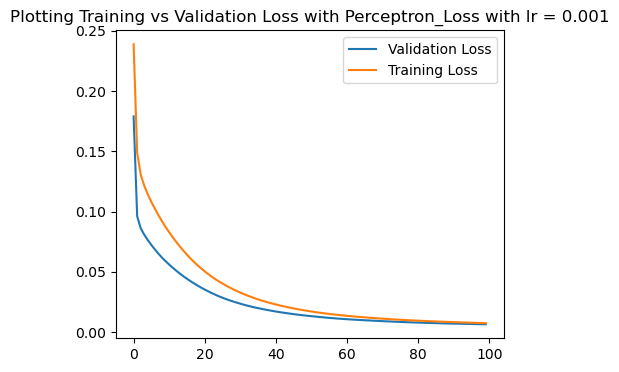

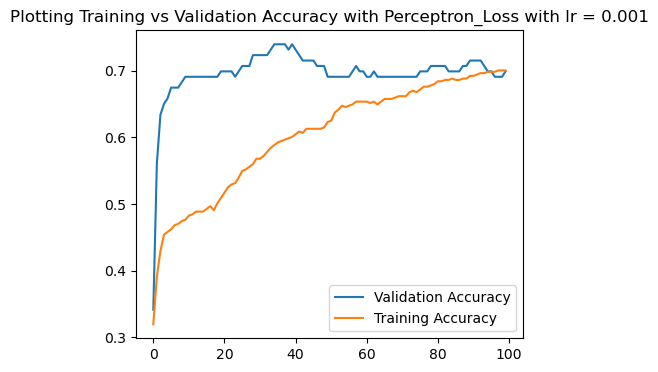

best accuracy:  0.7398373983739838
best weights:  [-0.02036206 -0.06450711  0.07099633 -0.02067583  0.09141022 -0.07908782
 -0.07520151 -0.0197623 ]


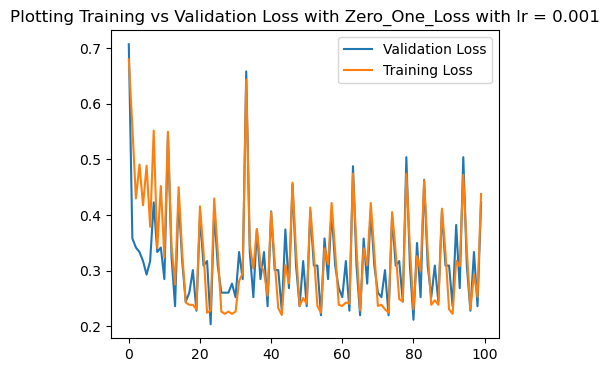

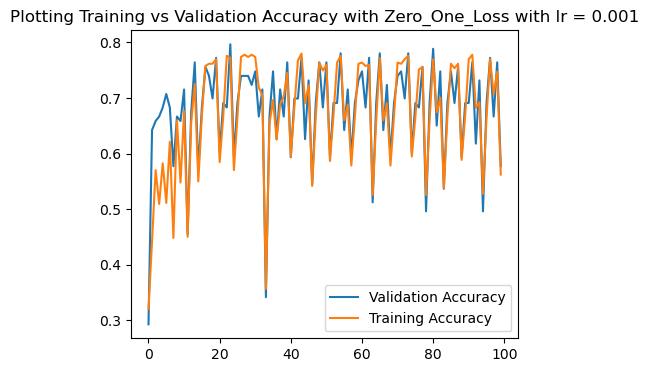

best accuracy:  0.7967479674796748
best weights:  [-0.05242974 -0.29618968  0.07610526 -0.00606571  0.0949465  -0.16860126
 -0.030229    0.00334729]


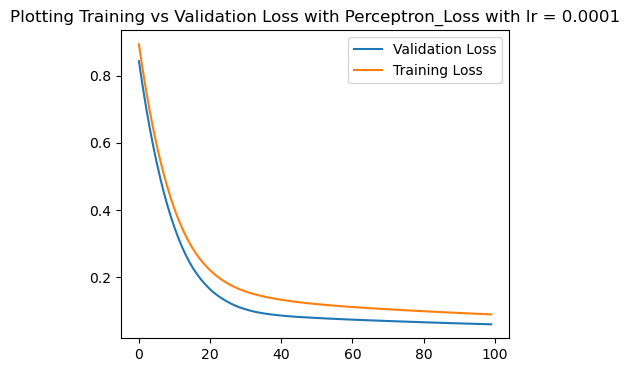

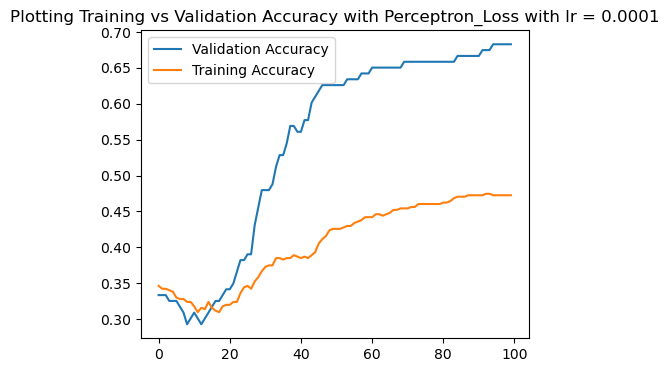

best accuracy:  0.6829268292682927
best weights:  [-0.20303473  0.24032668  0.2217968   0.13204845  0.35591108 -0.01524639
 -0.2349276  -0.08785268]


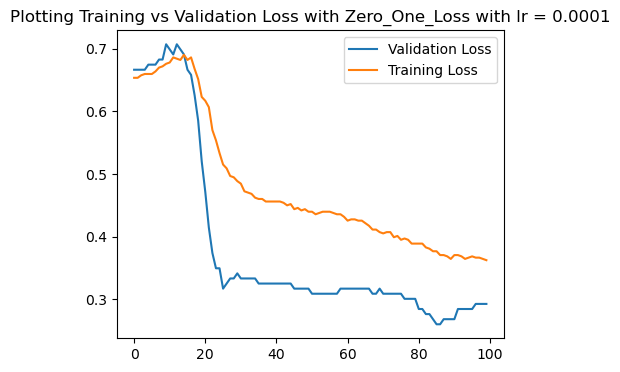

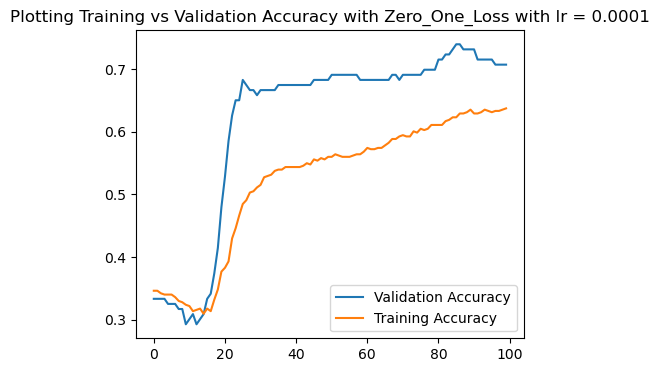

best accuracy:  0.7398373983739838
best weights:  [-0.07971199 -0.04153352  0.12508549  0.0008617   0.2151937  -0.12406794
 -0.18887278 -0.02575597]


In [18]:
accuracy_table = list()
learning_Rates = [1,.1,.01,.001,0.0001]
epoch = np.arange(10,101,10)
loss =["perceptron","zero_one"]
for e in epoch:
    for lr_rate in learning_Rates:
        for l in loss:
            best_weights = 0
            best_accu = 0
            best_epoch = 0
            e_val_loss_list = []
            e_train_loss_list = []
            e_val_acc_list = []
            e_train_acc_list = []
            np.random.seed(84)
            weights = np.random.rand(8)
            for i in range(e):
                weights = update_weights(weights,X_train,y_train,l,lr_rate)
                train_acc = predict(X_train,y_train,weights)
                val_acc = predict(X_Val,y_Val,weights)
                e_val_acc_list.append(val_acc)
                e_train_acc_list.append(train_acc)
                if l =="zero_one":
                    e_train_loss = zero_one_loss(X_train,y_train,weights)
                    e_val_loss = zero_one_loss(X_Val,y_Val,weights)
                else:
                    e_train_loss = perceptron_loss(X_train,y_train,weights)
                    e_val_loss = perceptron_loss(X_Val,y_Val,weights)
                e_val_loss_list.append(e_val_loss)
                e_train_loss_list.append(e_train_loss)
            #     print("Iteration ",i)
            #     print("Training accuracy:",train_acc," Validation accuracy:",val_acc,"Validation Loss:",val_loss,"Training Loss ",train_loss)
                if val_acc>best_accu:
                    best_epoch=(i+1)
                    best_accu = val_acc
                    best_weights = weights

            accuracy_table.append((best_accu,lr_rate,l,best_epoch,e,best_weights))
            #Plotting Loss Curve
            plt.figure(figsize=(5, 4))
            if l =="zero_one":
                plt.title("Plotting Training vs Validation Loss with Zero_One_Loss with lr = "+ str(lr_rate))
            else:
                plt.title("Plotting Training vs Validation Loss with Perceptron_Loss with lr = "+ str(lr_rate))
            plt.plot(np.arange(e), e_val_loss_list, label = "Validation Loss")
            plt.plot(np.arange(e), e_train_loss_list, label = "Training Loss")
            plt.legend()
            plt.show()

            #Plotting Validation Curve
            plt.figure(figsize=(5, 4))
            if l =="zero_one":
                plt.title("Plotting Training vs Validation Accuracy with Zero_One_Loss with lr = "+ str(lr_rate))
            else:
                plt.title("Plotting Training vs Validation Accuracy with Perceptron_Loss with lr = "+ str(lr_rate))

            plt.plot(np.arange(e), e_val_acc_list, label = "Validation Accuracy")
            plt.plot(np.arange(e), e_train_acc_list, label = "Training Accuracy")
            plt.legend()
            plt.show()
            print("best accuracy: ",best_accu)
            print("best weights: " ,best_weights)

In [19]:
import pandas as pd
accuracy_table.sort(reverse=True)
df = pd.DataFrame(accuracy_table, columns=["Val_Accuracy", "Learning Rate","Loss","nth Epoch","Epoch Range","Best Weights"])
df

,Val_Accuracy,Learning Rate,Loss,nth Epoch,Epoch Range,Best Weights
0,0.796748,0.0010,zero_one,24,100,"[-0.05242974486851241, -0.2961896801944002, 0...."
1,0.796748,0.0010,zero_one,24,90,"[-0.14925328036851254, -0.23670225658440022, 0..."
2,0.796748,0.0010,zero_one,24,80,"[-0.17001797686851272, -0.2116520169644002, 0...."
3,0.796748,0.0010,zero_one,24,70,"[-0.1546650178685129, -0.2471344354444003, 0.1..."
4,0.796748,0.0010,zero_one,24,60,"[-0.07995910486851306, -0.3074661009644003, 0...."
...,...,...,...,...,...,...
95,0.479675,0.0001,zero_one,20,20,"[-0.2744531867685141, 0.37835085688959924, 0.3..."
96,0.479675,0.0001,perceptron,30,30,"[-0.25348978923140203, 0.3631431157104548, 0.2..."
97,0.341463,0.0001,perceptron,20,20,"[-0.23006416383874562, 0.3772501227374562, 0.2..."
98,0.333333,0.0001,zero_one,1,10,"[-0.13851198281851426, 0.3913709569255992, 0.2..."


Testing accuracy: 0.564935064935065
F1 Score : 0.5109489051094891
Precision : 0.9459459459459459
Recall : 0.35
Confusion Matrix :


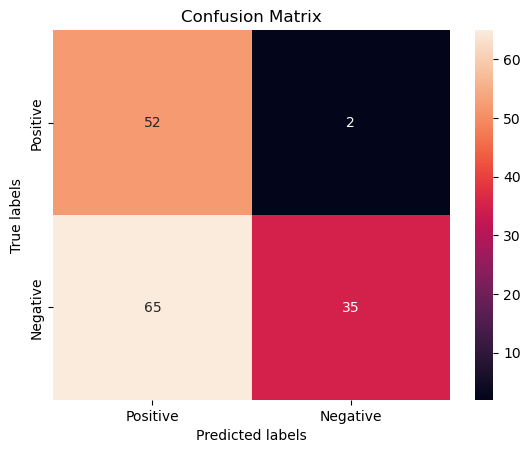

In [20]:
overall_best_weights = df['Best Weights'][0]
test_acc = predict(X_test,y_test,overall_best_weights)
print("Testing accuracy:",test_acc)
accuracy_scores(X_test,y_test,overall_best_weights)

In [21]:
df['Best Weights'][0]

array([-0.05242974, -0.29618968,  0.07610526, -0.00606571,  0.0949465 ,
       -0.16860126, -0.030229  ,  0.00334729])

In [22]:
# # print("1st accuracy" ,predict(diabetes_features,weights))
# l_rate = 0.001
# np.random.seed(89)
# b_weights = np.random.rand(9)
# import matplotlib.pyplot as plt 
# best_weights = 0
# best_accu = 0
# val_loss_list = []
# train_loss_list = []
# val_acc_list = []
# train_acc_list = []
# for i in range(20):
#     b_weights = update_weights(b_weights,b_X_train,b_y_train,"zero_one",l_rate)
# #     train_loss = zero_one_loss(X_train,y_train,weights)
# #     val_loss = zero_one_loss(X_Val,y_Val,weights)
    
#     # perceptron_loss
#     train_loss = perceptron_loss(b_X_train,b_y_train,b_weights)
#     val_loss = perceptron_loss(b_X_Val,b_y_Val,b_weights)
    
#     val_loss_list.append(val_loss)
#     train_loss_list.append(train_loss)
# #     print("Iteration ",i)
# #     print("Training accuracy:",train_acc," Validation accuracy:",val_acc,"Validation Loss:",val_loss,"Training Loss ",train_loss)
#     if val_acc>best_accu:
#         best_accu = val_acc
#         best_weights = weights
        
# # #Plotting Loss Curve
# # plt.figure(figsize=(5, 4))
# # plt.title("Plotting Training vs Validation Loss")
# # plt.plot(np.arange(20), val_loss_list, label = "Validation Loss")
# # plt.plot(np.arange(20), train_loss_list, label = "Training Loss")
# # plt.legend()
# # plt.show()

# # #Plotting Validation Curve
# # plt.figure(figsize=(5, 4))
# # plt.title("Plotting Training vs Validation Accuracy")
# # plt.plot(np.arange(20), val_acc_list, label = "Validation Accuracy")
# # plt.plot(np.arange(20), train_acc_list, label = "Training Accuracy")
# # plt.legend()
# # plt.show()
# print("best accuracy: ",best_accu)
# print("best weights: " ,best_weights)

## ---------------------------------------------------------------------------
# test_acc = predict(X_test,y_test,best_weights)
# # print("Iteration ",i)
# print("Testing accuracy:",test_acc)
## ---------------------------------------------------------------------------
# np.arange(20)

In [23]:
# !jt -t grade3 -T -N -kl

In [24]:
import numpy as np
np.arange(10,101,10)

array([ 10,  20,  30,  40,  50,  60,  70,  80,  90, 100])